In [1]:
#!pip install open3d pyproj

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 447.7/447.7 MB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.9/7.9 MB 44.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.8/139.8 kB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 43.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 55.4 MB/s eta 0:00:00
  Attempting uninstall: widgetsnbextension
    Found existing installation: widgetsnbextension 3.6.10
    Uninstalling widgetsnbextension-3.6.10:
      Successfully uninstalled widgetsnbextension-3.6.10
  Attempting uninstall: ipywidgets
    Found existing installation: ipywidgets 7.7.1
    Uninstalling ipywidgets-7.7.1:
      Successfully uninstalled ipywidgets-7.7.1


# Helper functions

In [9]:
import numpy as np
import open3d as o3d  # For 3D point cloud visualizations
from pyproj import Transformer  # To convert between coordinate systems
import pandas as pd
from scipy.spatial import ConvexHull, distance  # For geometry and distances
from matplotlib.path import Path  # For 2D polygonal paths
import matplotlib.pyplot as plt
import matplotlib.cm as cm  # Color maps
import matplotlib.colors as mcolors
from matplotlib import rcParams  # For customizing plot aesthetics
from mpl_toolkits.mplot3d import Axes3D  # 3D plotting support
from scipy.interpolate import griddata  # Interpolating scattered data onto a grid
from tqdm import tqdm  # Nice progress bars
import random
import time  # Timing stuff to see how long operations take

# Import Plotly for interactive 3D plots
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# make plots look a bit more "publication style"
rcParams.update({
    'font.family': 'serif',
    'font.size': 12,
    'axes.titlesize': 14,
    'axes.labelsize': 12
})

# --- Helper Functions (Necessary for the algorithms to run) ---

def wgs_to_utm(df, lat_col='latitude', lon_col='longitude', alt_col='lidar(m)'):
    """
    Converts GPS coordinates (WGS84) to UTM coordinates.
    Returns Nx3 array [x, y, altitude] in meters.
    """
    transformer = Transformer.from_crs("epsg:4326", "epsg:32633", always_xy=True)
    lon, lat, alt = df[lon_col].values, df[lat_col].values, df[alt_col].values
    x, y = transformer.transform(lon, lat)
    return np.stack([x, y, alt], axis=1).astype(np.float32)  # Stack into Nx3 array

def extract_detector_positions(df):
    """
    Extract detector positions from dataframe in UTM coordinates.
    """
    return wgs_to_utm(df, lat_col='latitude', lon_col='longitude', alt_col='height_wgs84(m)')

def create_reconstruction_grid_extent(min_x, max_x, min_y, max_y, voxel_size=0.25):
    """
    Creates the X/Y coordinates for the reconstruction grid, with a half-voxel offset.
    Returns grid vectors and bounds for plotting or reference.
    """
    grid_x = np.arange(min_x + voxel_size/2, max_x + voxel_size/2, voxel_size)
    grid_y = np.arange(min_y + voxel_size/2, max_y + voxel_size/2, voxel_size)
    bounds_dict = {"x": (min_x, max_x), "y": (min_y, max_y)}
    return grid_x, grid_y, bounds_dict

def _kaczmarz_base(detectors, grid_points, b, isotope):
    """
    Base setup for Kaczmarz algorithms:
    - Initializes the solution vector x (all zeros)
    - Returns number of measurements (m) and number of unknowns (n)
    - Returns isotope-specific emission probability and attenuation factor
    """
    m, n = detectors.shape[0], grid_points.shape[0]
    x = np.zeros(n, dtype=np.float32)

    # Define isotope-specific parameters
    if isotope.lower() == "cs":
        emission_prob = 0.851
        mu_over_rho = 0.07925
    elif isotope.lower() == "co":
        emission_prob = 0.999
        mu_over_rho = 0.05270
    else:
        raise ValueError("Invalid isotope. Use 'cs' or 'co'.")

    rho_air = 0.001225  # Air density in g/cm^3
    mu_L = mu_over_rho * rho_air * 100  # Linear attenuation in 1/m
    return x, m, n, emission_prob, mu_L

def _get_A_matrix(detectors, grid_points, emission_prob, mu_L):
    """
    Precomputes the system matrix A:
    A[i, j] represents the expected contribution from voxel j to detector i.
    This is the most expensive part, but we only compute it once.
    """
    print("\nPre-computing A matrix...")
    start_time = time.time()

    # Compute distance between every detector and every grid point
    dists = np.linalg.norm(detectors[:, None, :] - grid_points[None, :, :], axis=2) + 1e-6  # tiny epsilon to avoid divide by zero

    # Apply exponential attenuation based on distance
    atten = np.exp(-mu_L * dists)

    # Standard inverse-square law contribution
    A_matrix = emission_prob / (4 * np.pi * dists**2) * atten

    end_time = time.time()
    print(f"A matrix pre-computation completed in {end_time - start_time:.2f} seconds. Shape: {A_matrix.shape}")
    return A_matrix

def calculate_system_residual(x_recon, b, A_matrix):
    """
    Compute the L2 residual of the system: ||b - Ax||_2
    Basically tells us how well our current guess x fits the measurements b.
    """
    predicted_b = A_matrix @ x_recon  # Compute expected measurements from current x
    full_residual = b - predicted_b
    return np.linalg.norm(full_residual)  # Return scalar L2 norm


# Kaczmarz definitions

In [11]:
# Modified to return residuals_per_iteration
def kaczmarz_cyclic_nn(detectors, grid_points, b, A_matrix, n_iter=100, isotope_str="cs"):
    # Start with a base setup (x is our unknowns vector, m=number of measurements, n=number of voxels)
    x, m, n, _, _ = _kaczmarz_base(detectors, grid_points, b, isotope=isotope_str)

    residuals_per_iteration = []  # We'll store the residual after each full iteration

    # Main loop for number of iterations we want to run
    for it in tqdm(range(n_iter), desc=f"Cyclic Kaczmarz NN ({isotope_str.upper()}) Iterations"):
        for i in range(m):  # Go through each detector one by one
            A_i = A_matrix[i, :]  # Grab the i-th row of A
            A_i_norm_sq = np.sum(A_i**2)  # Compute squared norm for scaling
            if A_i_norm_sq == 0: continue  # Skip rows with all zeros
            residual = b[i] - A_i @ x  # How far off we are for this row
            x += (residual / A_i_norm_sq) * A_i  # Update x in Kaczmarz style
            x = np.maximum(0, x)  # Enforce non-negativity
        residuals_per_iteration.append(calculate_system_residual(x, b, A_matrix))  # Track residuals
    return x, np.array(residuals_per_iteration)  # Return final solution + residual history


# Modified to return residuals_per_iteration
def kaczmarz_upsweep_nn(detectors, grid_points, b, A_matrix, n_iter=100, isotope_str="cs"):
    # Same starting point as cyclic
    x, m, n, _, _ = _kaczmarz_base(detectors, grid_points, b, isotope=isotope_str)
    residuals_per_iteration = []

    for it in tqdm(range(n_iter), desc=f"Upsweep Kaczmarz NN ({isotope_str.upper()}) Iterations"):
        # Forward sweep: go top to bottom
        for i in range(m):
            A_i = A_matrix[i, :]
            A_i_norm_sq = np.sum(A_i**2)
            if A_i_norm_sq == 0: continue
            residual = b[i] - A_i @ x
            x += (residual / A_i_norm_sq) * A_i
            x = np.maximum(0, x)
        # Backward sweep: go bottom to top
        for i in range(m - 1, -1, -1):
            A_i = A_matrix[i, :]
            A_i_norm_sq = np.sum(A_i**2)
            if A_i_norm_sq == 0: continue
            residual = b[i] - A_i @ x
            x += (residual / A_i_norm_sq) * A_i
            x = np.maximum(0, x)
        residuals_per_iteration.append(calculate_system_residual(x, b, A_matrix))
    return x, np.array(residuals_per_iteration)


# Modified to return residuals_per_iteration
def kaczmarz_randomized_nn(detectors, grid_points, b, A_matrix, n_iter=100, isotope_str="cs"):
    # Setup starting guess
    x, m, n, _, _ = _kaczmarz_base(detectors, grid_points, b, isotope=isotope_str)
    detector_indices = list(range(m))  # List of row indices for random selection
    residuals_per_iteration = []

    for it in tqdm(range(n_iter), desc=f"Randomized Kaczmarz NN ({isotope_str.upper()}) Iterations"):
        for _ in range(m):  # Full pass = m updates
            i = random.choice(detector_indices)  # Pick a random row
            A_i = A_matrix[i, :]
            A_i_norm_sq = np.sum(A_i**2)
            if A_i_norm_sq == 0: continue
            residual = b[i] - A_i @ x
            x += (residual / A_i_norm_sq) * A_i
            x = np.maximum(0, x)
        residuals_per_iteration.append(calculate_system_residual(x, b, A_matrix))
    return x, np.array(residuals_per_iteration)


# Modified to return residuals_per_iteration
def kaczmarz_relaxation(detectors, grid_points, b, A_matrix, relx, n_iter=100, isotope_str="cs"):
    # Base setup again
    x, m, n, _, _ = _kaczmarz_base(detectors, grid_points, b, isotope=isotope_str)
    residuals_per_iteration = []

    for it in tqdm(range(n_iter), desc=f"Kaczmarz Relaxation (relx={relx:.2f}, {isotope_str.upper()}) Iterations"):
        for i in range(m):
            A_i = A_matrix[i, :]
            A_i_norm_sq = np.sum(A_i**2)
            if A_i_norm_sq == 0: continue
            residual = b[i] - A_i @ x
            x += relx * (residual / A_i_norm_sq) * A_i  # Multiply by relaxation factor
            x = np.maximum(0, x)  # Keep everything non-negative
        residuals_per_iteration.append(calculate_system_residual(x, b, A_matrix))
    return x, np.array(residuals_per_iteration)


def kaczmarz_downsweep(A, b, x, omega=1.0):
    """
    One down-sweep Kaczmarz iteration.
    """
    m, n = A.shape
    for i in range(m):
        Ai = A[i]
        Ai_norm_sq = np.linalg.norm(Ai)**2
        if Ai_norm_sq == 0:  # Skip zero rows
            continue
        residual = b[i] - Ai @ x
        x = x + (omega * residual / Ai_norm_sq) * Ai
        x = np.maximum(0, x)  # Non-negativity
    return x


def kaczmarz_upsweep(A, b, x, omega=1.0):
    """
    One up-sweep Kaczmarz iteration.
    """
    m, n = A.shape
    for i in reversed(range(m)):  # Start from bottom row
        Ai = A[i]
        Ai_norm_sq = np.linalg.norm(Ai)**2
        if Ai_norm_sq == 0:
            continue
        residual = b[i] - Ai @ x
        x = x + (omega * residual / Ai_norm_sq) * Ai
        x = np.maximum(0, x)
    return x


def twin_error_gauge_kaczmarz(A, b, omega=1.0, max_iters=1000, slack=5):
    """
    Twin Kaczmarz Algorithm using Error Gauge as stopping rule.
    Basically runs a down-sweep and an up-sweep in parallel and stops when they are close.
    """
    m, n = A.shape
    x_down = np.zeros(n)
    x_up = np.zeros(n)
    best_x_down = None
    best_x_up = None
    min_gauge = np.inf
    slack_counter = slack

    gauge_history = []

    for k in tqdm(range(max_iters), desc="TEG Kaczmarz Sweeps"):
        x_down = kaczmarz_downsweep(A, b, x_down, omega)  # Do a down sweep
        x_up = kaczmarz_upsweep(A, b, x_up, omega)        # Do an up sweep

        gauge = np.linalg.norm(x_down - x_up)  # How different are they?
        gauge_history.append(gauge)

        if gauge < min_gauge:
            min_gauge = gauge
            best_x_down = x_down.copy()
            best_x_up = x_up.copy()
            slack_counter = slack  # Reset counter if improving
        else:
            slack_counter -= 1  # Count down if no improvement

        if slack_counter == 0:  # Stop if stuck
            print(f"Stopping at iteration {k+1} with minimal gauge {min_gauge:.4e}")
            break

    x_final = 0.5 * (best_x_down + best_x_up)  # Average the two best solutions
    return x_final, gauge_history, min_gauge


def kaczmarz_downsweep_early_stop(A, b, omega=1.0, max_iters=1000, slack=50, tolerance=0.5):
    """
    Performs Kaczmarz down-sweeps with an early stopping rule.
    Stops if residual improvement is too small for a certain number of iterations.
    """
    m, n = A.shape
    x = np.zeros(n)
    best_x = np.zeros(n)
    min_residual = float('inf')
    slack_counter = slack

    residual_history = []

    for k in tqdm(range(max_iters), desc="Kaczmarz Downsweep with Early Stop"):
        # Single down-sweep
        for i in range(m):
            Ai = A[i]
            Ai_norm_sq = np.sum(Ai**2)
            if Ai_norm_sq == 0:
                continue
            residual = b[i] - Ai @ x
            x = x + (omega * residual / Ai_norm_sq) * Ai
            x = np.maximum(0, x)  # Keep non-negative

        # Calculate full system residual after each sweep
        current_residual = calculate_system_residual(x, b, A)
        residual_history.append(current_residual)

        # Check for a significant improvement
        if (min_residual - current_residual) > tolerance:
            min_residual = current_residual
            best_x = x.copy()
            slack_counter = slack  # Reset slack counter on improvement
        else:
            slack_counter -= 1     # Decrement if change is too small

        # Early stopping condition
        if slack_counter <= 0:
            print(f"Stopping early at iteration {k+1} due to minimal change in residual.")
            break

    return best_x, min_residual, residual_history


# Plotting helpers

In [12]:
# --- Plotting Functions (for visualization) ---

def plot_2d_reconstruction_on_terrain_map(x_recon, xx_mesh, yy_mesh, Z_terrain,
                                        grid_points_for_reconstruction, title="2D Reconstruction on Terrain",
                                        threshold_percentage=0.0):
    print(f"\nCreating 2D terrain map with reconstruction overlay for {title} (Threshold: {threshold_percentage:.1f}%) ...")
    x_recon_clamped_for_plot = np.maximum(0, x_recon.copy())
    fig, ax = plt.subplots(figsize=(6, 6))
    contour_levels = 50
    terrain_contour = ax.contourf(xx_mesh, yy_mesh, Z_terrain, levels=contour_levels, cmap='terrain', alpha=0.8)
    #fig.colorbar(terrain_contour, ax=ax, label="Elevation (m)", pad=0.05)
    if np.max(x_recon_clamped_for_plot) == np.min(x_recon_clamped_for_plot):
        scatter_colors = np.zeros_like(x_recon_clamped_for_plot)
    else:
        norm = mcolors.Normalize(vmin=np.min(x_recon_clamped_for_plot), vmax=np.max(x_recon_clamped_for_plot))
        scatter_colors = norm(x_recon_clamped_for_plot)
    scatter_x = grid_points_for_reconstruction[:, 0]
    scatter_y = grid_points_for_reconstruction[:, 1]
    scatter_plot = ax.scatter(scatter_x, scatter_y, c=x_recon_clamped_for_plot, cmap='hot', s=15, alpha=0.7, edgecolors='none')
    fig.colorbar(scatter_plot, ax=ax, label="Reconstructed Activity", pad=0.15)
    ax.set_xlabel("UTM Easting (m)")
    ax.set_ylabel("UTM Northing (m)")
    ax.set_title(title)
    ax.set_aspect('equal', adjustable='box')
    plt.tight_layout()
    plt.show()

def plot_3d_plotly_reconstruction(x_recon, xx_mesh, yy_mesh, Z_terrain,
                                  grid_points_for_reconstruction, title="3D Plotly Reconstruction"):
    print(f"\nCreating Plotly 3D interactive plot for {title}...")
    x_recon_clamped_for_plot = np.maximum(0, x_recon.copy())
    surface_trace = go.Surface(x=xx_mesh, y=yy_mesh, z=Z_terrain, colorscale='plasma', showscale=False, name='plasma', opacity=0.8)
    scatter_trace = go.Scatter3d(
        x=grid_points_for_reconstruction[:, 0],
        y=grid_points_for_reconstruction[:, 1],
        z=grid_points_for_reconstruction[:, 2],
        mode='markers',
        marker=dict(size=3, color=x_recon_clamped_for_plot, colorscale='Jet', colorbar=dict(title='Activity'), showscale=True, opacity=1.0),
        name='Reconstruction Activity'
    )
    fig = go.Figure(data=[surface_trace, scatter_trace])
    fig.update_layout(
        title=title,
        scene=dict(xaxis_title='Easting (m)', yaxis_title='Northing (m)', zaxis_title='Elevation (m)', aspectmode='data')
    )
    fig.show()

def plot_residuals_over_iterations(residual_data_dict, n_iter, title="Residuals Over Iterations"):
    """
    Plots the L2 norm of the residuals for different algorithms over iterations.

    Args:
        residual_data_dict (dict): A dictionary where keys are algorithm names (str)
                                   and values are arrays/lists of residual norms per iteration.
        n_iter (int): The total number of iterations.
        title (str): Title for the plot.
    """
    print(f"\nPlotting {title}...")
    plt.figure(figsize=(10, 6))
    iterations = np.arange(1, n_iter + 1)

    for algo_name, residuals in residual_data_dict.items():
        if residuals.size > 0: # Ensure there's data to plot
            plt.plot(iterations, residuals, label=algo_name, marker='o', markersize=4, linestyle='-')
        else:
            print(f"Warning: No residual data for {algo_name}. Skipping plot for this algorithm.")


    plt.xlabel("Iteration Number")
    plt.ylabel("Residual Norm $||b - Ax||_2$ (Log Scale)")
    plt.title(title)
    plt.yscale('log') # Use log scale for residuals
    plt.legend()
    plt.grid(True, which="both", ls="-", alpha=0.7)
    plt.tight_layout()
    plt.show()

def plot_reconstruction_and_gauge(x_recon, gauge_history, xx_mesh, yy_mesh, Z_terrain,
                                  grid_points, detectors, b_values, title, min_gauge):

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))
    fig.suptitle(title, fontsize=16)

    # --- Left Subplot: Reconstruction Map ---
    ax1.contourf(xx_mesh, yy_mesh, Z_terrain, levels=50, cmap='terrain', alpha=0.8)

    x_recon_clamped = np.maximum(0, x_recon)
    scatter_x = grid_points[:, 0]
    scatter_y = grid_points[:, 1]
    reconstruction_plot = ax1.scatter(scatter_x, scatter_y, c=x_recon_clamped,
                                      cmap='hot', s=15, alpha=0.7, edgecolors='none')
    fig.colorbar(reconstruction_plot, ax=ax1, label="Reconstructed Activity")

    ax1.set_title("Final Reconstruction")
    ax1.set_xlabel("UTM Easting (m)")
    ax1.set_ylabel("UTM Northing (m)")
    ax1.set_aspect('equal', adjustable='box')

    # --- Right Subplot: Twin Error Gauge History ---
    ax2.plot(gauge_history, label="Twin Error Gauge Norm")
    ax2.set_title(f"Gauge History (Min: {min_gauge:.4e})")
    ax2.set_xlabel("Number of Sweeps")
    ax2.set_ylabel("Gauge Norm")
    ax2.set_yscale('log') # Log scale is often useful for visualizing convergence
    ax2.grid(True)
    ax2.legend()

    plt.tight_layout()
    plt.show()


# --- Plotting Function (Modified for Residual History) ---
def plot_reconstruction_and_history(x_recon, history, xx_mesh, yy_mesh, Z_terrain,
                                    grid_points, detectors, b_values, title, min_value):

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))
    fig.suptitle(title, fontsize=16)

    # --- Left Subplot: Reconstruction Map ---
    ax1.contourf(xx_mesh, yy_mesh, Z_terrain, levels=50, cmap='terrain', alpha=0.8)
    x_recon_clamped = np.maximum(0, x_recon)
    scatter_x = grid_points[:, 0]
    scatter_y = grid_points[:, 1]
    reconstruction_plot = ax1.scatter(scatter_x, scatter_y, c=x_recon_clamped,
                                      cmap='hot', s=15, alpha=0.7, edgecolors='none')
    fig.colorbar(reconstruction_plot, ax=ax1, label="Reconstructed Activity")
    ax1.set_title("Final Reconstruction")
    ax1.set_xlabel("UTM Easting (m)")
    ax1.set_ylabel("UTM Northing (m)")
    ax1.set_aspect('equal', adjustable='box')

    # --- Right Subplot: Residual History ---
    ax2.plot(history, label="System Residual Norm")
    ax2.set_title(f"Residual History (Min: {min_value:.4e})")
    ax2.set_xlabel("Number of Sweeps")
    ax2.set_ylabel("Residual Norm (log scale)")
    ax2.set_yscale('log')
    ax2.grid(True)
    ax2.legend()

    plt.tight_layout()
    plt.show()

# --- Plotting the drone path and intensity beside the reconstruction intensity ---
def plot_reconstruction_and_measurements_side_by_side(x_recon, xx_mesh, yy_mesh, Z_terrain,
                                                     grid_points_for_reconstruction, detectors,
                                                     b_values, algo_name, isotope_str,
                                                     threshold_percentage=0.0):
    print(f"\nCreating side-by-side plot for {algo_name} ({isotope_str}) ...")

    # Create the figure with two subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8), sharex=True, sharey=True)
    fig.suptitle(f"{algo_name} Reconstruction for {isotope_str.upper()}", fontsize=16)

    # --- Left Subplot: Reconstruction Map ---
    # Plot the terrain elevation as a background
    contour_levels = 50
    ax1.contourf(xx_mesh, yy_mesh, Z_terrain, levels=contour_levels, cmap='terrain', alpha=0.8)

    # Plot the reconstructed activity
    x_recon_clamped_for_plot = np.maximum(0, x_recon.copy())
    if threshold_percentage > 0:
        max_intensity = np.max(x_recon_clamped_for_plot)
        if max_intensity > 0:
            threshold_val = (threshold_percentage / 100.0) * max_intensity
            x_recon_clamped_for_plot[x_recon_clamped_for_plot < threshold_val] = 0

    scatter_x = grid_points_for_reconstruction[:, 0]
    scatter_y = grid_points_for_reconstruction[:, 1]
    reconstruction_plot = ax1.scatter(scatter_x, scatter_y, c=x_recon_clamped_for_plot,
                                      cmap='hot', s=15, alpha=0.7, edgecolors='none')
    fig.colorbar(reconstruction_plot, ax=ax1, label="Reconstructed Activity", pad=0.05)

    ax1.set_title("Reconstruction Map")
    ax1.set_xlabel("UTM Easting (m)")
    ax1.set_ylabel("UTM Northing (m)")
    ax1.set_aspect('equal', adjustable='box')

    # --- Right Subplot: Drone Measurements ---
    # Plot the terrain elevation as a background
    #ax2.contourf(xx_mesh, yy_mesh, Z_terrain, levels=contour_levels, cmap='terrain', alpha=0.8)

    # Plot the drone flight path
    ax2.plot(detectors[:, 0], detectors[:, 1], color='black', linestyle='--', linewidth=1, zorder=2, label='Drone Path')

    # Plot the "true hotspot" measurements from the drone
    scatter_drone = ax2.scatter(detectors[:, 0], detectors[:, 1],
                                c=b_values, cmap='hot', s=50, alpha=0.8,
                                edgecolors='black', linewidth=0.5, zorder=3)

    # Add a colorbar for the drone measurements
    fig.colorbar(scatter_drone, ax=ax2, label="Drone Measurement Intensity (counts)", pad=0.05)

    # Add arrow to indicate start of path
    if len(detectors) > 1:
        ax2.arrow(detectors[0, 0], detectors[0, 1],
                  detectors[1, 0] - detectors[0, 0], detectors[1, 1] - detectors[0, 1],
                  head_width=5, head_length=5, fc='black', ec='black', zorder=4)

    ax2.set_title(f"Drone Measurement Map (Raw {isotope_str.upper()} Data)")
    ax2.set_xlabel("UTM Easting (m)")
    ax2.set_aspect('equal', adjustable='box')
    ax2.legend()

    plt.tight_layout()
    plt.show()


def plot_reconstruction_and_measurements_side_by_side2(x_recon, xx_mesh, yy_mesh, Z_terrain,
                                                     grid_points_for_reconstruction, detectors,
                                                     b_values, algo_name, isotope_str,
                                                     threshold_percentage=0.0):
    print(f"\nCreating side-by-side plot for {algo_name} ({isotope_str}) ...")

    # Create the figure with two subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8), sharex=True, sharey=True)
    fig.suptitle(f"{algo_name} Reconstruction for {isotope_str.upper()}", fontsize=16)

    # --- Left Subplot: Reconstruction Map ---
    # Plot the terrain elevation as a background
    contour_levels = 50
    ax1.contourf(xx_mesh, yy_mesh, Z_terrain, levels=contour_levels, cmap='terrain', alpha=0.8)

    scatter_x = grid_points_for_reconstruction[:, 0]
    scatter_y = grid_points_for_reconstruction[:, 1]
    reconstruction_plot = ax1.scatter(scatter_x, scatter_y, c=x_recon,
                                     cmap='hot', s=50, alpha=0.7, edgecolors='none')
    fig.colorbar(reconstruction_plot, ax=ax1, label="Reconstructed Activity", pad=0.05)

    # Find and plot the highest reconstruction point
    max_recon_idx = np.argmax(x_recon)
    max_recon_loc = grid_points_for_reconstruction[max_recon_idx]
    ax1.scatter(max_recon_loc[0], max_recon_loc[1], s=50, marker='o', c='yellow', edgecolors='black', zorder=5)
    ax1.annotate(f"Peak\n({max_recon_loc[0]:.0f}, {max_recon_loc[1]:.0f})",
                 (max_recon_loc[0], max_recon_loc[1]),
                 textcoords="offset points", xytext=(-20,-20), ha='center', fontsize=8,
                 bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="black", lw=0.5, alpha=0.7))

    ax1.set_title("Reconstruction Map")
    ax1.set_xlabel("UTM Easting (m)")
    ax1.set_ylabel("UTM Northing (m)")
    ax1.set_aspect('equal', adjustable='box')

    # --- Right Subplot: Drone Measurements ---
    # Plot the terrain elevation as a background
    #ax2.contourf(xx_mesh, yy_mesh, Z_terrain, levels=contour_levels, cmap='terrain', alpha=0.8)

    # Plot the drone flight path
    ax2.plot(detectors[:, 0], detectors[:, 1], color='black', linestyle='--', linewidth=1, zorder=2, label='Drone Path')

    # Plot the "true hotspot" measurements from the drone
    scatter_drone = ax2.scatter(detectors[:, 0], detectors[:, 1],
                               c=b_values, cmap='inferno', s=50, alpha=0.8,
                               edgecolors='black', linewidth=0.5, zorder=3)

    # Find and plot the highest drone measurement point
    max_b_idx = np.argmax(b_values)
    max_b_loc = detectors[max_b_idx]
    ax2.scatter(max_b_loc[0], max_b_loc[1], s=50, marker='o', c='yellow', edgecolors='black', zorder=5)
    ax2.annotate(f"Peak\n({max_b_loc[0]:.0f}, {max_b_loc[1]:.0f})",
                 (max_b_loc[0], max_b_loc[1]),
                 textcoords="offset points", xytext=(0,10), ha='center', fontsize=8,
                 bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="black", lw=0.5, alpha=0.7))

    # Add a colorbar for the drone measurements
    fig.colorbar(scatter_drone, ax=ax2, label="Drone Measurement Intensity (counts)", pad=0.05)

    # Add arrow to indicate start of path
    if len(detectors) > 1:
        ax2.arrow(detectors[0, 0], detectors[0, 1],
                  detectors[1, 0] - detectors[0, 0], detectors[1, 1] - detectors[0, 1],
                  head_width=5, head_length=5, fc='black', ec='black', zorder=4)

    ax2.set_title(f"Drone Measurement Map (Raw {isotope_str.upper()} Data)")
    ax2.set_xlabel("UTM Easting (m)")
    ax2.set_aspect('equal', adjustable='box')
    ax2.legend()

    plt.tight_layout()
    plt.show()

    # --- Print the comparison ---
    print("\n--- Peak Location Comparison ---")
    print(f"Reconstructed Peak Location (UTM): ({max_recon_loc[0]:.2f}, {max_recon_loc[1]:.2f})")
    print(f"Measured Peak Location (UTM): ({max_b_loc[0]:.2f}, {max_b_loc[1]:.2f})")
    distance = np.linalg.norm(max_recon_loc[:2] - max_b_loc[:2])
    print(f"Distance between peaks: {distance:.2f} meters")



# Base initialisation

In [13]:
# --- Main Execution Block ---

print("--- Initializing Data and Grid ---")

# Load data
cloud = o3d.io.read_point_cloud("converted_coloured.ply")   # The 3d representation of the mapped area
original_terrain_points = np.asarray(cloud.points)          # Saving the points that make up the point cloud
df_brno = pd.read_csv("brno_processed_data_15mAGL(in).csv") # The done data
detectors = extract_detector_positions(df_brno)             # Separating out just the Latitude, Longitude and Altitude from the data.

# --- Cesium (Cs) Data ---
b_cs = df_brno['cs_photo'].values.astype(np.float32)        # The photon counts for Cesium-137

# --- Cobalt (Co) Data ---
b_co = df_brno['co_photo'].values.astype(np.float32)        # The photon counts for Cobalt-60


# --- Define the Reconstruction Grid ---

# Add some padding around detector coverage so the grid is not cut off abruptly
buffer_distance = 50.0

# Detector bounding box (x and y ranges)
det_min_x, det_max_x = detectors[:, 0].min(), detectors[:, 0].max()
det_min_y, det_max_y = detectors[:, 1].min(), detectors[:, 1].max()

# Expand the detector bounds by the buffer distance
grid_min_x, grid_max_x = det_min_x - buffer_distance, det_max_x + buffer_distance
grid_min_y, grid_max_y = det_min_y - buffer_distance, det_max_y + buffer_distance

# Build the reconstruction grid (x, y, z points to solve for source strength)
# voxel_size=2.0 → spacing between grid points = 2 meters
grid_x, grid_y, _ = create_reconstruction_grid_extent(grid_min_x, grid_max_x, grid_min_y, grid_max_y, voxel_size=2.0)

# Create a meshgrid for the terrain surface (xx, yy grids)
xx_mesh, yy_mesh = np.meshgrid(grid_x, grid_y, indexing='ij')

# Interpolate terrain height (Z) at every grid (x,y) location
# so we can place grid points exactly "on the ground surface"
Z_terrain_interpolated = griddata(
    original_terrain_points[:, :2],   # terrain (x,y)
    original_terrain_points[:, 2],    # terrain height (z)
    (xx_mesh, yy_mesh), method='nearest')

# Final 3D grid points for reconstruction (flattened)
grid_points_for_reconstruction = np.stack([xx_mesh.ravel(), yy_mesh.ravel(), Z_terrain_interpolated.ravel()], axis=1).astype(np.float32)

# Pre-compute A matrices for both Cs and Co
# For Cs-137
# _kaczmarz_base() returns isotope-specific constants like emission probability & attenuation
_, _, _, emission_prob_cs, mu_L_cs = _kaczmarz_base(detectors, grid_points_for_reconstruction, b_cs, isotope="cs")
# Build A matrix = system model linking sources → detector counts
A_matrix_cs = _get_A_matrix(detectors, grid_points_for_reconstruction, emission_prob_cs, mu_L_cs)


# For Co-60
_, _, _, emission_prob_co, mu_L_co = _kaczmarz_base(detectors, grid_points_for_reconstruction, b_co, isotope="co")

A_matrix_co = _get_A_matrix(detectors, grid_points_for_reconstruction, emission_prob_co, mu_L_co)


# --- Iteration Settings ---

# Number of sweeps through the detectors (for Kaczmarz and variants)
# More iterations = better convergence but higher runtime
kaczmarz_n_iter = 100

--- Initializing Data and Grid ---

Pre-computing A matrix...
A matrix pre-computation completed in 7.00 seconds. Shape: (1813, 63412)

Pre-computing A matrix...
A matrix pre-computation completed in 6.58 seconds. Shape: (1813, 63412)


# Main

## Basic Kaczmarz algorithms - Downsweep, Symmetric, Randomized

Randomized Kaczmarz NN (Norm-Prob): 100%|██████████| 400/400 [02:38<00:00,  2.52it/s]



Creating side-by-side plot for Randomized NN (cs) ...


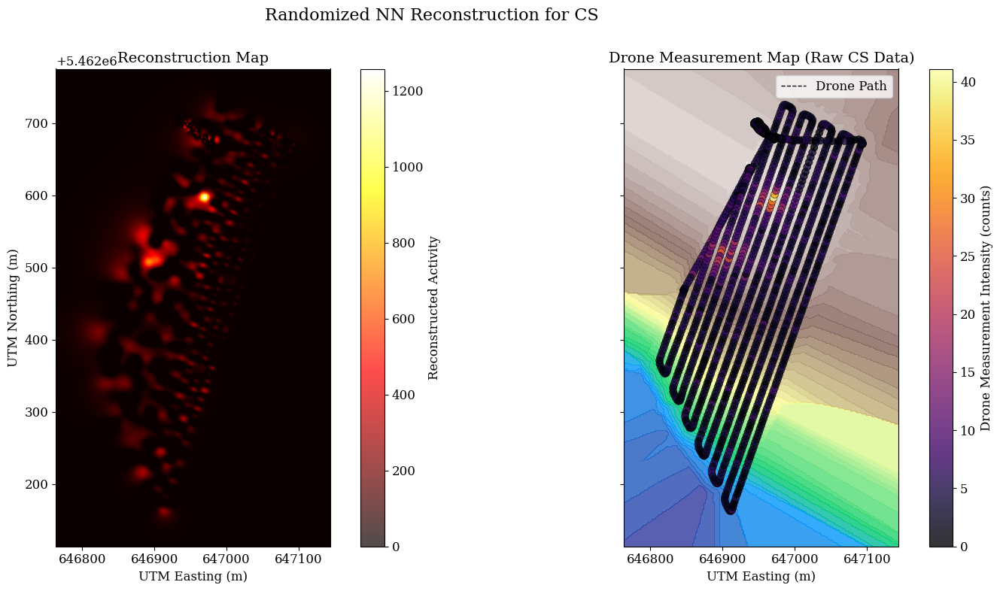

In [ ]:
def kaczmarz_randomized(detectors, grid_points, b, A_matrix, n_iter=400, isotope_str="cs"):
    x, m, n, _, _ = _kaczmarz_base(detectors, grid_points, b, isotope=isotope_str)
    #detector_indices = list(range(m))
    residuals_per_iteration = []
   # Calculate probabilities based on squared row norms
    row_norms_sq = np.sum(A_matrix**2, axis=1)

    # Normalize to get probabilities (sum to 1)
    if np.sum(row_norms_sq) == 0:
        p = np.ones(m) / m
    else:
        p = row_norms_sq / np.sum(row_norms_sq)

    detector_indices = np.arange(m)

    for _ in tqdm(range(n_iter), desc=f"Randomized Kaczmarz NN (Norm-Prob)"):
        # The inner loop now performs a randomized selection of 'm' updates
        for _ in range(m):
            # Select a row index based on the pre-computed probabilities
            i = np.random.choice(detector_indices, replace = False, p=p)

            A_i = A_matrix[i, :]
            Ai_norm_sq = row_norms_sq[i] # Use the pre-computed norm

            if Ai_norm_sq == 0: continue

            residual = b[i] - A_i @ x
            x += 1 * (residual / Ai_norm_sq) * A_i.flatten()

            #x = np.maximum(0, x)
        residuals_per_iteration.append(calculate_system_residual(x, b, A_matrix))
    return x, np.array(residuals_per_iteration)

x_est, res = kaczmarz_randomized(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, n_iter=400, isotope_str="cs")
plot_reconstruction_and_measurements_side_by_side(
    x_est,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    "Randomized NN",
    "cs"
)

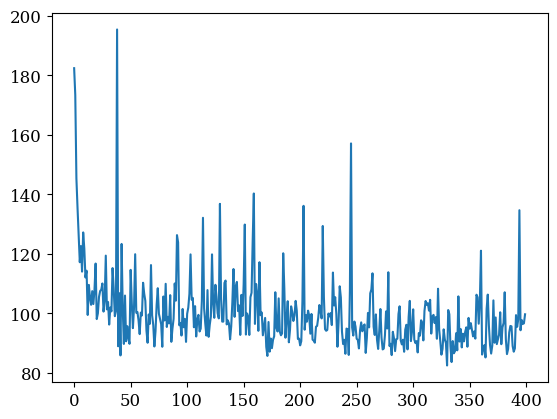

In [ ]:
plt.plot(res) # without replacement

Randomized Kaczmarz NN (Norm-Prob): 100%|██████████| 100/100 [00:56<00:00,  1.77it/s]



Creating side-by-side plot for Randomized NN (cs) ...


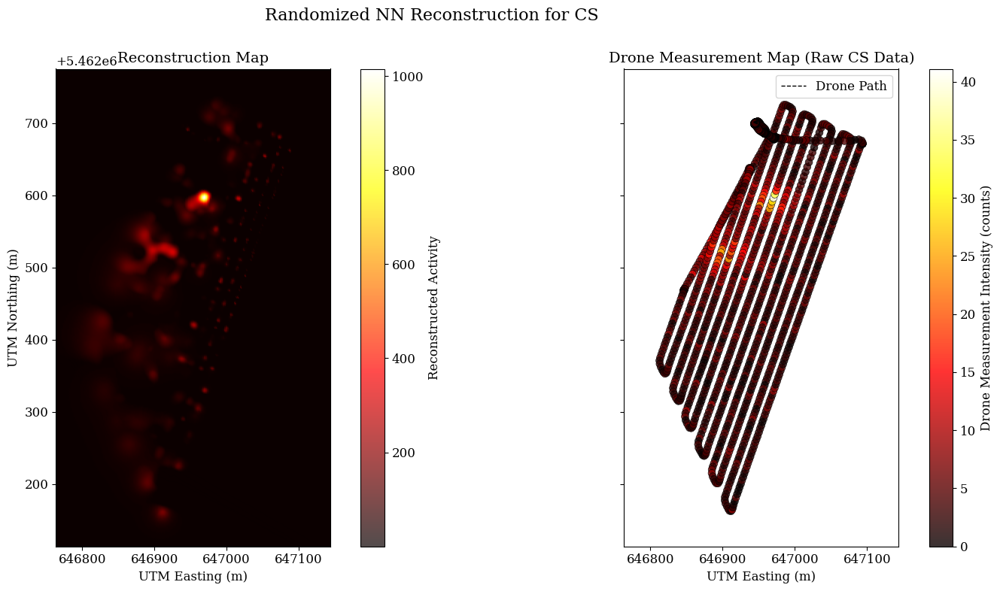

In [25]:
import numpy as np
from tqdm import tqdm

def kaczmarz_randomized(detectors, grid_points, b, A_matrix, n_iter=400, isotope_str="cs", with_replacement=True):
    x, m, n, _, _ = _kaczmarz_base(detectors, grid_points, b, isotope=isotope_str)
    residuals_per_iteration = []

    # Calculate probabilities based on squared row norms
    row_norms_sq = np.sum(A_matrix**2, axis=1)
    if np.sum(row_norms_sq) == 0:
        p = np.ones(m) / m
    else:
        p = row_norms_sq / np.sum(row_norms_sq)

    detector_indices = np.arange(m)

    for _ in tqdm(range(n_iter), desc=f"Randomized Kaczmarz NN (Norm-Prob)"):
        # Choose order of rows per iteration
        if with_replacement:
            # Each update: select one row based on probability, can repeat same row
            for _ in range(m):
                i = np.random.choice(detector_indices, replace=True, p=p)
                A_i = A_matrix[i, :]
                Ai_norm_sq = row_norms_sq[i]
                if Ai_norm_sq == 0:
                    continue
                residual = b[i] - A_i @ x
                x +=(residual / Ai_norm_sq) * A_i.flatten()
                x = np.maximum(0, x)
        else:
            # Without replacement: shuffle rows based on probabilities once per iteration
            shuffled_indices = detector_indices.copy()
            random.shuffle(shuffled_indices)  # <-- your requested change
            for i in shuffled_indices:
                A_i = A_matrix[i, :]
                Ai_norm_sq = row_norms_sq[i]
                if Ai_norm_sq == 0:
                    continue
                residual = b[i] - A_i @ x
                x += (residual / Ai_norm_sq) * A_i.flatten()
                x = np.maximum(0, x)
        residuals_per_iteration.append(calculate_system_residual(x, b, A_matrix))

    return x, np.array(residuals_per_iteration)

# Example usage:
x_est, res = kaczmarz_randomized(
    detectors,
    grid_points_for_reconstruction,
    b_cs,
    A_matrix_cs,
    n_iter=100,
    isotope_str="cs",
    with_replacement=True  # Change to False to test without replacement
)

plot_reconstruction_and_measurements_side_by_side(
    x_est,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    "Randomized NN",
    "cs"
)


Randomized Kaczmarz NN (Norm-Prob): 100%|██████████| 100/100 [01:01<00:00,  1.63it/s]



Creating side-by-side plot for Randomized NN (co) ...


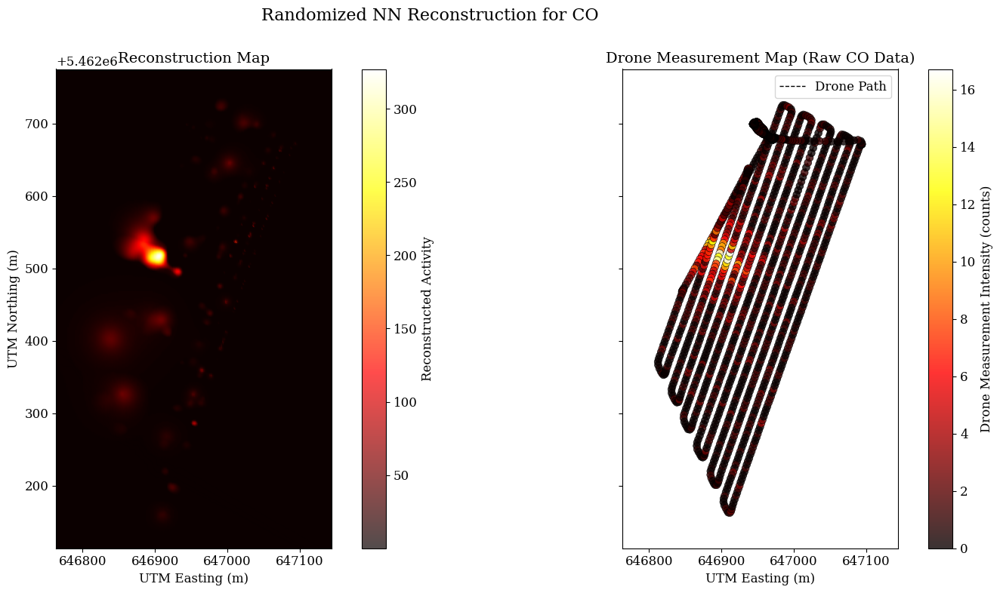

In [29]:
# Example usage:
x_est_co, res_co = kaczmarz_randomized(
    detectors,
    grid_points_for_reconstruction,
    b_co,
    A_matrix_co,
    n_iter=100,
    isotope_str="co",
    with_replacement=True  # Change to False to test without replacement
)

plot_reconstruction_and_measurements_side_by_side(
    x_est_co,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    "Randomized NN",
    "co"
)

Randomized Kaczmarz NN (Norm-Prob): 100%|██████████| 100/100 [00:42<00:00,  2.37it/s]



Creating side-by-side plot for Randomized NN (cs) ...


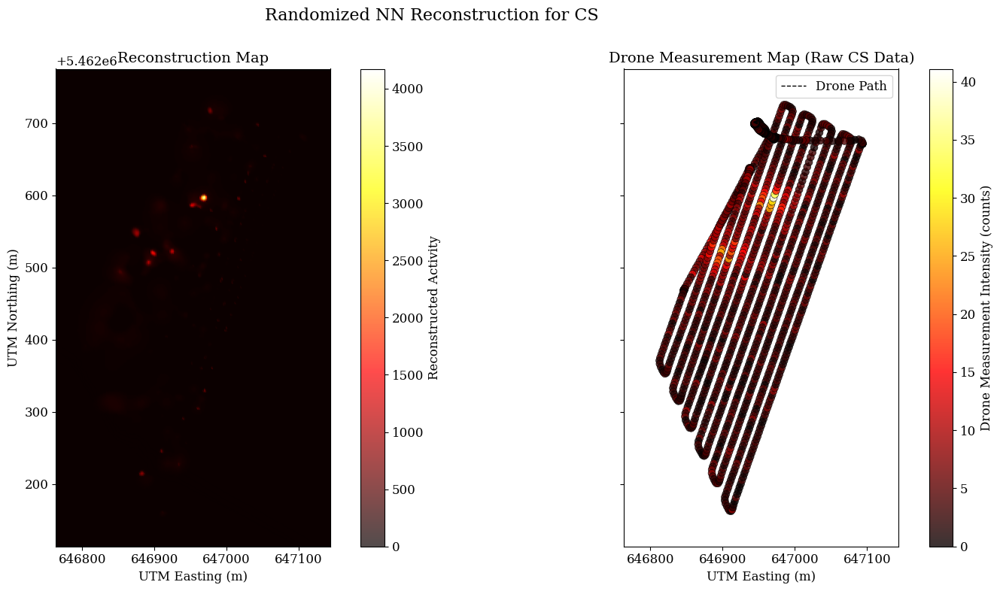

In [21]:
# Example usage:
x_est_no_replace, res_no_replace = kaczmarz_randomized(
    detectors,
    grid_points_for_reconstruction,
    b_cs,
    A_matrix_cs,
    n_iter=100,
    isotope_str="cs",
    with_replacement=False  # Change to False to test without replacement
)

plot_reconstruction_and_measurements_side_by_side(
    x_est_no_replace,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    "Randomized NN",
    "cs"
)


Creating side-by-side plot for Randomized NN (cs) ...


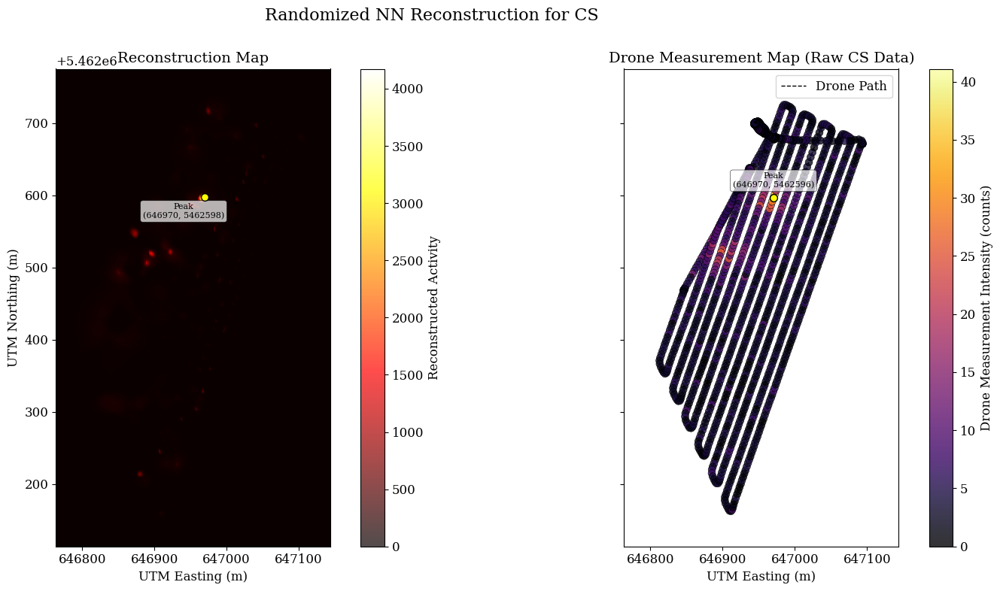


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646969.50, 5462597.50)
Measured Peak Location (UTM): (646970.38, 5462596.50)
Distance between peaks: 1.33 meters


In [24]:
plot_reconstruction_and_measurements_side_by_side2(
    x_est_no_replace,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    "Randomized NN",
    "cs"
)

Randomized Kaczmarz NN (Norm-Prob): 100%|██████████| 100/100 [00:44<00:00,  2.23it/s]



Creating side-by-side plot for Randomized NN (co) ...


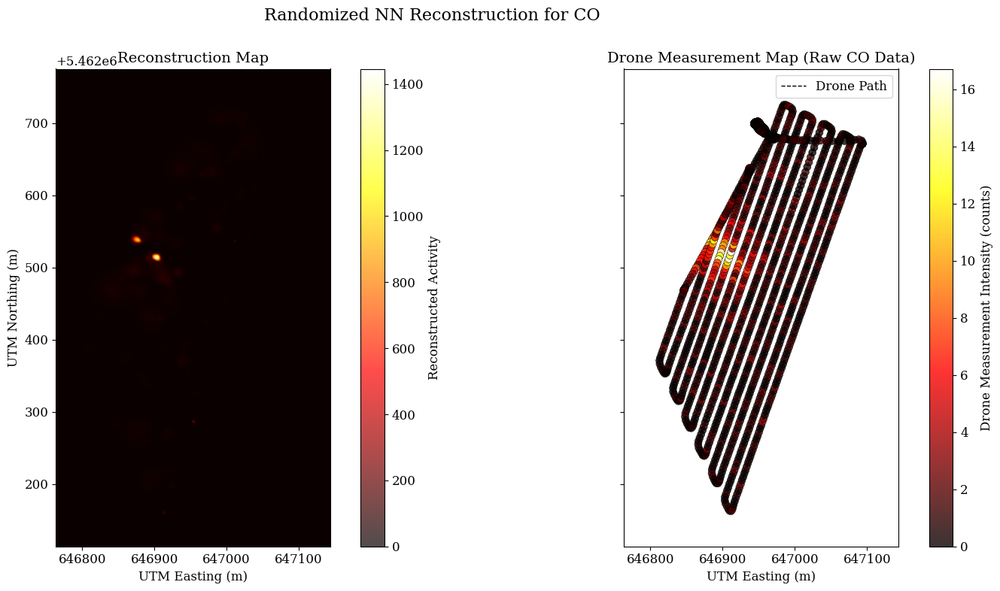

In [28]:
# Example usage:
x_est_no_replace_co, res_no_replace_co = kaczmarz_randomized(
    detectors,
    grid_points_for_reconstruction,
    b_co,
    A_matrix_co,
    n_iter=100,
    isotope_str="co",
    with_replacement=False  # Change to False to test without replacement
)

plot_reconstruction_and_measurements_side_by_side(
    x_est_no_replace_co,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    "Randomized NN",
    "co"
)

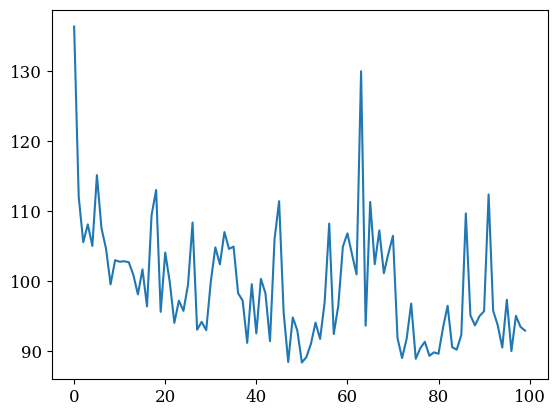

In [22]:
plt.plot(res) # with replacement

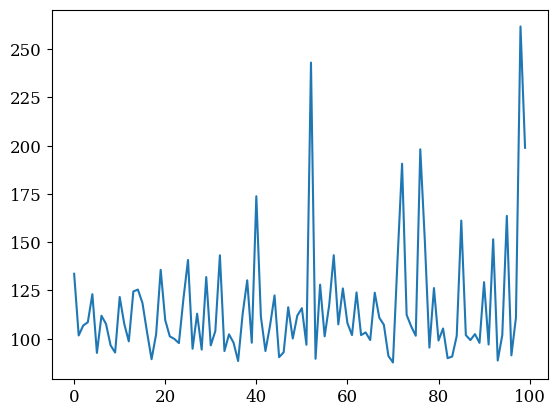

In [23]:
plt.plot(res_no_replace) # without replacement

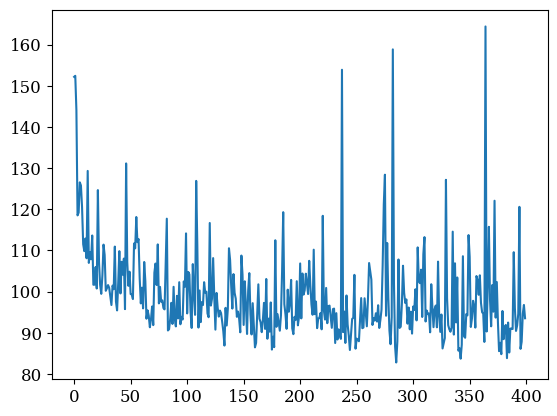

In [ ]:
plt.plot(res) # with omega 1 400 replacement

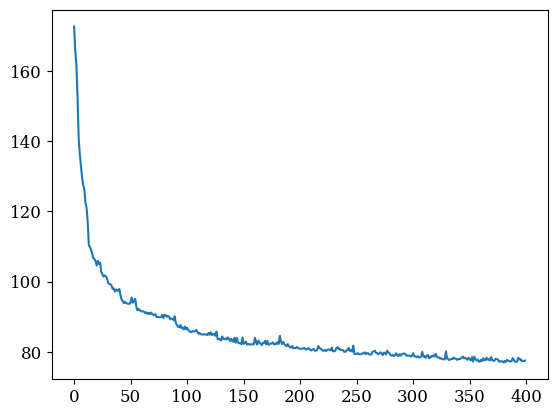

In [ ]:
plt.plot(res) # 400 with 0.1 omega

In [ ]:
def base_kaczmarz(detectors, grid_points, b, A_matrix, n_iter=400, isotope_str="cs"):
    x, m, n, _, _ = _kaczmarz_base(detectors, grid_points, b, isotope=isotope_str)
    residuals_per_iteration = []
    for _ in tqdm(range(n_iter), desc=f"Kaczmarz NN"):
        for i in range(m):
            A_i = A_matrix[i, :]
            residual = b[i] - A_i @ x
            x += 0.02 * (residual / np.sum(A_i**2)) * A_i
            x = np.maximum(0, x)
        residuals_per_iteration.append(calculate_system_residual(x, b, A_matrix))
    return x, np.array(residuals_per_iteration)


--- Running Kaczmarz Cyclic NN (Cs) ---


Kaczmarz NN: 100%|██████████| 100/100 [00:45<00:00,  2.21it/s]


Final Residual (Cyclic NN Cs): 79.7388

Creating 2D terrain map with reconstruction overlay for Kaczmarz Cyclic NN Reconstruction (Cs) (Threshold: 0.0%) ...


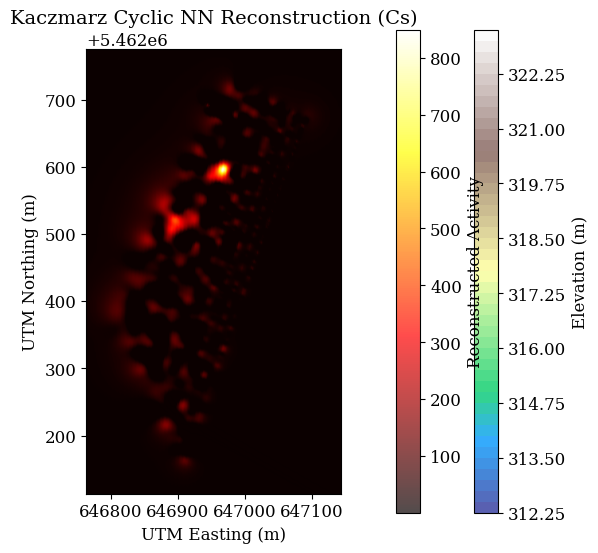

In [ ]:
print("\n--- Running Kaczmarz Cyclic NN (Cs) ---")
x_recon_cyclic_nn_cs, residuals_cyclic_nn_cs = base_kaczmarz(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, n_iter=kaczmarz_n_iter, isotope_str="cs")

print(f"Final Residual (Cyclic NN Cs): {residuals_cyclic_nn_cs[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_cyclic_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Cyclic NN Reconstruction (Cs)")

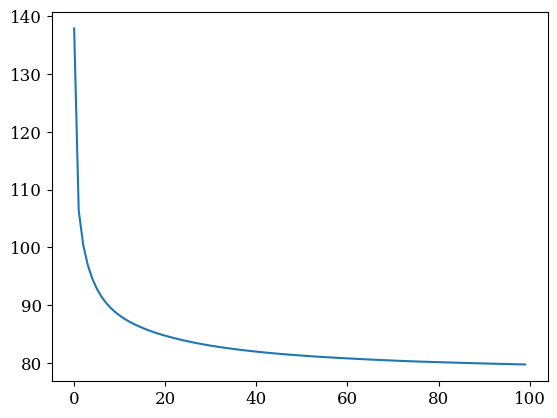

In [ ]:
plt.plot(residuals_cyclic_nn_cs)

# Main runs


--- Running and Plotting Kaczmarz Algorithms for Cesium (Cs) ---

--- Running Kaczmarz Cyclic NN (Cs) ---


Cyclic Kaczmarz NN (CS) Iterations: 100%|██████████| 100/100 [00:46<00:00,  2.15it/s]


Final Residual (Cyclic NN Cs): 127.0184

Creating 2D terrain map with reconstruction overlay for Kaczmarz Cyclic NN Reconstruction (Cs) (Threshold: 0.0%) ...


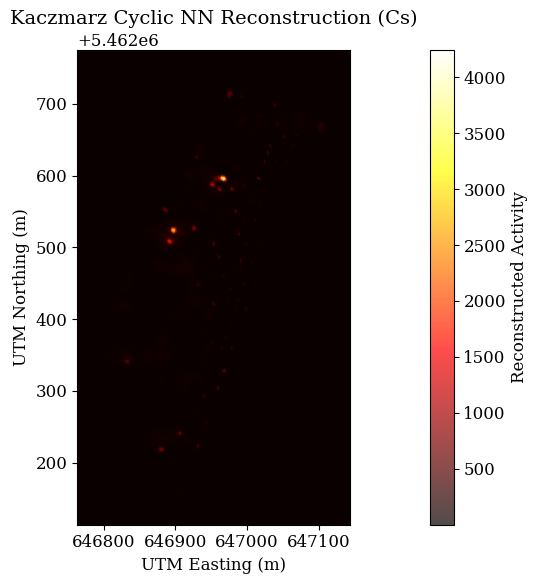


Creating side-by-side plot for Cyclic NN (cs) ...


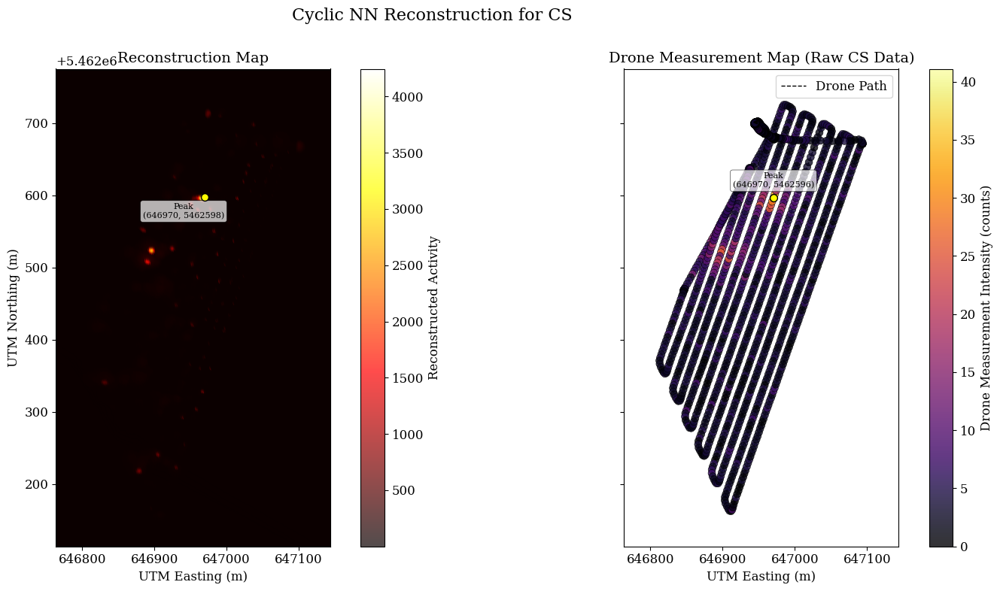


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646969.50, 5462597.50)
Measured Peak Location (UTM): (646970.38, 5462596.50)
Distance between peaks: 1.33 meters

--- Running Kaczmarz Upsweep NN (Cs) ---


Upsweep Kaczmarz NN (CS) Iterations: 100%|██████████| 100/100 [01:25<00:00,  1.18it/s]


Final Residual (Upsweep NN Cs): 97.0385

Creating 2D terrain map with reconstruction overlay for Kaczmarz Symmetric NN Reconstruction (Cs) (Threshold: 0.0%) ...


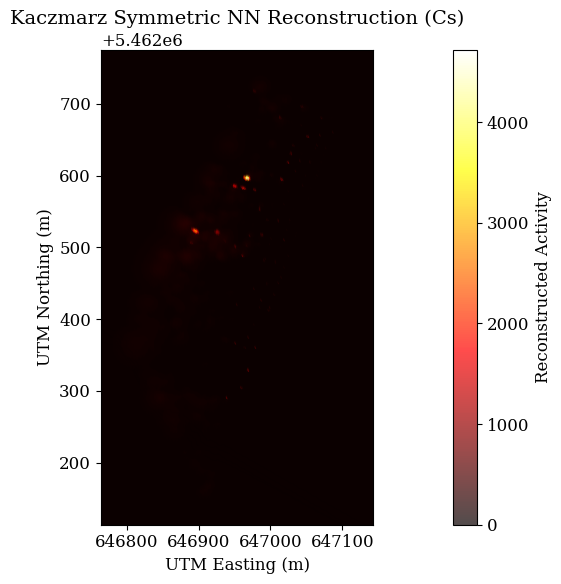


Creating side-by-side plot for Symmetric NN (cs) ...


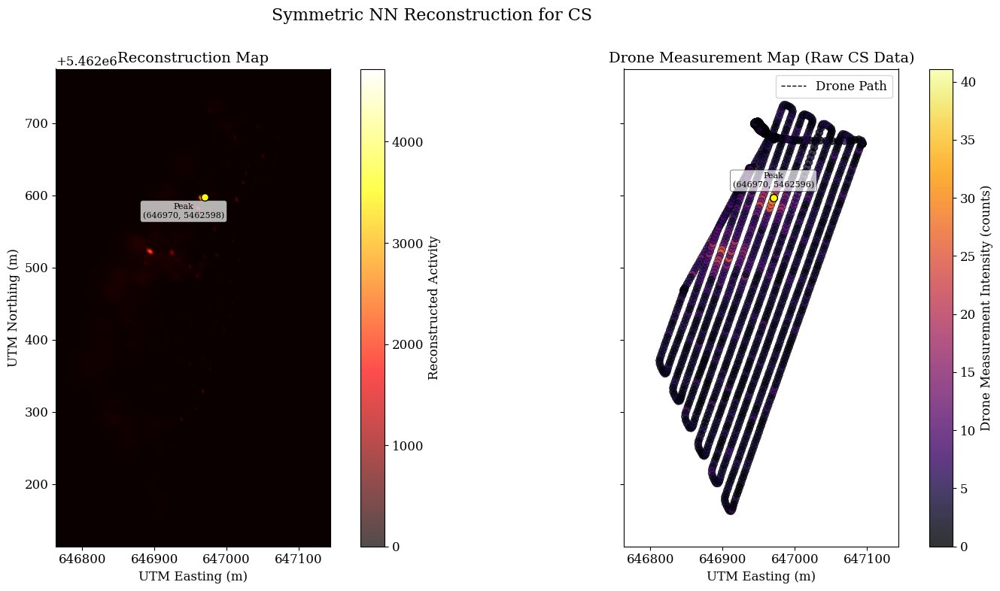


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646969.50, 5462597.50)
Measured Peak Location (UTM): (646970.38, 5462596.50)
Distance between peaks: 1.33 meters

--- Running Kaczmarz Randomized NN (Cs) ---


Randomized Kaczmarz NN (CS) Iterations: 100%|██████████| 100/100 [00:47<00:00,  2.11it/s]


Final Residual (Randomized NN Cs): 91.3277

Creating 2D terrain map with reconstruction overlay for Kaczmarz Randomized NN Reconstruction (Cs) (Threshold: 0.0%) ...


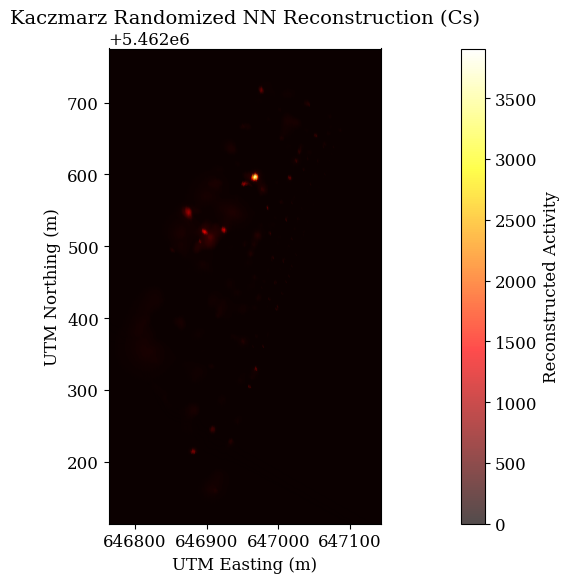


Creating side-by-side plot for Randomized NN (cs) ...


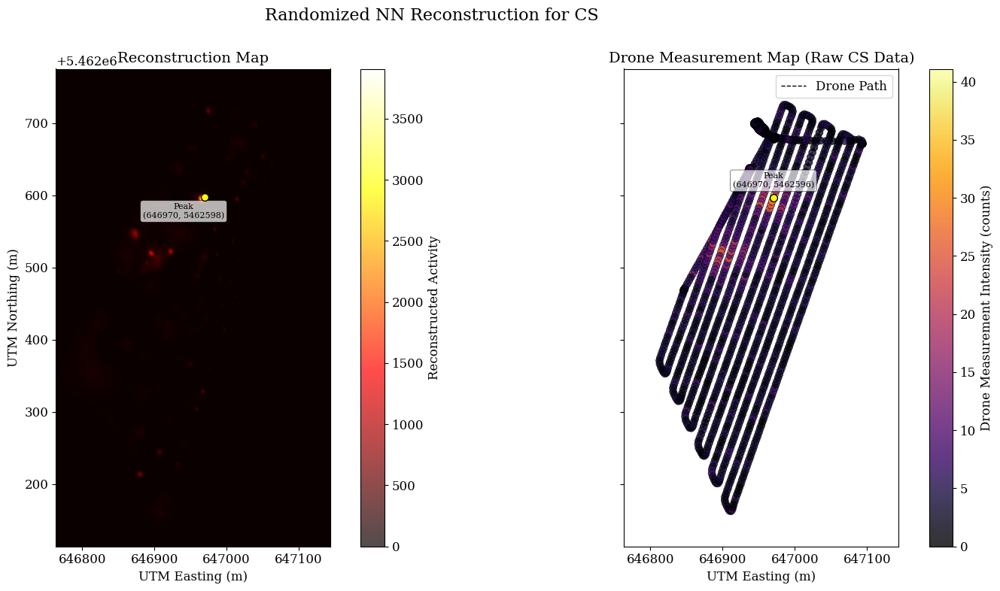


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646969.50, 5462597.50)
Measured Peak Location (UTM): (646970.38, 5462596.50)
Distance between peaks: 1.33 meters

Plotting Residuals Over Iterations (Cesium - Cs)...


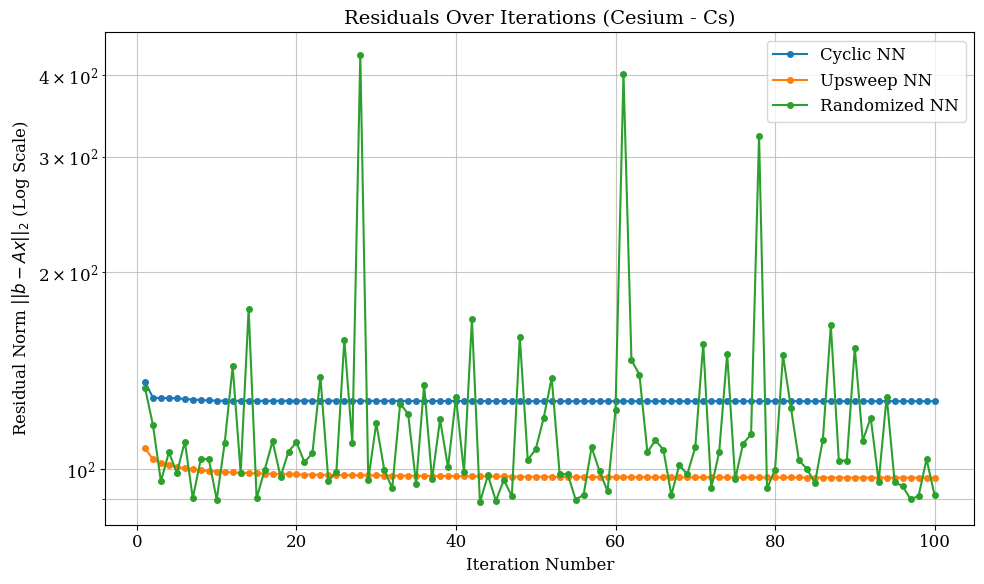


--- Running and Plotting Kaczmarz Algorithms for Cobalt (Co) ---

--- Running Kaczmarz Cyclic NN (Co) ---


Cyclic Kaczmarz NN (CO) Iterations: 100%|██████████| 100/100 [00:46<00:00,  2.15it/s]


Final Residual (Cyclic NN Co): 50.4266

Creating 2D terrain map with reconstruction overlay for Kaczmarz Cyclic NN Reconstruction (Co) (Threshold: 0.0%) ...


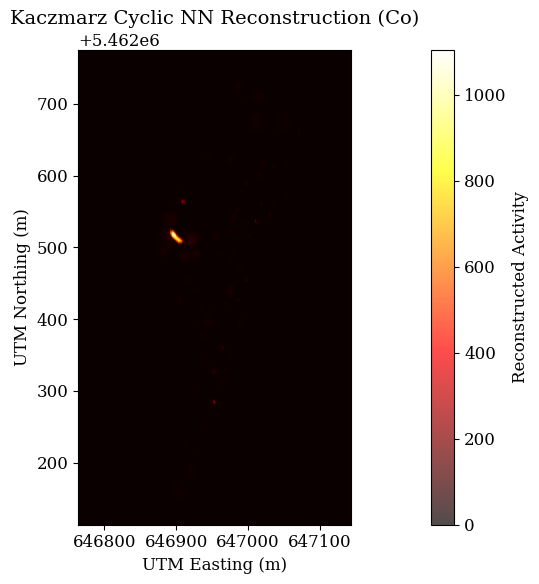


Creating side-by-side plot for Cyclic NN (co) ...


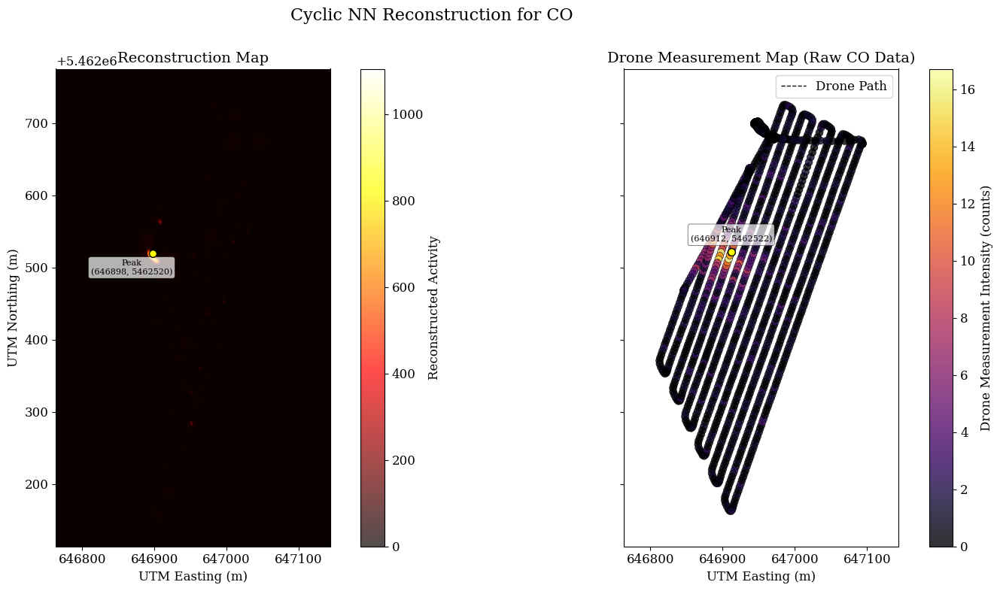


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646897.50, 5462519.50)
Measured Peak Location (UTM): (646911.75, 5462521.50)
Distance between peaks: 14.39 meters

--- Running Kaczmarz Upsweep NN (Co) ---


Upsweep Kaczmarz NN (CO) Iterations: 100%|██████████| 100/100 [01:27<00:00,  1.15it/s]


Final Residual (Upsweep NN Co): 48.9528

Creating 2D terrain map with reconstruction overlay for Kaczmarz Symmetric NN Reconstruction (Co) (Threshold: 0.0%) ...


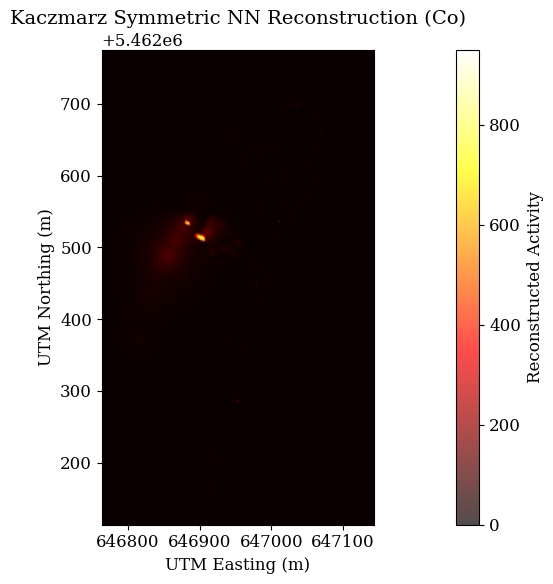


Creating side-by-side plot for Symmetric NN (co) ...


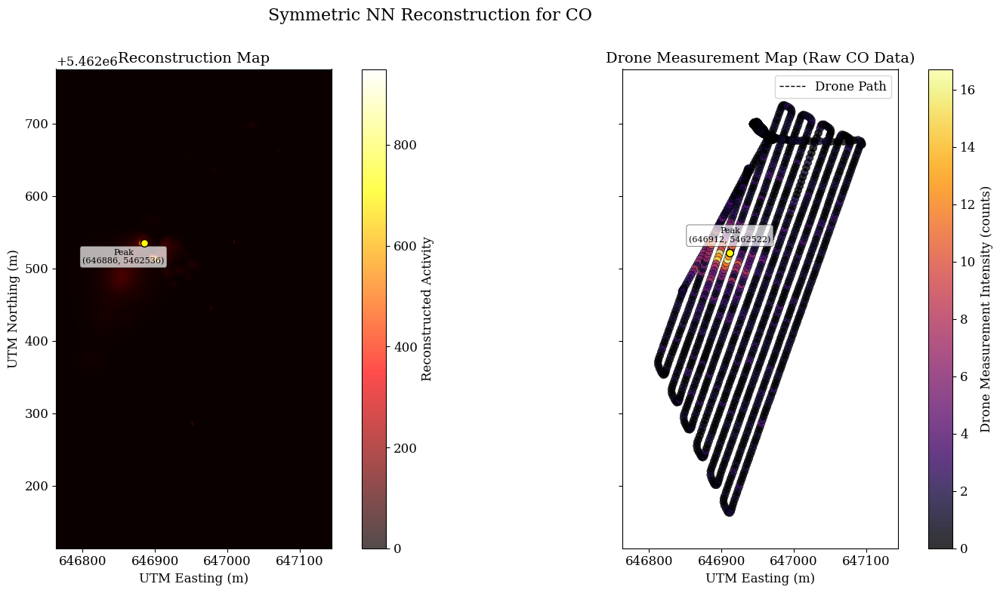


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646885.50, 5462535.50)
Measured Peak Location (UTM): (646911.75, 5462521.50)
Distance between peaks: 29.75 meters

--- Running Kaczmarz Randomized NN (Co) ---


Randomized Kaczmarz NN (CO) Iterations: 100%|██████████| 100/100 [00:47<00:00,  2.11it/s]


Final Residual (Randomized NN Co): 50.1371

Creating 2D terrain map with reconstruction overlay for Kaczmarz Randomized NN Reconstruction (Co) (Threshold: 0.0%) ...


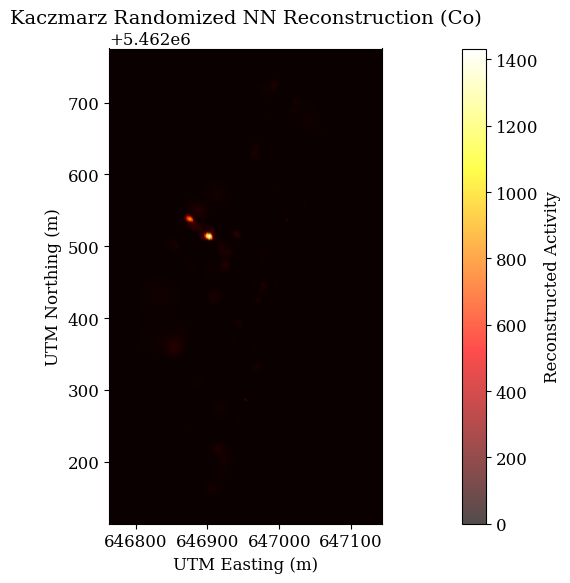


Creating side-by-side plot for Randomized NN (co) ...


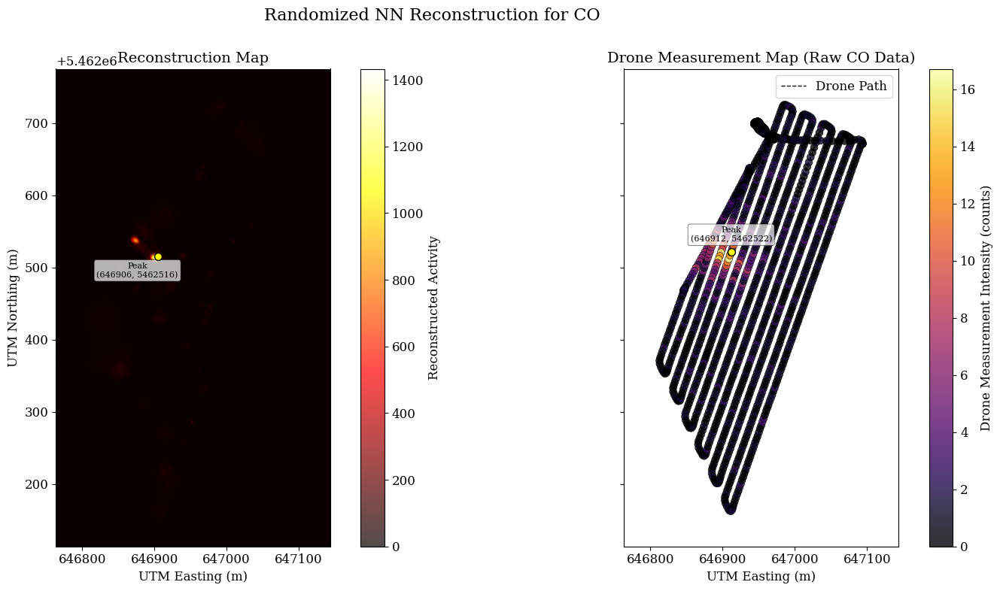


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646905.50, 5462515.50)
Measured Peak Location (UTM): (646911.75, 5462521.50)
Distance between peaks: 8.66 meters

Plotting Residuals Over Iterations (Cobalt - Co)...


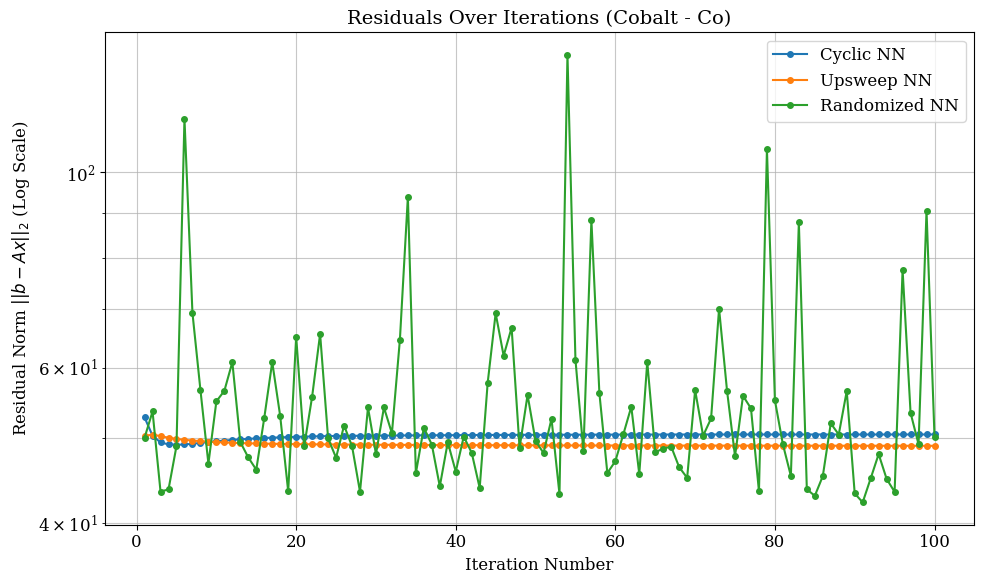


--- All Kaczmarz algorithms execution and plotting complete for both Cs and Co. ---


In [14]:
# --- Run and Plot for Cesium (Cs) ---
print("\n--- Running and Plotting Kaczmarz Algorithms for Cesium (Cs) ---")
cs_residuals_data = {}

# --- Non-Negative (NN) Algorithms (kept) ---

# 1. Kaczmarz Cyclic Non-Negative (NN) (Cs)
print("\n--- Running Kaczmarz Cyclic NN (Cs) ---")
x_recon_cyclic_nn_cs, residuals_cyclic_nn_cs = kaczmarz_cyclic_nn(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, n_iter=kaczmarz_n_iter, isotope_str="cs")
cs_residuals_data['Cyclic NN'] = residuals_cyclic_nn_cs
print(f"Final Residual (Cyclic NN Cs): {residuals_cyclic_nn_cs[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_cyclic_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Cyclic NN Reconstruction (Cs)")

plot_reconstruction_and_measurements_side_by_side2(
    x_recon_cyclic_nn_cs,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    "Cyclic NN",
    "cs"
)


# 2. Kaczmarz Upsweep Non-Negative (NN) (Cs)
print("\n--- Running Kaczmarz Upsweep NN (Cs) ---")
x_recon_upsweep_nn_cs, residuals_upsweep_nn_cs = kaczmarz_upsweep_nn(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, n_iter=kaczmarz_n_iter, isotope_str="cs")
cs_residuals_data['Upsweep NN'] = residuals_upsweep_nn_cs
print(f"Final Residual (Upsweep NN Cs): {residuals_upsweep_nn_cs[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_upsweep_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Symmetric NN Reconstruction (Cs)")

plot_reconstruction_and_measurements_side_by_side2(
    x_recon_upsweep_nn_cs,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    "Symmetric NN",
    "cs"
)


# 3. Kaczmarz Randomized Non-Negative (NN) (Cs)
print("\n--- Running Kaczmarz Randomized NN (Cs) ---")
x_recon_randomized_nn_cs, residuals_randomized_nn_cs = kaczmarz_randomized_nn(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, n_iter=kaczmarz_n_iter, isotope_str="cs")
cs_residuals_data['Randomized NN'] = residuals_randomized_nn_cs
print(f"Final Residual (Randomized NN Cs): {residuals_randomized_nn_cs[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_randomized_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Randomized NN Reconstruction (Cs)")
plot_reconstruction_and_measurements_side_by_side2(
    x_recon_randomized_nn_cs,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    "Randomized NN",
    "cs"
)




# Plot Residuals for Cs
plot_residuals_over_iterations(cs_residuals_data, kaczmarz_n_iter, title="Residuals Over Iterations (Cesium - Cs)")


# --- Run and Plot for Cobalt (Co) ---
print("\n--- Running and Plotting Kaczmarz Algorithms for Cobalt (Co) ---")
co_residuals_data = {}

# --- Non-Negative (NN) Algorithms (kept) ---

# 1. Kaczmarz Cyclic Non-Negative (NN) (Co)
print("\n--- Running Kaczmarz Cyclic NN (Co) ---")
x_recon_cyclic_nn_co, residuals_cyclic_nn_co = kaczmarz_cyclic_nn(detectors, grid_points_for_reconstruction, b_co, A_matrix_co, n_iter=kaczmarz_n_iter, isotope_str="co")
co_residuals_data['Cyclic NN'] = residuals_cyclic_nn_co
print(f"Final Residual (Cyclic NN Co): {residuals_cyclic_nn_co[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_cyclic_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Cyclic NN Reconstruction (Co)")

plot_reconstruction_and_measurements_side_by_side2(
    x_recon_cyclic_nn_co,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    "Cyclic NN",
    "co"
)


# 2. Kaczmarz Upsweep Non-Negative (NN) (Co)
print("\n--- Running Kaczmarz Upsweep NN (Co) ---")
x_recon_upsweep_nn_co, residuals_upsweep_nn_co = kaczmarz_upsweep_nn(detectors, grid_points_for_reconstruction, b_co, A_matrix_co, n_iter=kaczmarz_n_iter, isotope_str="co")
co_residuals_data['Upsweep NN'] = residuals_upsweep_nn_co
print(f"Final Residual (Upsweep NN Co): {residuals_upsweep_nn_co[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_upsweep_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Symmetric NN Reconstruction (Co)")

plot_reconstruction_and_measurements_side_by_side2(
    x_recon_upsweep_nn_co,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    "Symmetric NN",
    "co"
)


# 3. Kaczmarz Randomized Non-Negative (NN) (Co)
print("\n--- Running Kaczmarz Randomized NN (Co) ---")
x_recon_randomized_nn_co, residuals_randomized_nn_co = kaczmarz_randomized_nn(detectors, grid_points_for_reconstruction, b_co, A_matrix_co, n_iter=kaczmarz_n_iter, isotope_str="co")
co_residuals_data['Randomized NN'] = residuals_randomized_nn_co
print(f"Final Residual (Randomized NN Co): {residuals_randomized_nn_co[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_randomized_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Randomized NN Reconstruction (Co)")

plot_reconstruction_and_measurements_side_by_side2(
    x_recon_randomized_nn_co,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    "Randomized NN",
    "co"
)




# Plot Residuals for Co
plot_residuals_over_iterations(co_residuals_data, kaczmarz_n_iter, title="Residuals Over Iterations (Cobalt - Co)")


print("\n--- All Kaczmarz algorithms execution and plotting complete for both Cs and Co. ---")


--- Running Kaczmarz Upsweep Cyclic NN (Cs) ---


Cyclic Kaczmarz NN (CS) Iterations: 100%|██████████| 100/100 [01:01<00:00,  1.63it/s]


Final Residual (Cyclic NN Cs): 89.2025

Creating 2D terrain map with reconstruction overlay for Kaczmarz Cyclic NN Reconstruction (Cs) (Threshold: 0.0%) ...


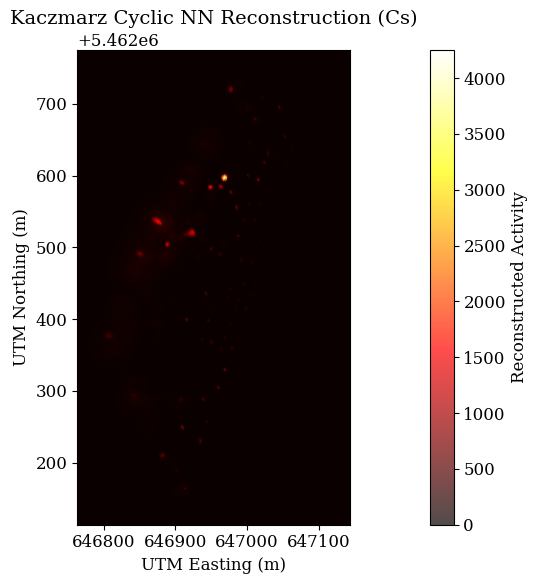


Creating side-by-side plot for Cyclic NN (cs) ...


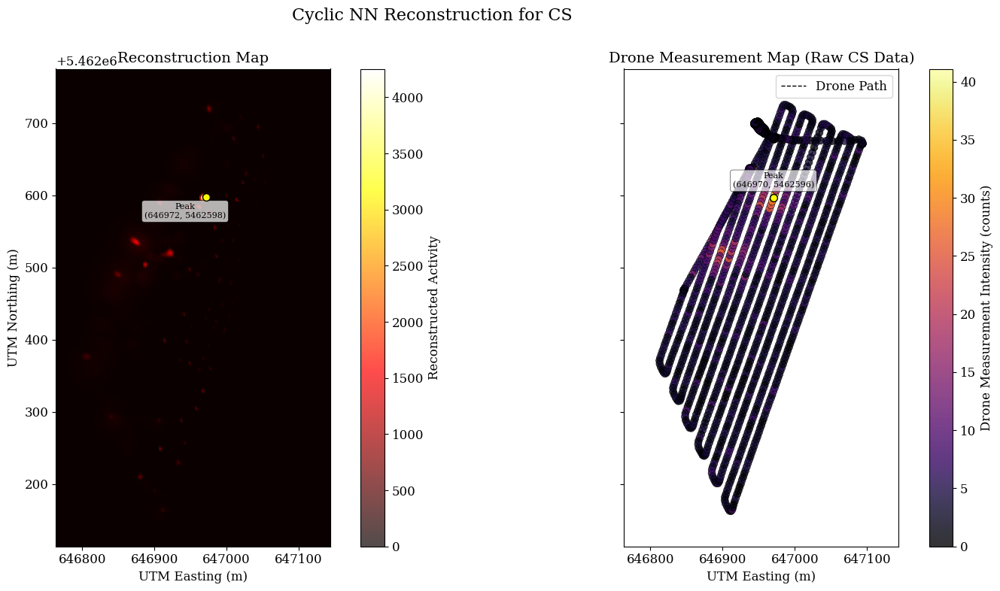


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646971.50, 5462597.50)
Measured Peak Location (UTM): (646970.38, 5462596.50)
Distance between peaks: 1.51 meters

--- Running Kaczmarz Cyclic Upsweep NN (Co) ---


Cyclic Kaczmarz NN (CO) Iterations: 100%|██████████| 100/100 [00:53<00:00,  1.86it/s]


Final Residual (Cyclic NN Co): 50.6405

Creating 2D terrain map with reconstruction overlay for Kaczmarz Cyclic NN Reconstruction (Co) (Threshold: 0.0%) ...


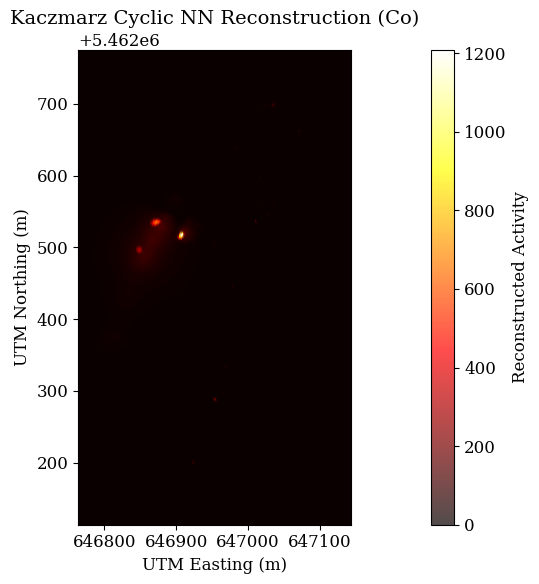


Creating side-by-side plot for Cyclic NN (co) ...


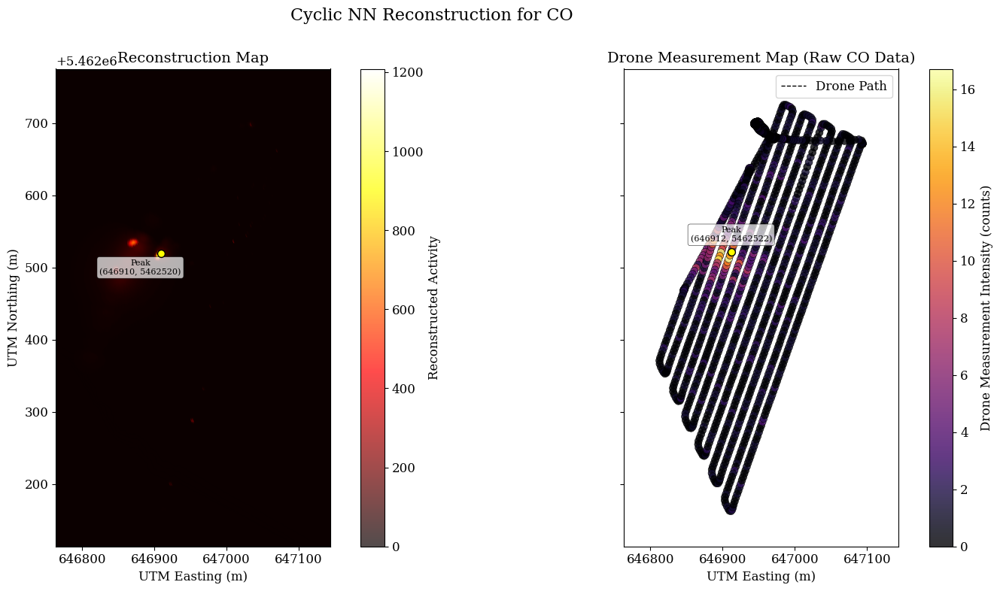


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646909.50, 5462519.50)
Measured Peak Location (UTM): (646911.75, 5462521.50)
Distance between peaks: 3.01 meters


In [30]:
def kaczmarz_cyclic_upsweep_nn(detectors, grid_points, b, A_matrix, n_iter=100, isotope_str="cs"):
    x, m, n, _, _ = _kaczmarz_base(detectors, grid_points, b, isotope=isotope_str)
    residuals_per_iteration = []
    for it in tqdm(range(n_iter), desc=f"Cyclic Kaczmarz NN ({isotope_str.upper()}) Iterations"):
        for i in range(m - 1, -1, -1):  # Upsweep: reverse order
            A_i = A_matrix[i, :]
            A_i_norm_sq = np.sum(A_i**2)
            if A_i_norm_sq == 0: continue
            residual = b[i] - A_i @ x
            x += (residual / A_i_norm_sq) * A_i
            x = np.maximum(0, x)
        residuals_per_iteration.append(calculate_system_residual(x, b, A_matrix))
    return x, np.array(residuals_per_iteration)

print("\n--- Running Kaczmarz Upsweep Cyclic NN (Cs) ---")
x_recon_cyclic_upsweep_nn_cs, residuals_cyclic_upsweep_nn_cs = kaczmarz_cyclic_upsweep_nn(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, n_iter=kaczmarz_n_iter, isotope_str="cs")
cs_residuals_data['Cyclic NN'] = residuals_cyclic_upsweep_nn_cs
print(f"Final Residual (Cyclic NN Cs): {residuals_cyclic_upsweep_nn_cs[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_cyclic_upsweep_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Cyclic NN Reconstruction (Cs)")

plot_reconstruction_and_measurements_side_by_side2(
    x_recon_cyclic_upsweep_nn_cs,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    "Cyclic NN",
    "cs"
)

print("\n--- Running Kaczmarz Cyclic Upsweep NN (Co) ---")
x_recon_cyclic_upsweep_nn_co, residuals_cyclic_upsweep_nn_co = kaczmarz_cyclic_upsweep_nn(detectors, grid_points_for_reconstruction, b_co, A_matrix_co, n_iter=kaczmarz_n_iter, isotope_str="co")
co_residuals_data['Cyclic NN'] = residuals_cyclic_upsweep_nn_co
print(f"Final Residual (Cyclic NN Co): {residuals_cyclic_upsweep_nn_co[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_cyclic_upsweep_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Cyclic NN Reconstruction (Co)")

plot_reconstruction_and_measurements_side_by_side2(
    x_recon_cyclic_upsweep_nn_co,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    "Cyclic NN",
    "co"
)

## Early Stopping


--- Running Kaczmarz for Cesium-137 with Early Stopping ---


Kaczmarz Downsweep with Early Stop:  16%|█▌        | 161/1000 [04:40<24:22,  1.74s/it]

Stopping early at iteration 162 due to minimal change in residual.


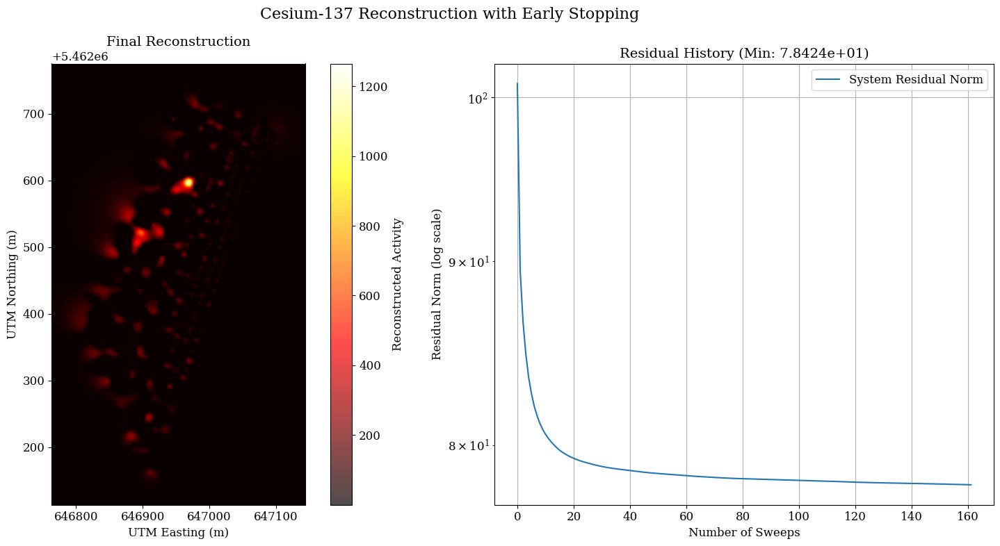


--- Running Kaczmarz for Cobalt-60 with Early Stopping ---


Kaczmarz Downsweep with Early Stop:  20%|██        | 202/1000 [05:48<22:55,  1.72s/it]

Stopping early at iteration 203 due to minimal change in residual.


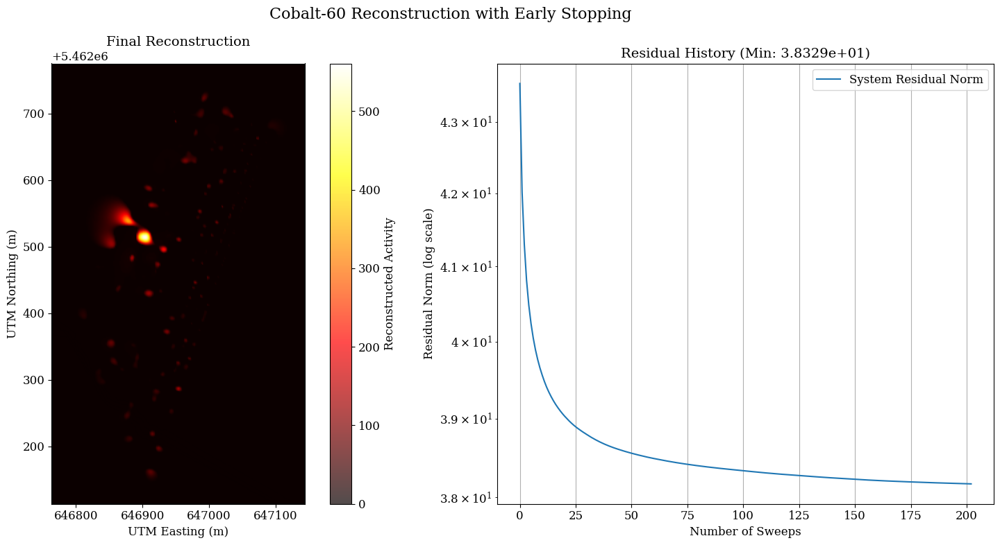


--- All reconstructions and plots have been generated. ---


In [32]:
# --- Run Kaczmarz with Early Stopping for Cesium-137 ---
if __name__ == "__main__":
    print("\n--- Running Kaczmarz for Cesium-137 with Early Stopping ---")
    x_recon_cs_early_stop, min_residual_cs_early_stop, res_history_cs_early_stop = kaczmarz_downsweep_early_stop(
        A=A_matrix_cs,
        b=b_cs,
        omega=0.1,  # A good starting point based on previous runs
        max_iters=1000,
        slack=100,
        tolerance=0.5
    )

    # Now you can visualize the results
    plot_reconstruction_and_history(x_recon_cs_early_stop, res_history_cs_early_stop, xx_mesh, yy_mesh,
                                    Z_terrain_interpolated, grid_points_for_reconstruction,
                                    detectors, b_cs, "Cesium-137 Reconstruction with Early Stopping", min_residual_cs_early_stop)

    # --- Run Kaczmarz with Early Stopping for Cobalt-60 ---
    print("\n--- Running Kaczmarz for Cobalt-60 with Early Stopping ---")
    x_recon_co_early_stop, min_residual_co_early_stop, res_history_co_early_stop = kaczmarz_downsweep_early_stop(
        A=A_matrix_co,
        b=b_co,
        omega=0.1,  # Use the same or a tuned value
        max_iters=1000,
        slack=100,
        tolerance=0.5
    )

    # Now you can visualize the results
    plot_reconstruction_and_history(x_recon_co_early_stop, res_history_co_early_stop, xx_mesh, yy_mesh,
                                    Z_terrain_interpolated, grid_points_for_reconstruction,
                                    detectors, b_co, "Cobalt-60 Reconstruction with Early Stopping", min_residual_co_early_stop)

    print("\n--- All reconstructions and plots have been generated. ---")


Creating side-by-side plot for Early Stopped Kaczmarz (Cs) (cs) ...


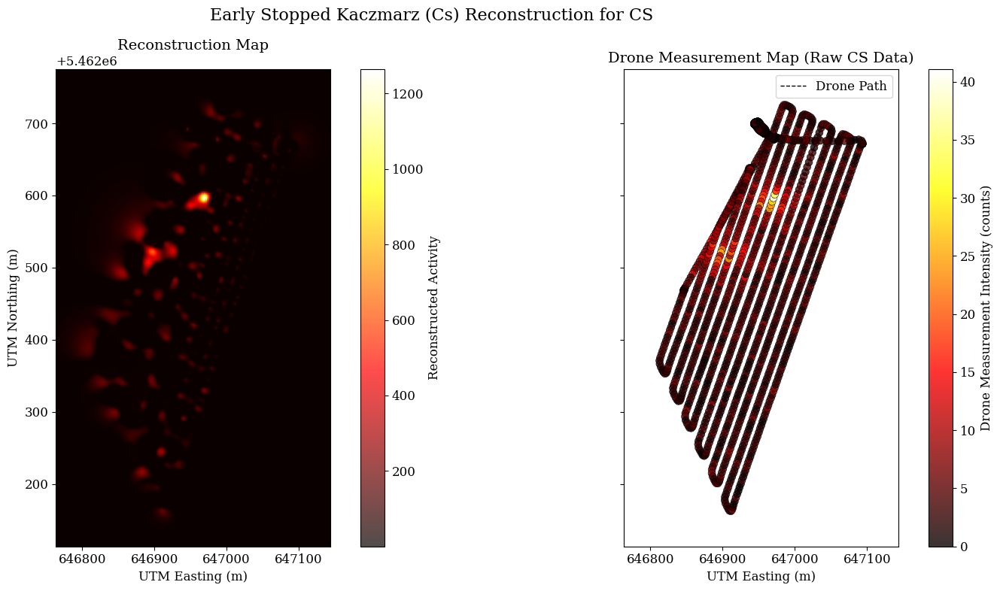


Creating side-by-side plot for Early Stopped Kaczmarz (Cs) (cs) ...


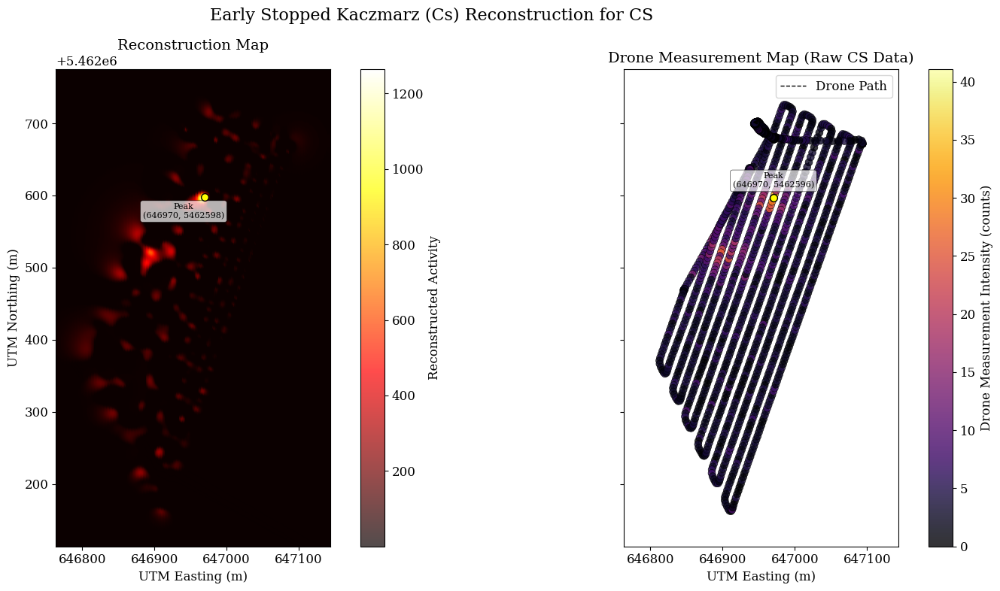


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646969.50, 5462597.50)
Measured Peak Location (UTM): (646970.38, 5462596.50)
Distance between peaks: 1.33 meters

Creating side-by-side plot for Early Stopped Kaczmarz (Co) (co) ...


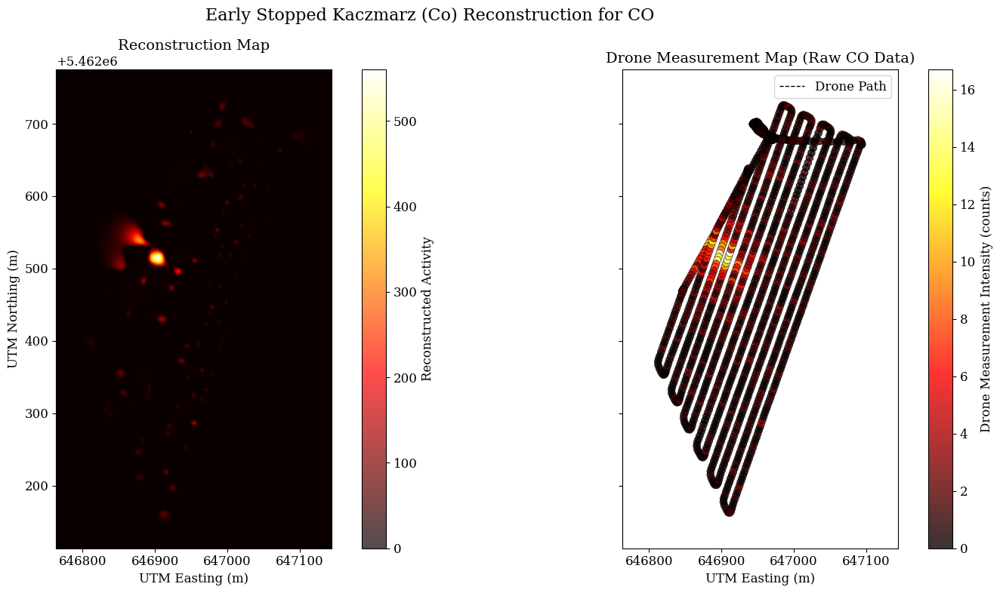


Creating side-by-side plot for Early Stopped Kaczmarz (Co) (co) ...


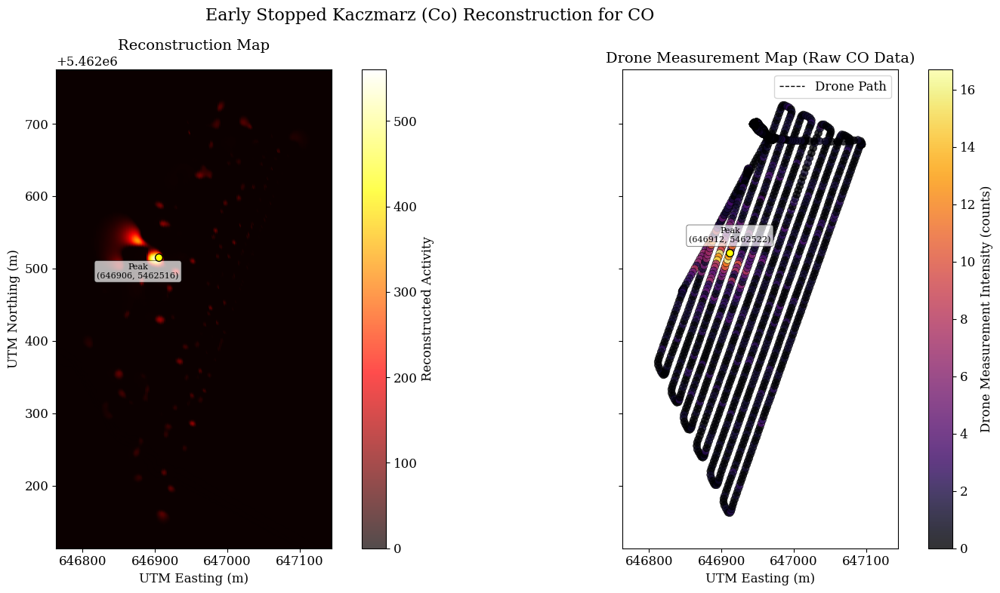


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646905.50, 5462515.50)
Measured Peak Location (UTM): (646911.75, 5462521.50)
Distance between peaks: 8.66 meters


In [33]:
plot_reconstruction_and_measurements_side_by_side(
    x_recon_cs_early_stop,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    f"Early Stopped Kaczmarz (Cs)",
    "cs"
)

plot_reconstruction_and_measurements_side_by_side2(
    x_recon_cs_early_stop,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    f"Early Stopped Kaczmarz (Cs)",
    "cs"
)

plot_reconstruction_and_measurements_side_by_side(
    x_recon_co_early_stop,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    f"Early Stopped Kaczmarz (Co)",
    "co"
)

plot_reconstruction_and_measurements_side_by_side2(
    x_recon_co_early_stop,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    f"Early Stopped Kaczmarz (Co)",
    "co"
)

## Twin error Gauge


--- Running TEG Kaczmarz for Cesium-137 ---


TEG Kaczmarz Sweeps:   0%|          | 50/10000 [01:24<4:39:37,  1.69s/it]

Stopping at iteration 51 with minimal gauge 1.2813e+00


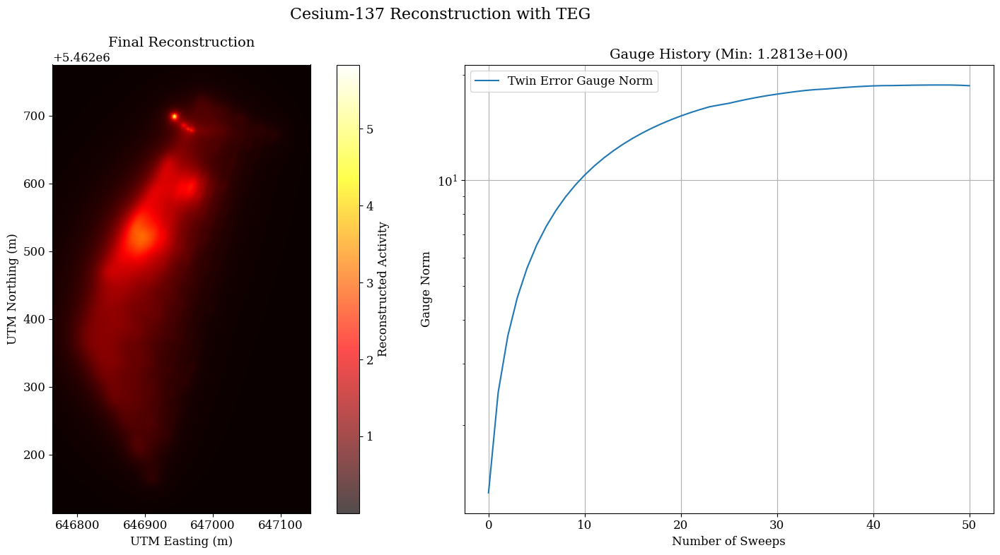


--- Running TEG Kaczmarz for Cobalt-60 ---


TEG Kaczmarz Sweeps:   0%|          | 50/10000 [01:24<4:40:02,  1.69s/it]

Stopping at iteration 51 with minimal gauge 4.6548e-01


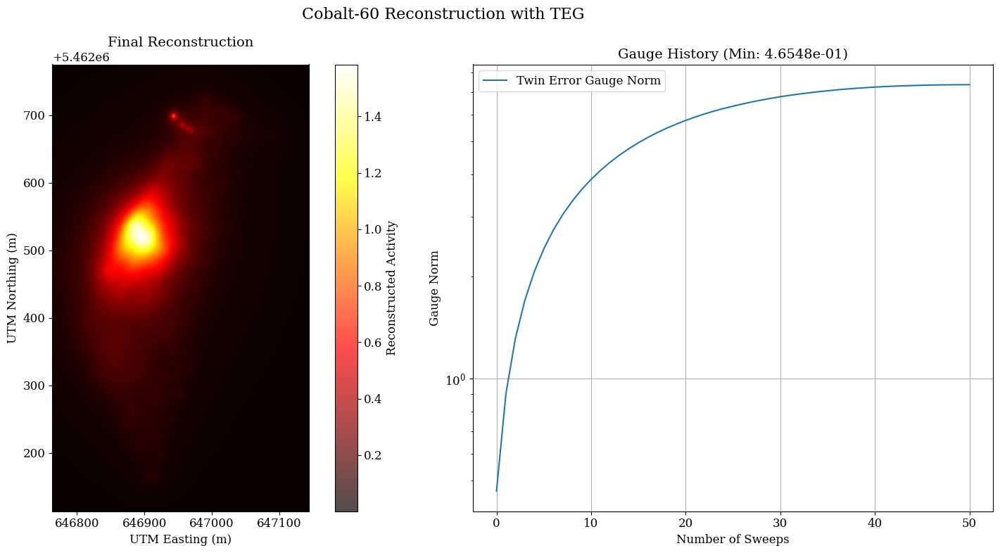


--- All TEG reconstructions and plots have been generated. ---


In [ ]:
# --- Twin Error Gauge Execution and Plotting ---
if __name__ == '__main__':
    # Run for Cesium
    print("\n--- Running TEG Kaczmarz for Cesium-137 ---")
    x_recon_cs, gauge_history_cs, min_gauge_cs = twin_error_gauge_kaczmarz(
        A_matrix_cs, b_cs, omega=0.0005, max_iters=10000, slack=50
    )
    plot_reconstruction_and_gauge(x_recon_cs, gauge_history_cs, xx_mesh, yy_mesh,
                                  Z_terrain_interpolated, grid_points_for_reconstruction,
                                  detectors, b_cs, "Cesium-137 Reconstruction with TEG", min_gauge_cs)

    # Run for Cobalt
    print("\n--- Running TEG Kaczmarz for Cobalt-60 ---")
    x_recon_co, gauge_history_co, min_gauge_co = twin_error_gauge_kaczmarz(
        A_matrix_co, b_co, omega=0.0005, max_iters=10000, slack=50
    )
    plot_reconstruction_and_gauge(x_recon_co, gauge_history_co, xx_mesh, yy_mesh,
                                  Z_terrain_interpolated, grid_points_for_reconstruction,
                                  detectors, b_co, "Cobalt-60 Reconstruction with TEG", min_gauge_co)

    print("\n--- All TEG reconstructions and plots have been generated. ---")


--- Plotting Early Stopping Reconstruction for Cesium (Cs) ---


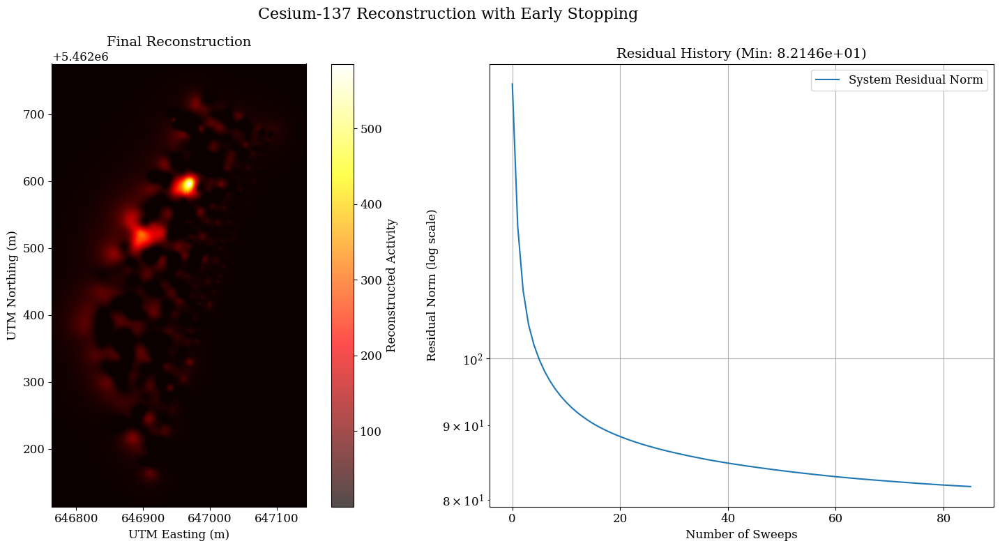


Creating side-by-side plot for Early Stopping (cs) ...


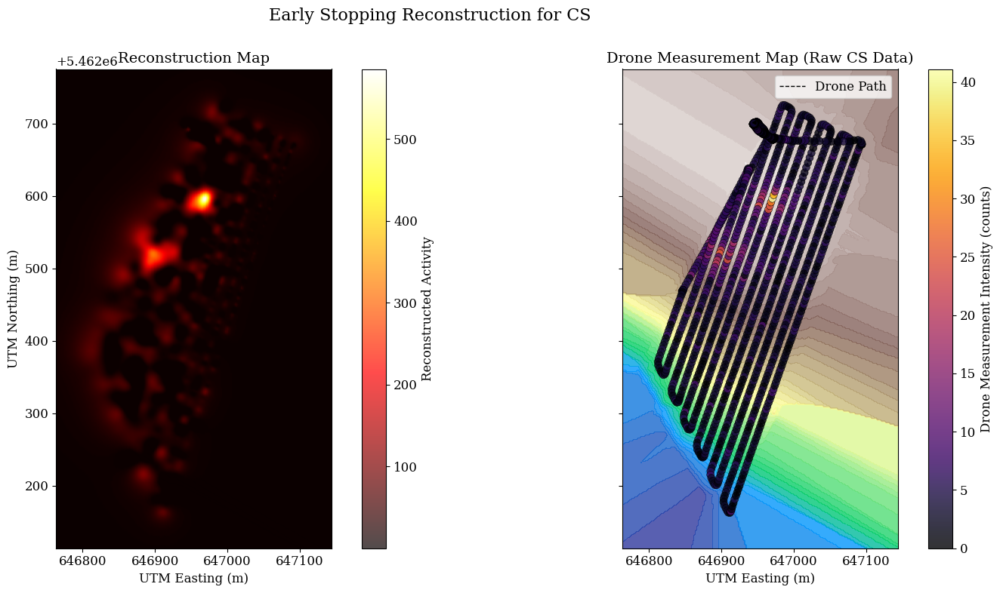


--- Plotting Early Stopping Reconstruction for Cobalt (Co) ---


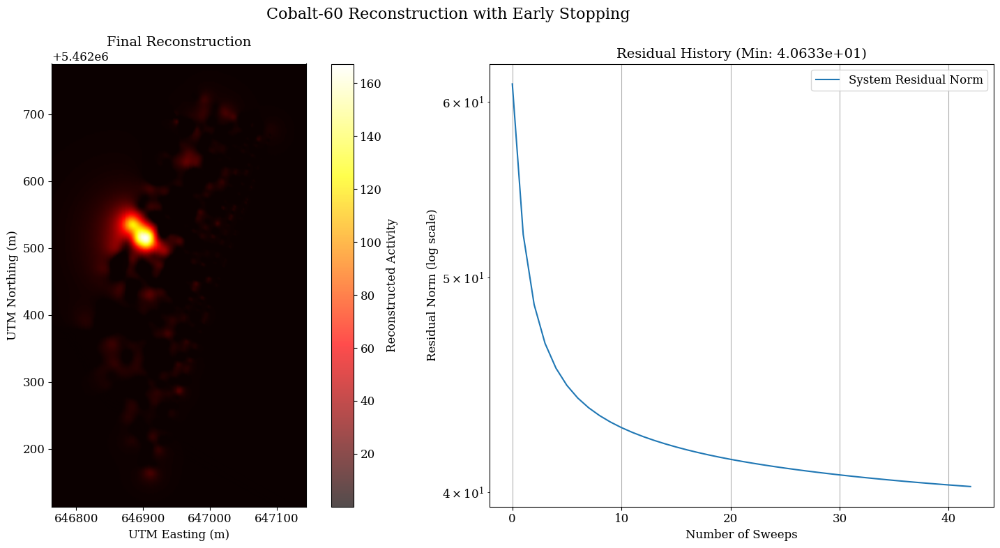


Creating side-by-side plot for Early Stopping (co) ...


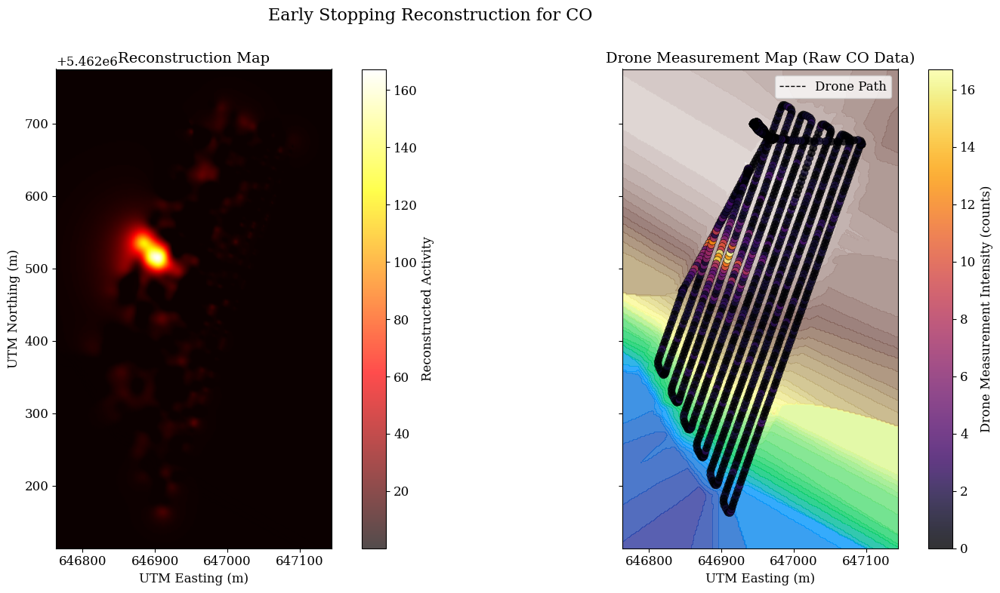


--- Plotting TEG Reconstruction for Cesium (Cs) ---


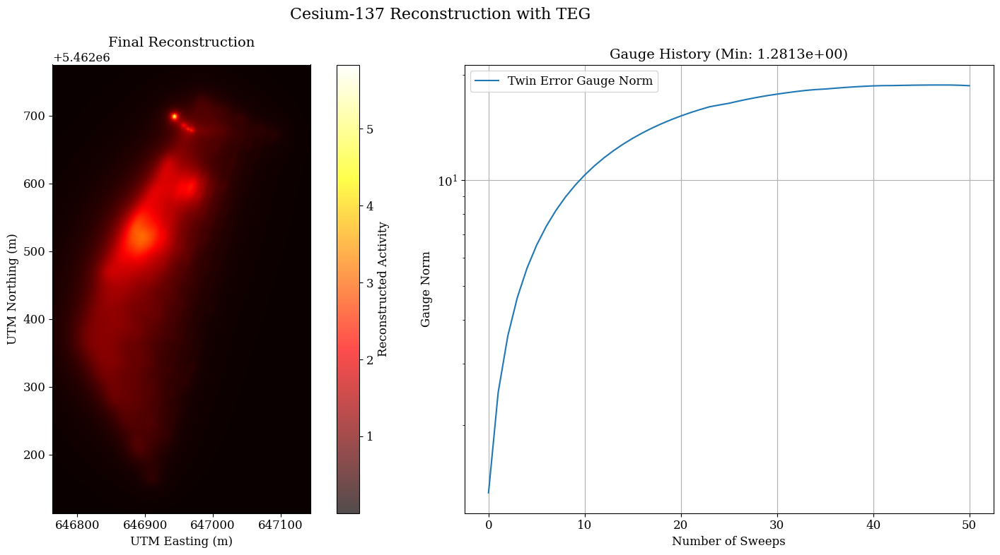


Creating side-by-side plot for TEG (cs) ...


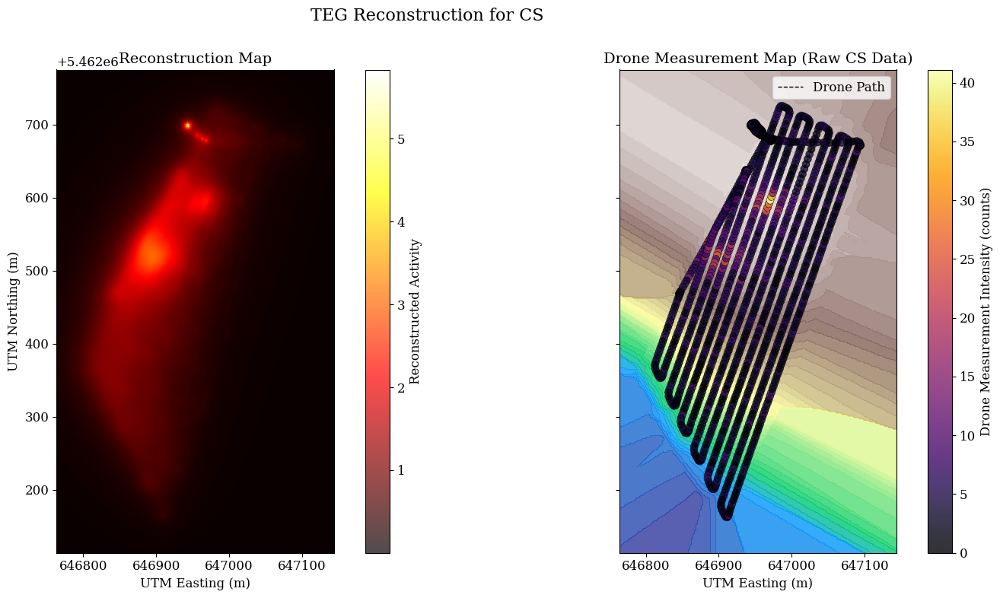


--- Plotting TEG Reconstruction for Cobalt (Co) ---


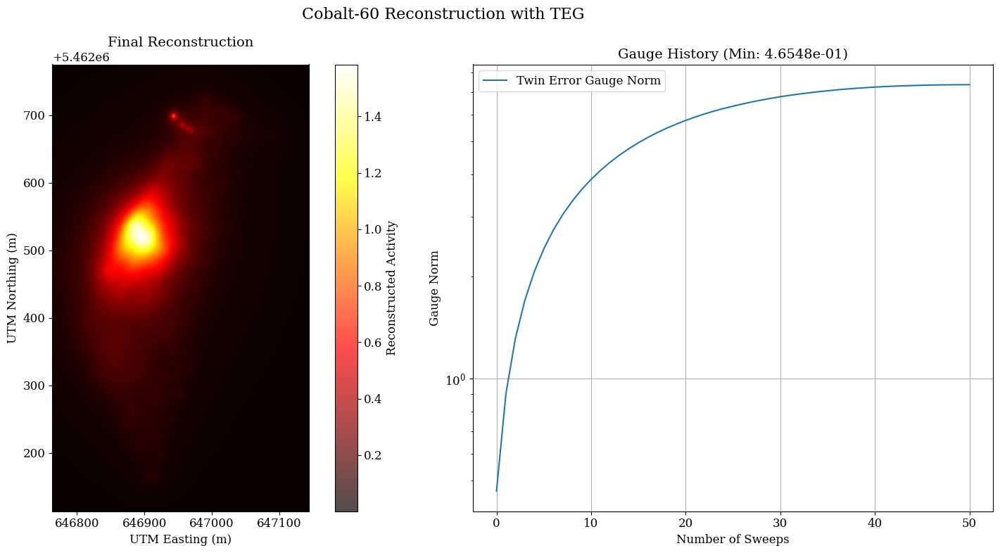


Creating side-by-side plot for TEG (co) ...


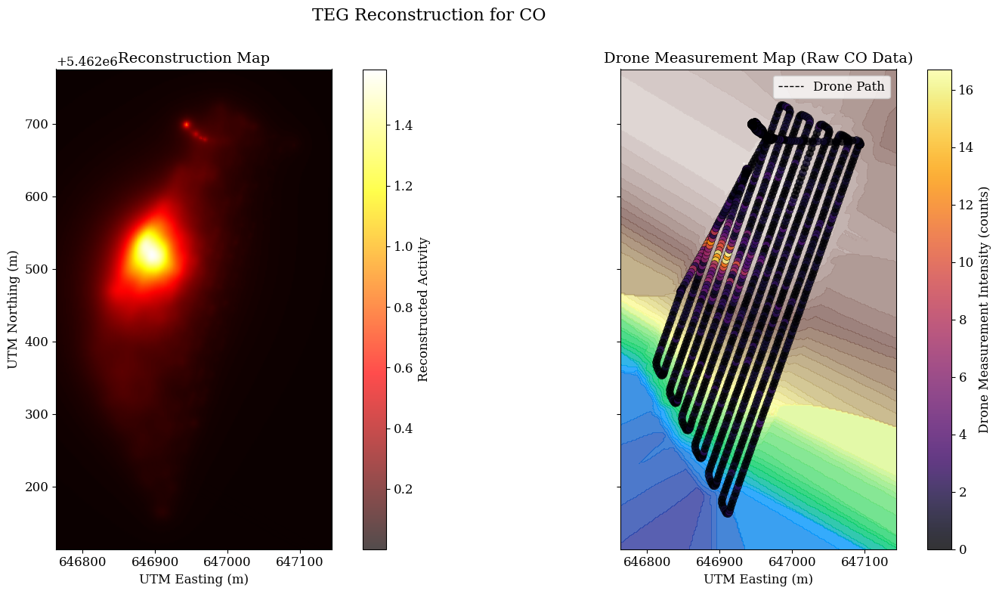


--- All requested plots have been generated. ---


In [ ]:
# --- Plotting using Residual History and Side-by-Side for Early Stopping (Cs) ---
print("\n--- Plotting Early Stopping Reconstruction for Cesium (Cs) ---")
plot_reconstruction_and_history(
    x_recon_cs_early_stop,
    res_history_cs_early_stop,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    "Cesium-137 Reconstruction with Early Stopping",
    min_residual_cs_early_stop
)

plot_reconstruction_and_measurements_side_by_side(
    x_recon_cs_early_stop,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    "Early Stopping",
    "cs"
)


# --- Plotting using Residual History and Side-by-Side for Early Stopping (Co) ---
print("\n--- Plotting Early Stopping Reconstruction for Cobalt (Co) ---")
plot_reconstruction_and_history(
    x_recon_co_early_stop,
    res_history_co_early_stop,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    "Cobalt-60 Reconstruction with Early Stopping",
    min_residual_co_early_stop
)

plot_reconstruction_and_measurements_side_by_side(
    x_recon_co_early_stop,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    "Early Stopping",
    "co"
)


# --- Plotting using Gauge and Side-by-Side for Twin Error Gauge (Cs) ---
print("\n--- Plotting TEG Reconstruction for Cesium (Cs) ---")
plot_reconstruction_and_gauge(
    x_recon_cs,
    gauge_history_cs,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    "Cesium-137 Reconstruction with TEG",
    min_gauge_cs
)

plot_reconstruction_and_measurements_side_by_side(
    x_recon_cs,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    "TEG",
    "cs"
)


# --- Plotting using Gauge and Side-by-Side for Twin Error Gauge (Co) ---
print("\n--- Plotting TEG Reconstruction for Cobalt (Co) ---")
plot_reconstruction_and_gauge(
    x_recon_co,
    gauge_history_co,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    "Cobalt-60 Reconstruction with TEG",
    min_gauge_co
)

plot_reconstruction_and_measurements_side_by_side(
    x_recon_co,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    "TEG",
    "co"
)

print("\n--- All requested plots have been generated. ---")

# Trying more iterations

In [ ]:
kaczmarz_n_iter = 400

# --- Run and Plot for Cesium (Cs) ---
print("\n--- Running and Plotting Kaczmarz Algorithms for Cesium (Cs) ---")
cs_residuals_data = {}

# --- Non-Negative (NN) Algorithms (kept) ---

# 1. Kaczmarz Cyclic Non-Negative (NN) (Cs)
print("\n--- Running Kaczmarz Cyclic NN (Cs) ---")
x_recon_cyclic_nn_cs, residuals_cyclic_nn_cs = kaczmarz_cyclic_nn(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, n_iter=kaczmarz_n_iter, isotope_str="cs")
cs_residuals_data['Cyclic NN'] = residuals_cyclic_nn_cs
print(f"Final Residual (Cyclic NN Cs): {residuals_cyclic_nn_cs[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_cyclic_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Cyclic NN Reconstruction (Cs)")
# plot_3d_surface_reconstruction(x_recon_cyclic_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated, title="Kaczmarz Cyclic NN (Matplotlib 3D, Cs)")
plot_3d_plotly_reconstruction(x_recon_cyclic_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction, title="Kaczmarz Cyclic NN (Plotly 3D, Cs)")
plot_reconstruction_and_measurements_side_by_side(
    x_recon_cyclic_nn_cs,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    "Cyclic NN",
    "cs"
)


# 2. Kaczmarz Upsweep Non-Negative (NN) (Cs)
print("\n--- Running Kaczmarz Upsweep NN (Cs) ---")
x_recon_upsweep_nn_cs, residuals_upsweep_nn_cs = kaczmarz_upsweep_nn(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, n_iter=kaczmarz_n_iter, isotope_str="cs")
cs_residuals_data['Upsweep NN'] = residuals_upsweep_nn_cs
print(f"Final Residual (Upsweep NN Cs): {residuals_upsweep_nn_cs[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_upsweep_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Upsweep NN Reconstruction (Cs)")
# plot_3d_surface_reconstruction(x_recon_upsweep_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated, title="Kaczmarz Upsweep NN (Matplotlib 3D, Cs)")
plot_3d_plotly_reconstruction(x_recon_upsweep_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction, title="Kaczmarz Upsweep NN (Plotly 3D, Cs)")
plot_reconstruction_and_measurements_side_by_side(
    x_recon_upsweep_nn_cs,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    "Upsweep NN",
    "cs"
)


# 3. Kaczmarz Randomized Non-Negative (NN) (Cs)
print("\n--- Running Kaczmarz Randomized NN (Cs) ---")
x_recon_randomized_nn_cs, residuals_randomized_nn_cs = kaczmarz_randomized_nn(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, n_iter=kaczmarz_n_iter, isotope_str="cs")
cs_residuals_data['Randomized NN'] = residuals_randomized_nn_cs
print(f"Final Residual (Randomized NN Cs): {residuals_randomized_nn_cs[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_randomized_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Randomized NN Reconstruction (Cs)")
# plot_3d_surface_reconstruction(x_recon_randomized_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated, title="Kaczmarz Randomized NN (Matplotlib 3D, Cs)")
plot_3d_plotly_reconstruction(x_recon_randomized_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction, title="Kaczmarz Randomized NN (Plotly 3D, Cs)")
plot_reconstruction_and_measurements_side_by_side(
    x_recon_randomized_nn_cs,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    "Randomized NN",
    "cs"
)




# Plot Residuals for Cs
plot_residuals_over_iterations(cs_residuals_data, kaczmarz_n_iter, title="Residuals Over Iterations (Cesium - Cs)")


# --- Run and Plot for Cobalt (Co) ---
print("\n--- Running and Plotting Kaczmarz Algorithms for Cobalt (Co) ---")
co_residuals_data = {}

# --- Non-Negative (NN) Algorithms (kept) ---

# 1. Kaczmarz Cyclic Non-Negative (NN) (Co)
print("\n--- Running Kaczmarz Cyclic NN (Co) ---")
x_recon_cyclic_nn_co, residuals_cyclic_nn_co = kaczmarz_cyclic_nn(detectors, grid_points_for_reconstruction, b_co, A_matrix_co, n_iter=kaczmarz_n_iter, isotope_str="co")
co_residuals_data['Cyclic NN'] = residuals_cyclic_nn_co
print(f"Final Residual (Cyclic NN Co): {residuals_cyclic_nn_co[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_cyclic_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Cyclic NN Reconstruction (Co)")
# plot_3d_surface_reconstruction(x_recon_cyclic_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated, title="Kaczmarz Cyclic NN (Matplotlib 3D, Co)")
plot_3d_plotly_reconstruction(x_recon_cyclic_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction, title="Kaczmarz Cyclic NN (Plotly 3D, Co)")
plot_reconstruction_and_measurements_side_by_side(
    x_recon_cyclic_nn_co,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    "Cyclic NN",
    "co"
)


# 2. Kaczmarz Upsweep Non-Negative (NN) (Co)
print("\n--- Running Kaczmarz Upsweep NN (Co) ---")
x_recon_upsweep_nn_co, residuals_upsweep_nn_co = kaczmarz_upsweep_nn(detectors, grid_points_for_reconstruction, b_co, A_matrix_co, n_iter=kaczmarz_n_iter, isotope_str="co")
co_residuals_data['Upsweep NN'] = residuals_upsweep_nn_co
print(f"Final Residual (Upsweep NN Co): {residuals_upsweep_nn_co[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_upsweep_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Upsweep NN Reconstruction (Co)")
# plot_3d_surface_reconstruction(x_recon_upsweep_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated, title="Kaczmarz Upsweep NN (Matplotlib 3D, Co)")
plot_3d_plotly_reconstruction(x_recon_upsweep_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction, title="Kaczmarz Upsweep NN (Plotly 3D, Co)")
plot_reconstruction_and_measurements_side_by_side(
    x_recon_upsweep_nn_co,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    "Upsweep NN",
    "co"
)


# 3. Kaczmarz Randomized Non-Negative (NN) (Co)
print("\n--- Running Kaczmarz Randomized NN (Co) ---")
x_recon_randomized_nn_co, residuals_randomized_nn_co = kaczmarz_randomized_nn(detectors, grid_points_for_reconstruction, b_co, A_matrix_co, n_iter=kaczmarz_n_iter, isotope_str="co")
co_residuals_data['Randomized NN'] = residuals_randomized_nn_co
print(f"Final Residual (Randomized NN Co): {residuals_randomized_nn_co[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_randomized_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Randomized NN Reconstruction (Co)")
# plot_3d_surface_reconstruction(x_recon_randomized_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated, title="Kaczmarz Randomized NN (Matplotlib 3D, Co)")
plot_3d_plotly_reconstruction(x_recon_randomized_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction, title="Kaczmarz Randomized NN (Plotly 3D, Co)")
plot_reconstruction_and_measurements_side_by_side(
    x_recon_randomized_nn_co,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    "Randomized NN",
    "co"
)




# Plot Residuals for Co
plot_residuals_over_iterations(co_residuals_data, kaczmarz_n_iter, title="Residuals Over Iterations (Cobalt - Co)")


print("\n--- All Kaczmarz algorithms execution and plotting complete for both Cs and Co. ---")


--- Running and Plotting Kaczmarz Algorithms for Cesium (Cs) ---

--- Running Kaczmarz Cyclic NN (Cs) ---


Cyclic Kaczmarz NN (CS) Iterations:  42%|████▏     | 166/400 [01:23<01:57,  1.99it/s]


KeyboardInterrupt: 

In [ ]:
# Calculating Singular Values
print("\n--- Calculating Singular Values... ---")
sv_cs = np.linalg.svd(A_matrix_cs, compute_uv=False)
sv_co = np.linalg.svd(A_matrix_co, compute_uv=False)
print(f"Computed {len(sv_cs)} singular values for Cesium-137 matrix.")
print(f"Computed {len(sv_co)} singular values for Cobalt-60 matrix.")

# Plotting the drop of singular values
print("\n--- Plotting Singular Values... ---")
plt.figure(figsize=(10, 6))
plt.plot(sv_cs, 'o-', label=r'Cesium-137 ($^{137}$Cs)')
plt.plot(sv_co, 'o-', label=r'Cobalt-60 ($^{60}$Co)')
plt.yscale('log')
plt.xlabel('Index')
plt.ylabel('Singular Value')
plt.title('Drop-off of Singular Values for System Matrices')
plt.legend()
plt.grid(True, which="both", linestyle='--')
plt.tight_layout()
plt.show()

# Plotting on a log-log scale for clearer visualization of the drop-off
plt.figure(figsize=(10, 6))
plt.loglog(sv_cs, 'o-', label=r'Cesium-137 ($^{137}$Cs)')
plt.loglog(sv_co, 'o-', label=r'Cobalt-60 ($^{60}$Co)')
plt.xlabel('Index')
plt.ylabel('Singular Value')
plt.title('Log-Log Plot of Singular Values')
plt.legend()
plt.grid(True, which="both", linestyle='--')
plt.tight_layout()
plt.show()

# L curve

Tikhonov: 100%|██████████| 10/10 [17:54<00:00, 107.43s/it]


Optimal lambda (max curvature): 1.000e-15 at index 3


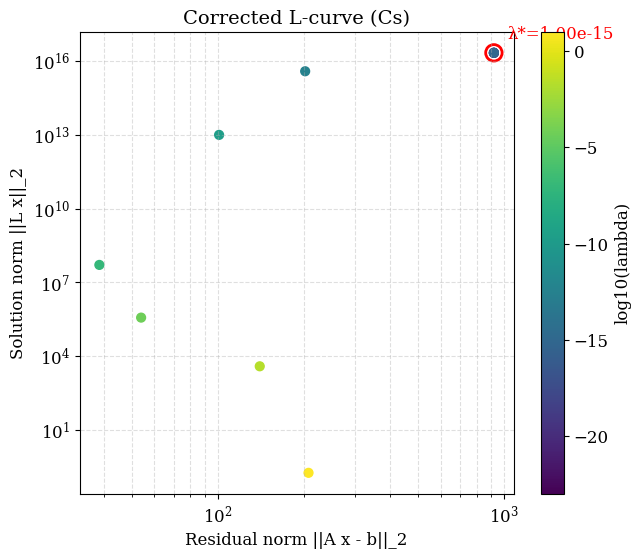

Tikhonov:   0%|          | 0/10 [00:00<?, ?it/s]

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.linalg import svd
from tqdm import tqdm

# ------------------------------------------------------------
# Function: tikhonov_l_curve_safe
# Purpose:  Solve the Tikhonov regularisation problem for a
#           range of lambda values and compute the residual
#           norm ||Ax-b|| and solution norm ||Lx||.
#
# Why:      This is needed to draw the "L-curve" and pick
#           the best lambda (regularisation strength).
# ------------------------------------------------------------
def tikhonov_l_curve_safe(A, b, lambdas, L=None):
    # Ensure float64
    A = A.astype(np.float64)
    b = b.astype(np.float64)
    m, n = A.shape
    # If no regularisation operator L is given, default to identity
    # this means "penalise the size of x itself" (classical Tikhonov).
    if L is None:
        L = np.eye(n, dtype=np.float64)
    else:
        L = L.astype(np.float64)

    # Precompute some common matrices for efficiency
    ATA = A.T @ A       # Gram matrix (normal equations)
    ATb = A.T @ b       # Projection of b onto A's space
    LTL = L.T @ L       # Regularisation penalty matrix

    # Prepare arrays to hold results for each lambda
    res = np.zeros(len(lambdas), dtype=np.float64)  # residual norms
    sol = np.zeros(len(lambdas), dtype=np.float64)  # solution norms
    Xs = []  # keep the actual solutions for later inspection if needed

    # Loop over all lambda values we want to test
    for i, lam in tqdm(list(enumerate(lambdas)), total=len(lambdas), desc="Tikhonov"):

        # Tikhonov minimisation problem:
        #   min_x ||Ax - b||^2 + (λ^2)||Lx||^2
        #
        # This leads to the normal equation:
        #   (A^T A + λ^2 L^T L)x = A^T b
        lhs = ATA + (lam**2) * LTL
        try:
           # Try direct solve (fast + exact if matrix well-conditioned)
            x_lam = np.linalg.solve(lhs, ATb)
        except np.linalg.LinAlgError:
            # fallback: use least squares with augmentation (more robust but slower)
            # [A; lam*L] x ≈ [b; 0]
            Aug = np.vstack([A, lam * L])
            rhs = np.concatenate([b, np.zeros(L.shape[0])])
            x_lam, *_ = np.linalg.lstsq(Aug, rhs, rcond=None)
        Xs.append(x_lam)
       # Compute norms for L-curve
        res[i] = np.linalg.norm(A @ x_lam - b)  # how well it fits the data
        sol[i] = np.linalg.norm(L @ x_lam)      # how "smooth" or "regular" it is
    return res, sol, Xs

# ------------------------------------------------------------
# Function: curvature_loglog
# Purpose:  Given the L-curve (residual vs solution norm),
#           compute the curvature to find the "corner".
#
# Why:      The "corner" balances data fit and regularisation.
#           Max curvature ≈ best lambda.
# ------------------------------------------------------------
def curvature_loglog(residuals, solutions):
    # compute curvature of curve (log(res), log(sol)) parametrized by index
    # central differences on logged coords
    xs = np.log(residuals)
    ys = np.log(solutions)
    # derivatives w.r.t parameter t (use index as t)
    t = np.arange(len(xs), dtype=float)
    dx = np.gradient(xs, t)
    dy = np.gradient(ys, t)
    ddx = np.gradient(dx, t)
    ddy = np.gradient(dy, t)
    # curvature k = |x'y'' - y'x''| / ( (x'^2 + y'^2)^(3/2) )
    num = np.abs(dx * ddy - dy * ddx)
    den = (dx**2 + dy**2)**1.5
    # avoid div by zero
    with np.errstate(divide='ignore', invalid='ignore'):
        k = np.where(den > 0, num / den, 0.0)
    return k

# ------------------------------------------------------------
# Function: plot_l_curve_and_corner
# Purpose:  Plot the L-curve with points coloured by log10(lambda),
#           and highlight the chosen optimal lambda.
# ------------------------------------------------------------
def plot_l_curve_and_corner(residuals, solutions, lambdas, title="L-curve"):
    plt.figure(figsize=(7,6))
    sc = plt.scatter(residuals, solutions, c=np.log10(lambdas), cmap='viridis', s=40)
    plt.xscale('log'); plt.yscale('log')
    plt.xlabel("Residual norm ||A x - b||_2")
    plt.ylabel("Solution norm ||L x||_2")
    plt.title(title)
    cbar = plt.colorbar(sc)
    cbar.set_label('log10(lambda)')
    plt.grid(True, which='both', ls='--', alpha=0.4)

# --- Usage example (plug into your existing data) ---
# choose sensible lambda range (based on typical scale of A)
# e.g., lambdas = np.logspace(-6, 2, 50)
lambdas = np.logspace(-10, 2,20)

residuals_cs, solutions_cs, Xs_cs = tikhonov_l_curve_safe(A_matrix_cs, b_cs, lambdas, L=None)
kappa_cs = curvature_loglog(residuals_cs, solutions_cs)
opt_idx_cs = np.nanargmax(kappa_cs)
opt_lambda_cs = lambdas[opt_idx_cs]
print(f"Optimal lambda (max curvature): {opt_lambda_cs:.3e} at index {opt_idx_cs}")

plot_l_curve_and_corner(residuals_cs, solutions_cs, lambdas, title="Corrected L-curve (Cs)")
# annotate the chosen corner
plt.scatter(residuals_cs[opt_idx_cs], solutions_cs[opt_idx_cs], s=140, facecolors='none', edgecolors='r', linewidths=2)
plt.annotate(f"λ*={opt_lambda_cs:.2e}", (residuals_cs[opt_idx_cs], solutions_cs[opt_idx_cs]),
             xytext=(10,10), textcoords='offset points', color='red')
plt.show()


residuals_co, solutions_co, Xs_co = tikhonov_l_curve_safe(A_matrix_co, b_co, lambdas, L=None)
kappa_co = curvature_loglog(residuals_co, solutions_co)
opt_idx_co = np.nanargmax(kappa_co)
opt_lambda_co = lambdas[opt_idx_co]
print(f"Optimal lambda (max curvature): {opt_lambda_co:.3e} at index {opt_idx_co}")

plot_l_curve_and_corner(residuals_co, solutions_co, lambdas, title="Corrected L-curve (Co)")
plt.scatter(residuals_co[opt_idx_co], solutions_co[opt_idx_co], s=140, facecolors='none', edgecolors='r', linewidths=2)
plt.annotate(f"λ*={opt_lambda_co:.2e}", (residuals_co[opt_idx_co], solutions_co[opt_idx_co]),
             xytext=(10,10), textcoords='offset points', color='red')
plt.show()


--- Plotting Tikhonov Reconstruction for Cesium (Cs) ---

Creating 2D terrain map with reconstruction overlay for Tikhonov L-Curve Reconstruction (Cs, λ*=2.81e-03) (Threshold: 0.0%) ...


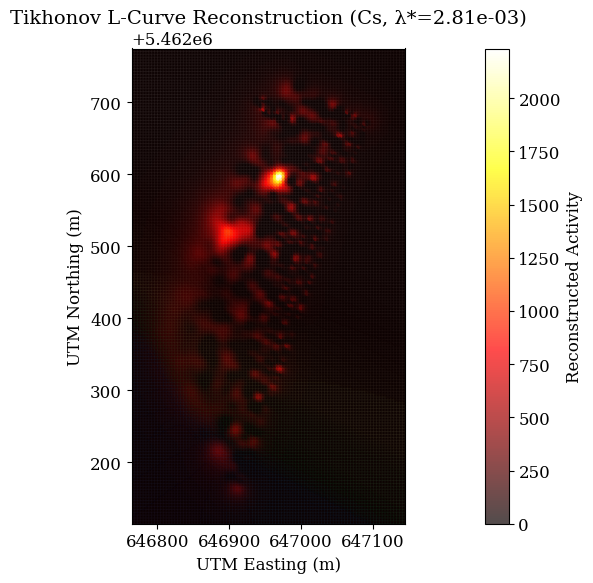


Creating side-by-side plot for Tikhonov L-Curve (Cs) ...


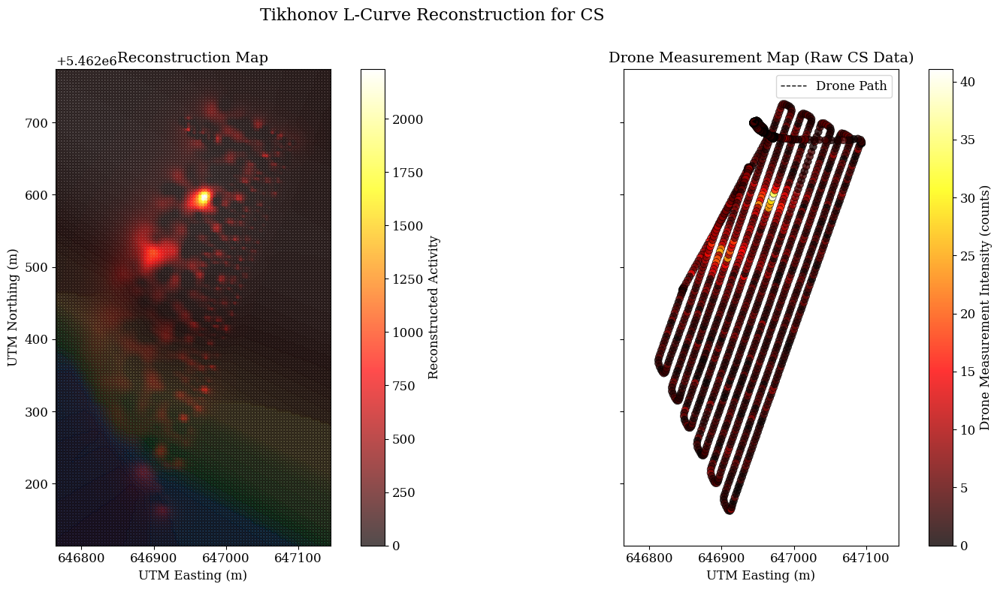


--- Plotting Tikhonov Reconstruction for Cobalt (Co) ---

Creating 2D terrain map with reconstruction overlay for Tikhonov L-Curve Reconstruction (Co, λ*=2.81e-03) (Threshold: 0.0%) ...


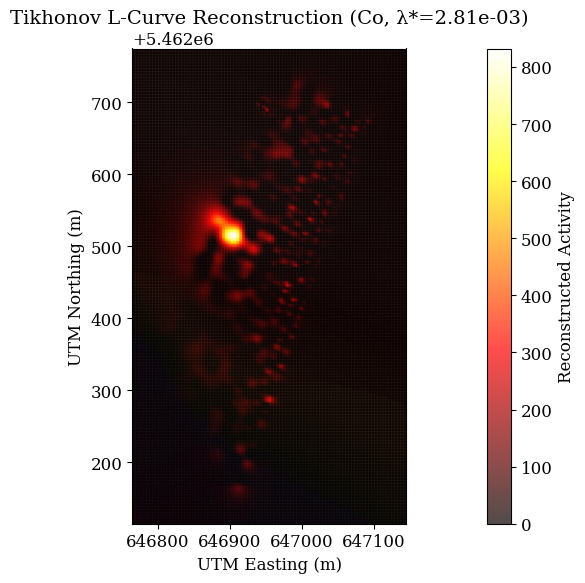


Creating side-by-side plot for Tikhonov L-Curve (Co) ...


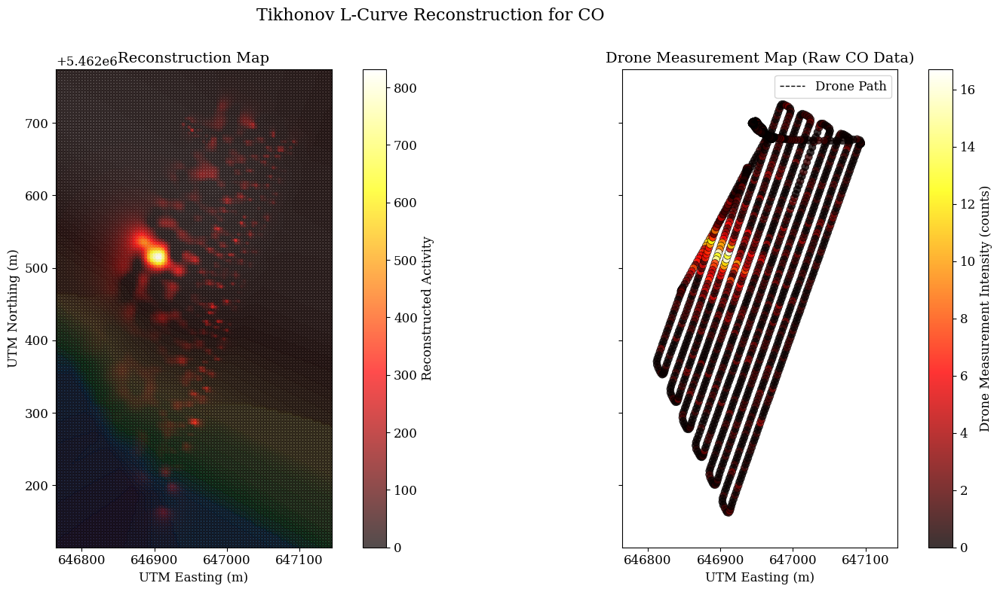

In [8]:
# --- Extract optimal solution vectors ---

# For Cesium
x_recon_tikhonov_cs = Xs_cs[18]

# For Cobalt
x_recon_tikhonov_co = Xs_co[18]


# --- Plotting the Tikhonov Reconstruction for Cesium ---
print("\n--- Plotting Tikhonov Reconstruction for Cesium (Cs) ---")
title_cs = f"Tikhonov L-Curve Reconstruction (Cs, λ*={opt_lambda_cs:.2e})"

# Plot the 2D reconstruction
plot_2d_reconstruction_on_terrain_map(x_recon_tikhonov_cs, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                      grid_points_for_reconstruction, title=title_cs)

# Plot the 3D interactive plot (requires plotly)
# Note: Ensure you are using the original, noiseless 'b_cs' for comparison in plots
plot_reconstruction_and_measurements_side_by_side(x_recon_tikhonov_cs, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                                  grid_points_for_reconstruction, detectors,
                                                  b_cs, "Tikhonov L-Curve", "Cs")

# --- Plotting the Tikhonov Reconstruction for Cobalt ---
print("\n--- Plotting Tikhonov Reconstruction for Cobalt (Co) ---")
title_co = f"Tikhonov L-Curve Reconstruction (Co, λ*={opt_lambda_co:.2e})"

# Plot the 2D reconstruction
plot_2d_reconstruction_on_terrain_map(x_recon_tikhonov_co, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                      grid_points_for_reconstruction, title=title_co)

# Plot the 3D interactive plot (requires plotly)
plot_reconstruction_and_measurements_side_by_side(x_recon_tikhonov_co, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                                  grid_points_for_reconstruction, detectors,
                                                  b_co, "Tikhonov L-Curve", "Co")


Creating side-by-side plot for Tikhonov L-Curve (Cs) ...


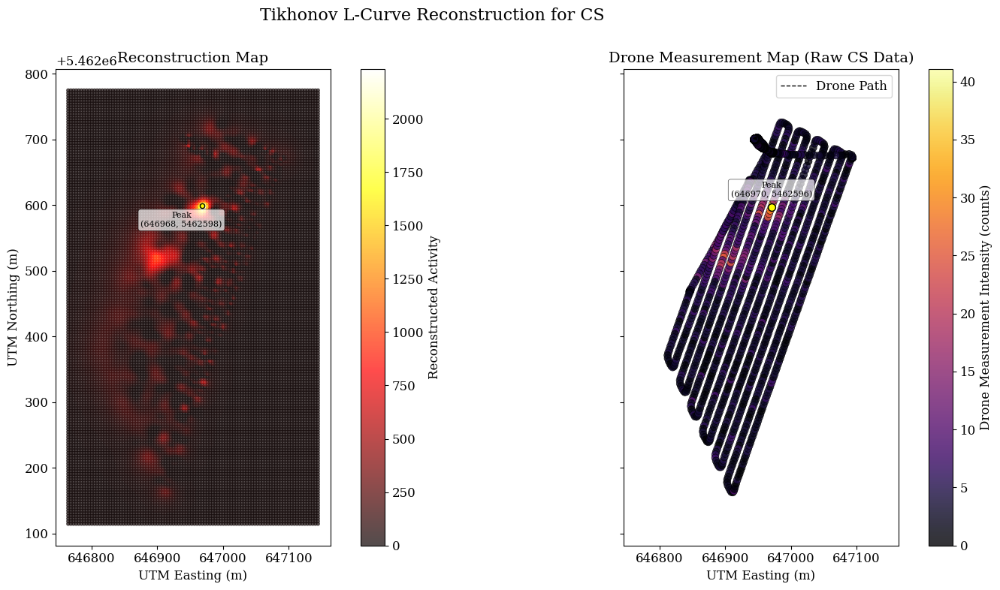


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646968.50, 5462598.50)
Measured Peak Location (UTM): (646970.38, 5462596.50)
Distance between peaks: 2.74 meters

Creating side-by-side plot for Tikhonov L-Curve (Co) ...


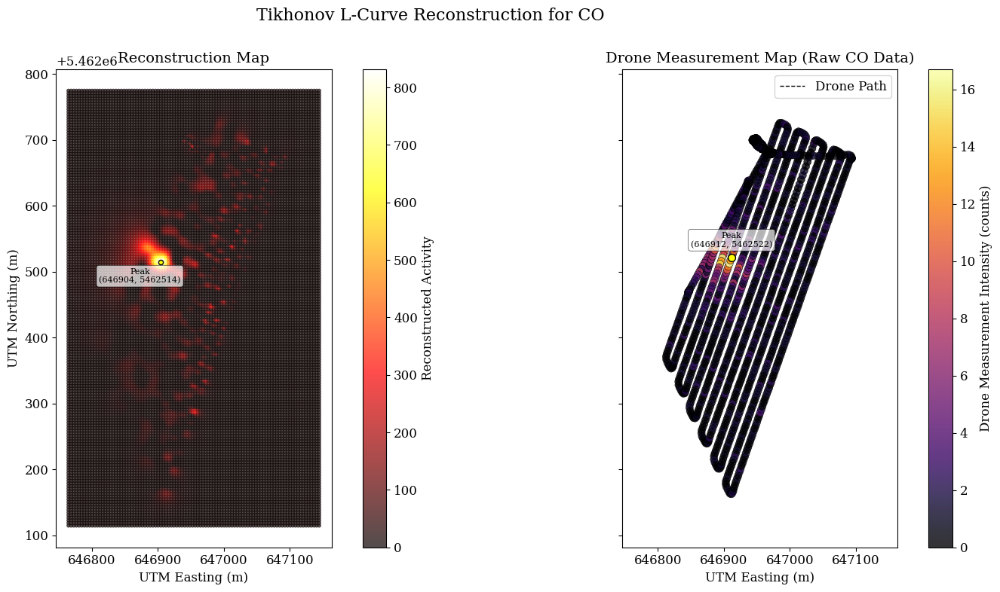


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646904.50, 5462514.50)
Measured Peak Location (UTM): (646911.75, 5462521.50)
Distance between peaks: 10.08 meters


In [11]:
def plot_reconstruction_and_measurements_side_by_side2(x_recon, xx_mesh, yy_mesh, Z_terrain,
                                                     grid_points_for_reconstruction, detectors,
                                                     b_values, algo_name, isotope_str,
                                                     threshold_percentage=0.0):
    print(f"\nCreating side-by-side plot for {algo_name} ({isotope_str}) ...")

    # Create the figure with two subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8), sharex=True, sharey=True)
    fig.suptitle(f"{algo_name} Reconstruction for {isotope_str.upper()}", fontsize=16)

    # --- Left Subplot: Reconstruction Map ---
    # Plot the terrain elevation as a background
    contour_levels = 50
    #ax1.contourf(xx_mesh, yy_mesh, Z_terrain, levels=contour_levels, cmap='terrain', alpha=0.8)

    # Plot the reconstructed activity
    x_recon_clamped_for_plot = np.maximum(0, x_recon.copy())
    if threshold_percentage > 0:
        max_intensity = np.max(x_recon_clamped_for_plot)
        if max_intensity > 0:
            threshold_val = (threshold_percentage / 100.0) * max_intensity
            x_recon_clamped_for_plot[x_recon_clamped_for_plot < threshold_val] = 0

    scatter_x = grid_points_for_reconstruction[:, 0]
    scatter_y = grid_points_for_reconstruction[:, 1]
    reconstruction_plot = ax1.scatter(scatter_x, scatter_y, c=x_recon_clamped_for_plot,
                                     cmap='hot', s=15, alpha=0.7, edgecolors='none')
    fig.colorbar(reconstruction_plot, ax=ax1, label="Reconstructed Activity", pad=0.05)

    # Find and plot the highest reconstruction point
    max_recon_idx = np.argmax(x_recon_clamped_for_plot)
    max_recon_loc = grid_points_for_reconstruction[max_recon_idx]
    ax1.scatter(max_recon_loc[0], max_recon_loc[1], s=20, marker='o', c='yellow', edgecolors='black', zorder=5)
    ax1.annotate(f"Peak\n({max_recon_loc[0]:.0f}, {max_recon_loc[1]:.0f})",
                 (max_recon_loc[0], max_recon_loc[1]),
                 textcoords="offset points", xytext=(-20,-20), ha='center', fontsize=8,
                 bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="black", lw=0.5, alpha=0.7))

    ax1.set_title("Reconstruction Map")
    ax1.set_xlabel("UTM Easting (m)")
    ax1.set_ylabel("UTM Northing (m)")
    ax1.set_aspect('equal', adjustable='box')

    # --- Right Subplot: Drone Measurements ---
    # Plot the terrain elevation as a background
    #ax2.contourf(xx_mesh, yy_mesh, Z_terrain, levels=contour_levels, cmap='terrain', alpha=0.8)

    # Plot the drone flight path
    ax2.plot(detectors[:, 0], detectors[:, 1], color='black', linestyle='--', linewidth=1, zorder=2, label='Drone Path')

    # Plot the "true hotspot" measurements from the drone
    scatter_drone = ax2.scatter(detectors[:, 0], detectors[:, 1],
                               c=b_values, cmap='inferno', s=50, alpha=0.8,
                               edgecolors='black', linewidth=0.5, zorder=3)

    # Find and plot the highest drone measurement point
    max_b_idx = np.argmax(b_values)
    max_b_loc = detectors[max_b_idx]
    ax2.scatter(max_b_loc[0], max_b_loc[1], s=50, marker='o', c='yellow', edgecolors='black', zorder=5)
    ax2.annotate(f"Peak\n({max_b_loc[0]:.0f}, {max_b_loc[1]:.0f})",
                 (max_b_loc[0], max_b_loc[1]),
                 textcoords="offset points", xytext=(0,10), ha='center', fontsize=8,
                 bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="black", lw=0.5, alpha=0.7))

    # Add a colorbar for the drone measurements
    fig.colorbar(scatter_drone, ax=ax2, label="Drone Measurement Intensity (counts)", pad=0.05)

    # Add arrow to indicate start of path
    if len(detectors) > 1:
        ax2.arrow(detectors[0, 0], detectors[0, 1],
                  detectors[1, 0] - detectors[0, 0], detectors[1, 1] - detectors[0, 1],
                  head_width=5, head_length=5, fc='black', ec='black', zorder=4)

    ax2.set_title(f"Drone Measurement Map (Raw {isotope_str.upper()} Data)")
    ax2.set_xlabel("UTM Easting (m)")
    ax2.set_aspect('equal', adjustable='box')
    ax2.legend()

    plt.tight_layout()
    plt.show()

    # --- Print the comparison ---
    print("\n--- Peak Location Comparison ---")
    print(f"Reconstructed Peak Location (UTM): ({max_recon_loc[0]:.2f}, {max_recon_loc[1]:.2f})")
    print(f"Measured Peak Location (UTM): ({max_b_loc[0]:.2f}, {max_b_loc[1]:.2f})")
    distance = np.linalg.norm(max_recon_loc[:2] - max_b_loc[:2])
    print(f"Distance between peaks: {distance:.2f} meters")

plot_reconstruction_and_measurements_side_by_side2(x_recon_tikhonov_cs, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                                  grid_points_for_reconstruction, detectors,
                                                  b_cs, "Tikhonov L-Curve", "Cs")

plot_reconstruction_and_measurements_side_by_side2(x_recon_tikhonov_co, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                                  grid_points_for_reconstruction, detectors,
                                                  b_co, "Tikhonov L-Curve", "Co")


# Tuning

In [ ]:
import numpy as np
from tqdm import tqdm

def kaczmarz_basic_tuned(detectors, grid_points, b, A_matrix, n_iter=100, omega=1.0, isotope_str="cs"):
    """
    Basic cyclic Kaczmarz with relaxation parameter omega and fixed number of iterations.
    """
    x, m, n, _, _ = _kaczmarz_base(detectors, grid_points, b, isotope=isotope_str)
    residuals_per_iteration = []

    for _ in tqdm(range(n_iter), desc=f"Basic Kaczmarz ω={omega}"):
        for i in range(m):
            A_i = A_matrix[i, :]
            Ai_norm_sq = np.sum(A_i**2)
            if Ai_norm_sq == 0:
                continue
            residual = b[i] - A_i @ x
            x += omega * (residual / Ai_norm_sq) * A_i.flatten()
            x = np.maximum(0, x)
        residuals_per_iteration.append(calculate_system_residual(x, b, A_matrix))

    return x, np.array(residuals_per_iteration)


def tune_kaczmarz(detectors, grid_points, b, A_matrix, omega_list, n_iter_list, isotope_str="cs"):
    """
    Grid search over omega and n_iter to find best combination.
    """
    best_residual = np.inf
    best_omega = None
    best_n_iter = None
    best_x = None

    for omega in omega_list:
        for n_iter in n_iter_list:
            x, _ = kaczmarz_basic_tuned(detectors, grid_points, b, A_matrix, n_iter=n_iter, omega=omega, isotope_str=isotope_str)
            res = calculate_system_residual(x, b, A_matrix)

            if res < best_residual:
                best_residual = res
                best_omega = omega
                best_n_iter = n_iter
                best_x = x.copy()

    print(f"Best omega = {best_omega}, best n_iter = {best_n_iter}, residual = {best_residual:.6f}")
    return best_x, best_omega, best_n_iter, best_residual


# -----------------------------
# Example usage
# -----------------------------
omega_candidates = np.linspace(0.1, 1.5, 15)      # Relaxation parameters
n_iter_candidates = [50, 100, 200, 400]           # Number of full cycles

best_x, best_omega, best_n_iter, best_residual = tune_kaczmarz(
    detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs,
    omega_candidates, n_iter_candidates, isotope_str="cs"
)

# Run final Kaczmarz with best parameters
final_solution, residuals = kaczmarz_basic_tuned(
    detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs,
    n_iter=best_n_iter, omega=best_omega, isotope_str="cs"
)


Basic Kaczmarz ω=1.5: 100%|██████████| 400/400 [04:40<00:00,  1.43it/s]


Best omega = 0.1, best n_iter = 400, residual = 77.406494


Basic Kaczmarz ω=0.1: 100%|██████████| 400/400 [04:45<00:00,  1.40it/s]



Creating side-by-side plot for Tuned Kaczmarz (Cs, ω=0.10, n_iter=400) (cs) ...


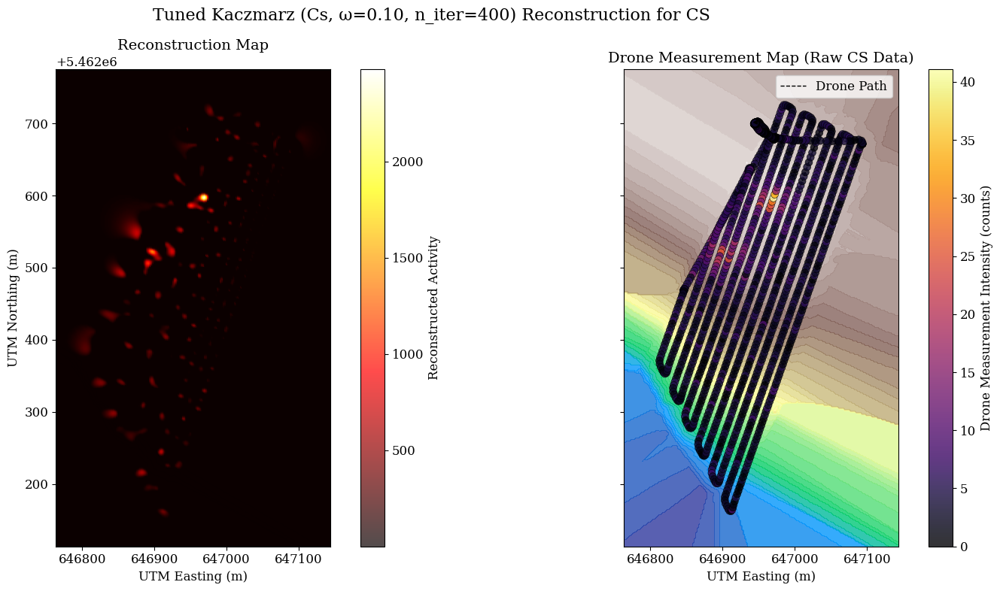

In [ ]:
# Plot the results of the best Kaczmarz run
plot_reconstruction_and_measurements_side_by_side(
    final_solution,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    f"Tuned Kaczmarz (Cs, ω={best_omega:.2f}, n_iter={best_n_iter})",
    "cs"
)

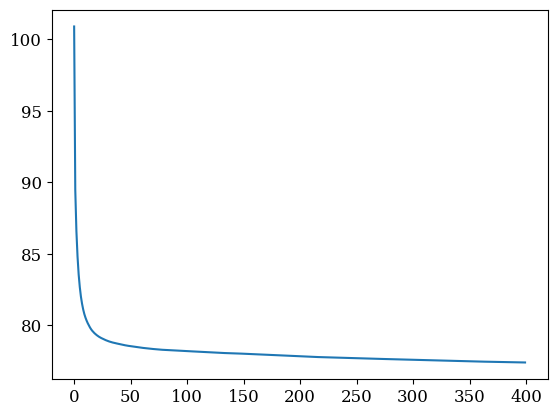

In [ ]:
plt.plot(residuals, label=f"Tuned Kaczmarz (ω={best_omega:.2f}, n_iter={best_n_iter})")


--- Running Kaczmarz for different omega values (400 iterations) ---

Running with omega = 0.01


Basic Kaczmarz ω=0.01: 100%|██████████| 400/400 [05:12<00:00,  1.28it/s]



Running with omega = 0.02


Basic Kaczmarz ω=0.020000000000000004: 100%|██████████| 400/400 [04:41<00:00,  1.42it/s]



Running with omega = 0.03


Basic Kaczmarz ω=0.030000000000000006: 100%|██████████| 400/400 [04:41<00:00,  1.42it/s]



Running with omega = 0.04


Basic Kaczmarz ω=0.04000000000000001: 100%|██████████| 400/400 [04:41<00:00,  1.42it/s]



Running with omega = 0.05


Basic Kaczmarz ω=0.05000000000000001: 100%|██████████| 400/400 [04:41<00:00,  1.42it/s]



Running with omega = 0.06


Basic Kaczmarz ω=0.06000000000000001: 100%|██████████| 400/400 [04:40<00:00,  1.42it/s]



Running with omega = 0.07


Basic Kaczmarz ω=0.07: 100%|██████████| 400/400 [04:40<00:00,  1.43it/s]



Running with omega = 0.08


Basic Kaczmarz ω=0.08: 100%|██████████| 400/400 [04:42<00:00,  1.42it/s]



Running with omega = 0.09


Basic Kaczmarz ω=0.09000000000000001: 100%|██████████| 400/400 [04:39<00:00,  1.43it/s]



Running with omega = 0.10


Basic Kaczmarz ω=0.1: 100%|██████████| 400/400 [04:39<00:00,  1.43it/s]


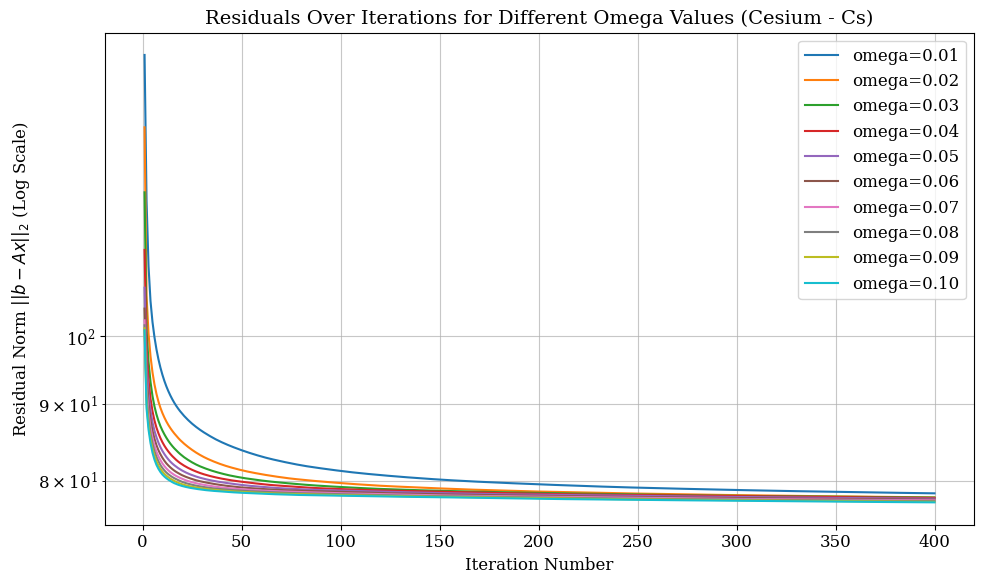

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

# Make sure kaczmarz_basic_tuned and calculate_system_residual are defined in previous cells

omega_values = np.linspace(0.01, 0.1, 10) # Omega values from 0.01 to 0.1 (10 values)
n_iterations = 400

residuals_data = {}

print(f"\n--- Running Kaczmarz for different omega values ({n_iterations} iterations) ---")

for omega in omega_values:
    print(f"\nRunning with omega = {omega:.2f}")
    # Assuming b_cs and A_matrix_cs are available from previous cells
    x_recon, residuals = kaczmarz_basic_tuned(
        detectors,
        grid_points_for_reconstruction,
        b_cs,
        A_matrix_cs,
        n_iter=n_iterations,
        omega=omega,
        isotope_str="cs"
    )
    residuals_data[f'omega={omega:.2f}'] = residuals

# Plot residuals for all omega values
plt.figure(figsize=(10, 6))
for label, residuals in residuals_data.items():
    plt.plot(np.arange(1, n_iterations + 1), residuals, label=label)

plt.xlabel("Iteration Number")
plt.ylabel("Residual Norm $||b - Ax||_2$ (Log Scale)")
plt.title("Residuals Over Iterations for Different Omega Values (Cesium - Cs)")
plt.yscale('log')
plt.legend()
plt.grid(True, which="both", ls="-", alpha=0.7)
plt.tight_layout()
plt.show()

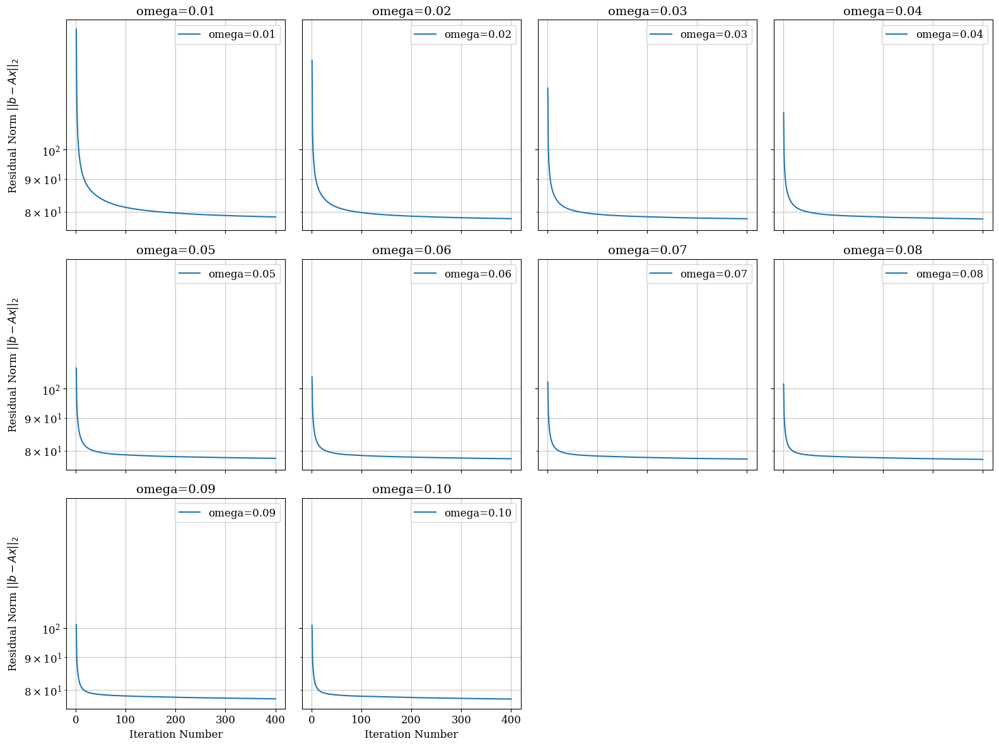

In [ ]:
import math
# Number of plots
n_plots = len(residuals_data)
n_cols = math.ceil(np.sqrt(n_plots))
n_rows = math.ceil(n_plots / n_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(4*n_cols, 4*n_rows), sharex=True, sharey=True)
axes = axes.flatten()

for idx, (label, residuals) in enumerate(residuals_data.items()):
    ax = axes[idx]
    ax.plot(np.arange(1, n_iterations + 1), residuals, label=label)
    ax.set_title(label)
    ax.set_yscale('log')
    ax.grid(True, which="both", ls="-", alpha=0.7)
    if idx % n_cols == 0:
        ax.set_ylabel("Residual Norm $||b - Ax||_2$")
    if idx >= (n_rows - 1) * n_cols:
        ax.set_xlabel("Iteration Number")
    ax.legend()

# Hide unused subplots
for j in range(idx+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

Basic Kaczmarz ω=1.5: 100%|██████████| 400/400 [04:42<00:00,  1.42it/s]


Best omega = 0.1, best n_iter = 400, residual = 38.055088


Basic Kaczmarz ω=0.1: 100%|██████████| 400/400 [04:40<00:00,  1.43it/s]



Creating side-by-side plot for Tuned Kaczmarz (Co, ω=0.10, n_iter=400) (co) ...


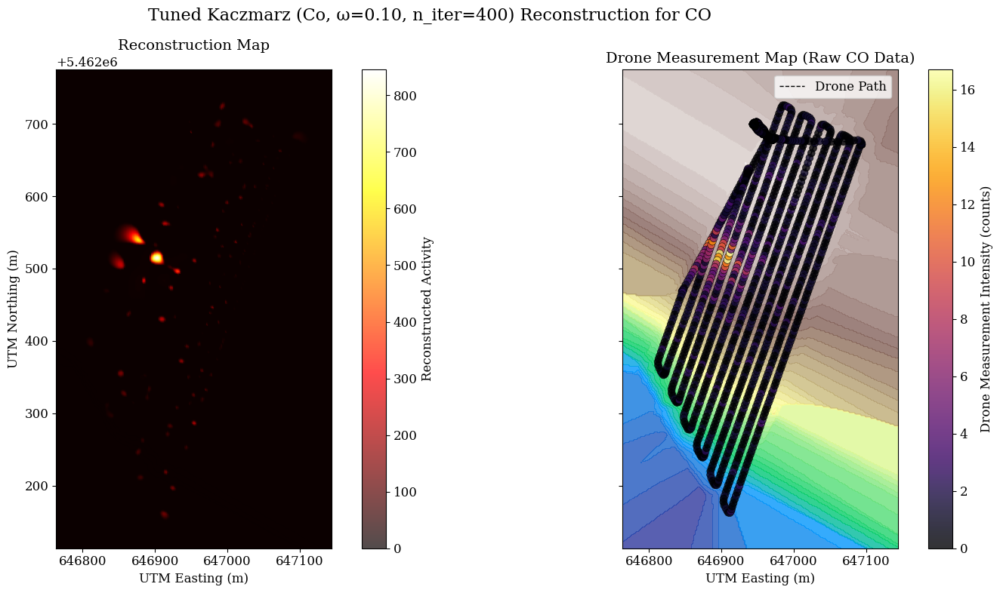

In [ ]:
omega_candidates = np.linspace(0.1, 1.5, 15)      # Relaxation parameters
n_iter_candidates = [50, 100, 200, 400]           # Number of full cycles

best_x_co, best_omega_co, best_n_iter_co, best_residual_co = tune_kaczmarz(
    detectors, grid_points_for_reconstruction, b_co, A_matrix_co,
    omega_candidates, n_iter_candidates, isotope_str="co"
)

# Run final Kaczmarz with best parameters
final_solution_co, residuals_co = kaczmarz_basic_tuned(
    detectors, grid_points_for_reconstruction, b_co, A_matrix_co,
    n_iter=best_n_iter_co, omega=best_omega_co, isotope_str="co"
)

# Plot the results of the best Kaczmarz run
plot_reconstruction_and_measurements_side_by_side(
    final_solution_co,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    f"Tuned Kaczmarz (Co, ω={best_omega:.2f}, n_iter={best_n_iter})",
    "co"
)


Creating side-by-side plot for Tikhonov L-Curve (Cs) ...


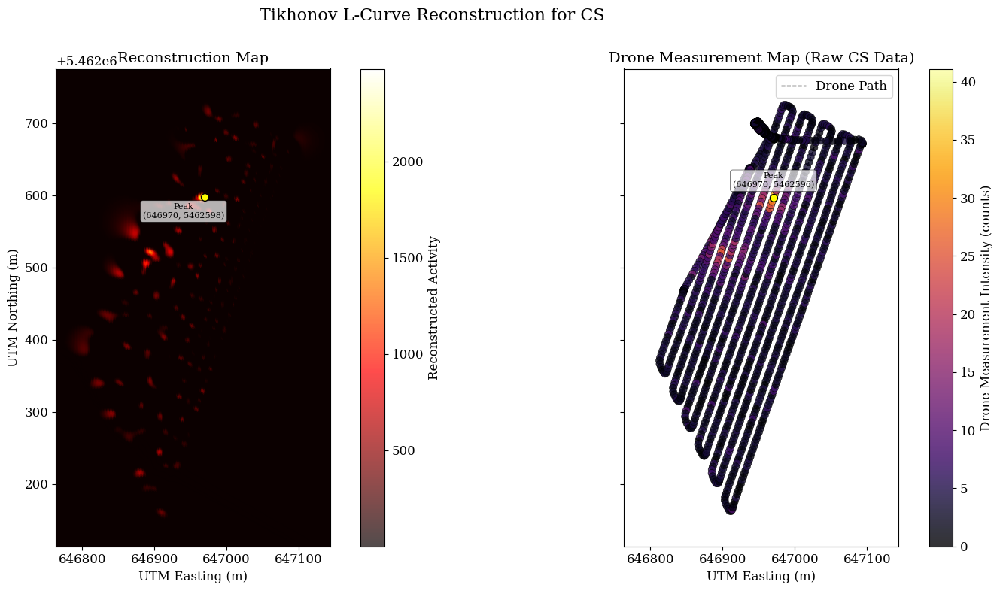


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646969.50, 5462597.50)
Measured Peak Location (UTM): (646970.38, 5462596.50)
Distance between peaks: 1.33 meters

Creating side-by-side plot for Tikhonov L-Curve (Co) ...


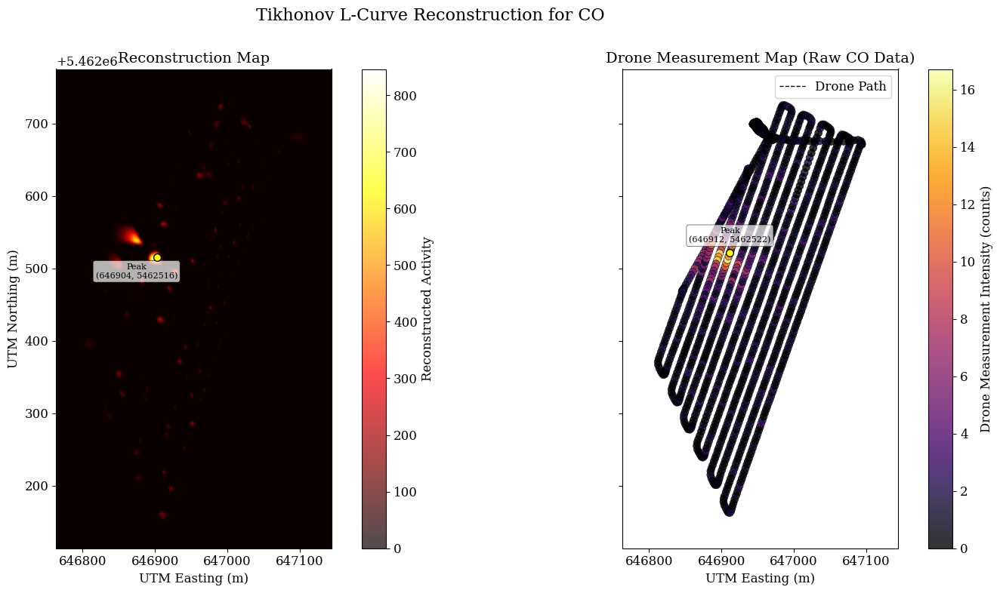


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646903.50, 5462515.50)
Measured Peak Location (UTM): (646911.75, 5462521.50)
Distance between peaks: 10.20 meters


In [ ]:
def plot_reconstruction_and_measurements_side_by_side2(x_recon, xx_mesh, yy_mesh, Z_terrain,
                                                     grid_points_for_reconstruction, detectors,
                                                     b_values, algo_name, isotope_str,
                                                     threshold_percentage=0.0):
    print(f"\nCreating side-by-side plot for {algo_name} ({isotope_str}) ...")

    # Create the figure with two subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8), sharex=True, sharey=True)
    fig.suptitle(f"{algo_name} Reconstruction for {isotope_str.upper()}", fontsize=16)

    # --- Left Subplot: Reconstruction Map ---
    # Plot the terrain elevation as a background
    contour_levels = 50
    ax1.contourf(xx_mesh, yy_mesh, Z_terrain, levels=contour_levels, cmap='terrain', alpha=0.8)

    scatter_x = grid_points_for_reconstruction[:, 0]
    scatter_y = grid_points_for_reconstruction[:, 1]
    reconstruction_plot = ax1.scatter(scatter_x, scatter_y, c=x_recon,
                                     cmap='hot', s=50, alpha=0.7, edgecolors='none')
    fig.colorbar(reconstruction_plot, ax=ax1, label="Reconstructed Activity", pad=0.05)

    # Find and plot the highest reconstruction point
    max_recon_idx = np.argmax(x_recon)
    max_recon_loc = grid_points_for_reconstruction[max_recon_idx]
    ax1.scatter(max_recon_loc[0], max_recon_loc[1], s=50, marker='o', c='yellow', edgecolors='black', zorder=5)
    ax1.annotate(f"Peak\n({max_recon_loc[0]:.0f}, {max_recon_loc[1]:.0f})",
                 (max_recon_loc[0], max_recon_loc[1]),
                 textcoords="offset points", xytext=(-20,-20), ha='center', fontsize=8,
                 bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="black", lw=0.5, alpha=0.7))

    ax1.set_title("Reconstruction Map")
    ax1.set_xlabel("UTM Easting (m)")
    ax1.set_ylabel("UTM Northing (m)")
    ax1.set_aspect('equal', adjustable='box')

    # --- Right Subplot: Drone Measurements ---
    # Plot the terrain elevation as a background
    #ax2.contourf(xx_mesh, yy_mesh, Z_terrain, levels=contour_levels, cmap='terrain', alpha=0.8)

    # Plot the drone flight path
    ax2.plot(detectors[:, 0], detectors[:, 1], color='black', linestyle='--', linewidth=1, zorder=2, label='Drone Path')

    # Plot the "true hotspot" measurements from the drone
    scatter_drone = ax2.scatter(detectors[:, 0], detectors[:, 1],
                               c=b_values, cmap='inferno', s=50, alpha=0.8,
                               edgecolors='black', linewidth=0.5, zorder=3)

    # Find and plot the highest drone measurement point
    max_b_idx = np.argmax(b_values)
    max_b_loc = detectors[max_b_idx]
    ax2.scatter(max_b_loc[0], max_b_loc[1], s=50, marker='o', c='yellow', edgecolors='black', zorder=5)
    ax2.annotate(f"Peak\n({max_b_loc[0]:.0f}, {max_b_loc[1]:.0f})",
                 (max_b_loc[0], max_b_loc[1]),
                 textcoords="offset points", xytext=(0,10), ha='center', fontsize=8,
                 bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="black", lw=0.5, alpha=0.7))

    # Add a colorbar for the drone measurements
    fig.colorbar(scatter_drone, ax=ax2, label="Drone Measurement Intensity (counts)", pad=0.05)

    # Add arrow to indicate start of path
    if len(detectors) > 1:
        ax2.arrow(detectors[0, 0], detectors[0, 1],
                  detectors[1, 0] - detectors[0, 0], detectors[1, 1] - detectors[0, 1],
                  head_width=5, head_length=5, fc='black', ec='black', zorder=4)

    ax2.set_title(f"Drone Measurement Map (Raw {isotope_str.upper()} Data)")
    ax2.set_xlabel("UTM Easting (m)")
    ax2.set_aspect('equal', adjustable='box')
    ax2.legend()

    plt.tight_layout()
    plt.show()

    # --- Print the comparison ---
    print("\n--- Peak Location Comparison ---")
    print(f"Reconstructed Peak Location (UTM): ({max_recon_loc[0]:.2f}, {max_recon_loc[1]:.2f})")
    print(f"Measured Peak Location (UTM): ({max_b_loc[0]:.2f}, {max_b_loc[1]:.2f})")
    distance = np.linalg.norm(max_recon_loc[:2] - max_b_loc[:2])
    print(f"Distance between peaks: {distance:.2f} meters")

plot_reconstruction_and_measurements_side_by_side2(final_solution, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                                  grid_points_for_reconstruction, detectors,
                                                  b_cs, "Tikhonov L-Curve", "Cs")

plot_reconstruction_and_measurements_side_by_side2(final_solution_co, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                                  grid_points_for_reconstruction, detectors,
                                                  b_co, "Tikhonov L-Curve", "Co")


## Same for Symmetric Kaczmarz

Upsweep Kaczmarz NN (CS) Iterations: 100%|██████████| 400/400 [08:52<00:00,  1.33s/it]


[Upsweep] Best omega = 0.1, best n_iter = 400, residual = 80.841370


Upsweep Kaczmarz NN (CS) Iterations: 100%|██████████| 400/400 [08:55<00:00,  1.34s/it]



Creating side-by-side plot for Tuned Upsweep Kaczmarz (Cs, ω=0.10, n_iter=400) (cs) ...


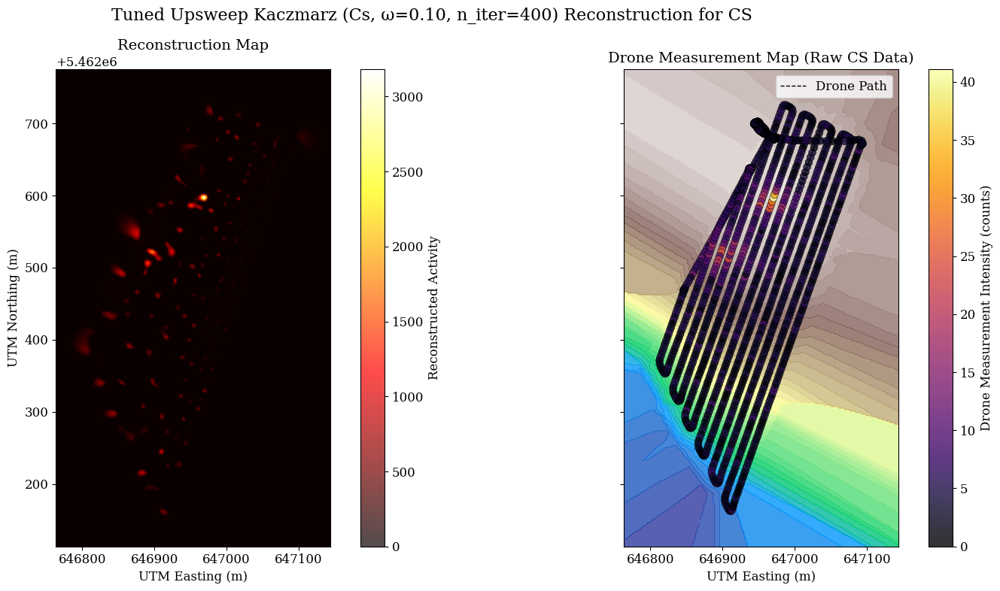

Upsweep Kaczmarz NN (CO) Iterations: 100%|██████████| 400/400 [08:32<00:00,  1.28s/it]


[Upsweep] Best omega = 0.1, best n_iter = 400, residual = 40.344151


Upsweep Kaczmarz NN (CO) Iterations: 100%|██████████| 400/400 [08:32<00:00,  1.28s/it]



Creating side-by-side plot for Tuned Upsweep Kaczmarz (Co, ω=0.10, n_iter=400) (co) ...


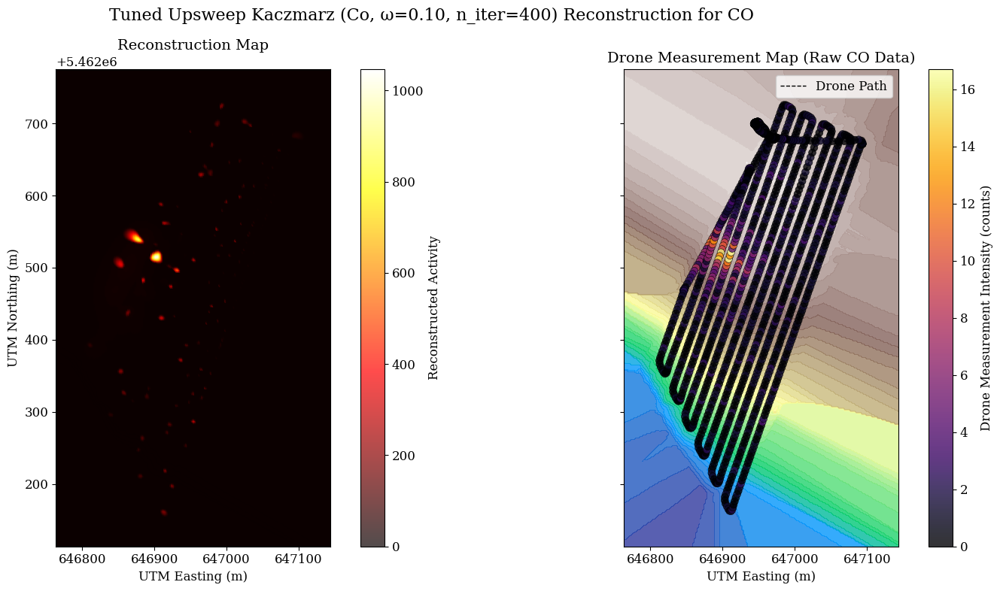

In [ ]:
def kaczmarz_symmetric(detectors, grid_points, b, A_matrix, n_iter=100, omega = 1.0, isotope_str="cs"):
    x, m, n, _, _ = _kaczmarz_base(detectors, grid_points, b, isotope=isotope_str)
    residuals_per_iteration = []
    for it in tqdm(range(n_iter), desc=f"Upsweep Kaczmarz NN ({isotope_str.upper()}) Iterations"):
        for i in range(m): # Forward sweep
            A_i = A_matrix[i, :]
            A_i_norm_sq = np.sum(A_i**2)
            if A_i_norm_sq == 0: continue
            residual = b[i] - A_i @ x
            x += omega * (residual / A_i_norm_sq) * A_i
            x = np.maximum(0, x)
        for i in range(m - 1, -1, -1): # Backward sweep
            A_i = A_matrix[i, :]
            A_i_norm_sq = np.sum(A_i**2)
            if A_i_norm_sq == 0: continue
            residual = b[i] - A_i @ x
            x += omega * (residual / A_i_norm_sq) * A_i
            x = np.maximum(0, x)
        residuals_per_iteration.append(calculate_system_residual(x, b, A_matrix))
    return x, np.array(residuals_per_iteration)

import numpy as np
from tqdm import tqdm

def tune_kaczmarz_symmetric(detectors, grid_points, b, A_matrix, omega_list, n_iter_list, isotope_str="cs"):
    """
    Grid search over omega and n_iter to find the best combination
    for the Upsweep Kaczmarz algorithm.
    """
    best_residual = np.inf
    best_omega = None
    best_n_iter = None
    best_x = None

    for omega in omega_list:
        for n_iter in n_iter_list:
            # Run upsweep variant
            x, _ = kaczmarz_symmetric(
                detectors,
                grid_points,
                b,
                A_matrix,
                n_iter=n_iter,
                omega=omega,
                isotope_str=isotope_str
            )

            # Residual calculation
            res = calculate_system_residual(x, b, A_matrix)

            # Keep best solution
            if res < best_residual:
                best_residual = res
                best_omega = omega
                best_n_iter = n_iter
                best_x = x.copy()

    print(f"[Upsweep] Best omega = {best_omega}, best n_iter = {best_n_iter}, residual = {best_residual:.6f}")
    return best_x, best_omega, best_n_iter, best_residual



# ---- Parameter candidates ----
omega_candidates = np.linspace(0.1, 1.5, 15)      # Relaxation parameters
n_iter_candidates = [50, 100, 200, 400]           # Number of full cycles


# =========================
# ---- Cesium (Cs) ----
# =========================
best_x_cs, best_omega_cs, best_n_iter_cs, best_residual_cs = tune_kaczmarz_symmetric(
    detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs,
    omega_candidates, n_iter_candidates, isotope_str="cs"
)

# Run final upsweep Kaczmarz with best parameters
final_solution_cs, residuals_cs = kaczmarz_symmetric(
    detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs,
    n_iter=best_n_iter_cs, omega=best_omega_cs, isotope_str="cs"
)

# Plot results for Cs
plot_reconstruction_and_measurements_side_by_side(
    final_solution_cs,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    f"Tuned Upsweep Kaczmarz (Cs, ω={best_omega_cs:.2f}, n_iter={best_n_iter_cs})",
    "cs"
)


# ---- Cobalt (Co) ----

best_x_co, best_omega_co, best_n_iter_co, best_residual_co = tune_kaczmarz_symmetric(
    detectors, grid_points_for_reconstruction, b_co, A_matrix_co,
    omega_candidates, n_iter_candidates, isotope_str="co"
)

# Run final upsweep Kaczmarz with best parameters
final_solution_co, residuals_co = kaczmarz_symmetric(
    detectors, grid_points_for_reconstruction, b_co, A_matrix_co,
    n_iter=best_n_iter_co, omega=best_omega_co, isotope_str="co"
)

# Plot results for Co
plot_reconstruction_and_measurements_side_by_side(
    final_solution_co,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    f"Tuned Upsweep Kaczmarz (Co, ω={best_omega_co:.2f}, n_iter={best_n_iter_co})",
    "co"
)


Creating side-by-side plot for Tuned Upsweep Kaczmarz (Cs, ω=0.10, n_iter=400) (cs) ...


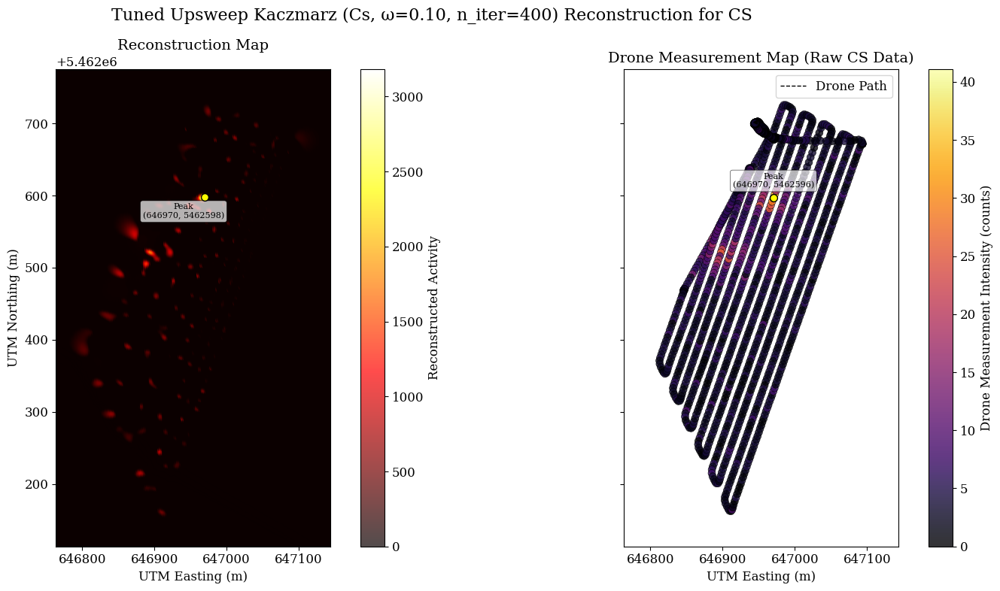


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646969.50, 5462597.50)
Measured Peak Location (UTM): (646970.38, 5462596.50)
Distance between peaks: 1.33 meters


In [ ]:
plot_reconstruction_and_measurements_side_by_side2(
    final_solution_cs,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    f"Tuned Upsweep Kaczmarz (Cs, ω={best_omega_cs:.2f}, n_iter={best_n_iter_cs})",
    "cs"
)


Creating side-by-side plot for Tuned Upsweep Kaczmarz (Co, ω=0.10, n_iter=400) (co) ...


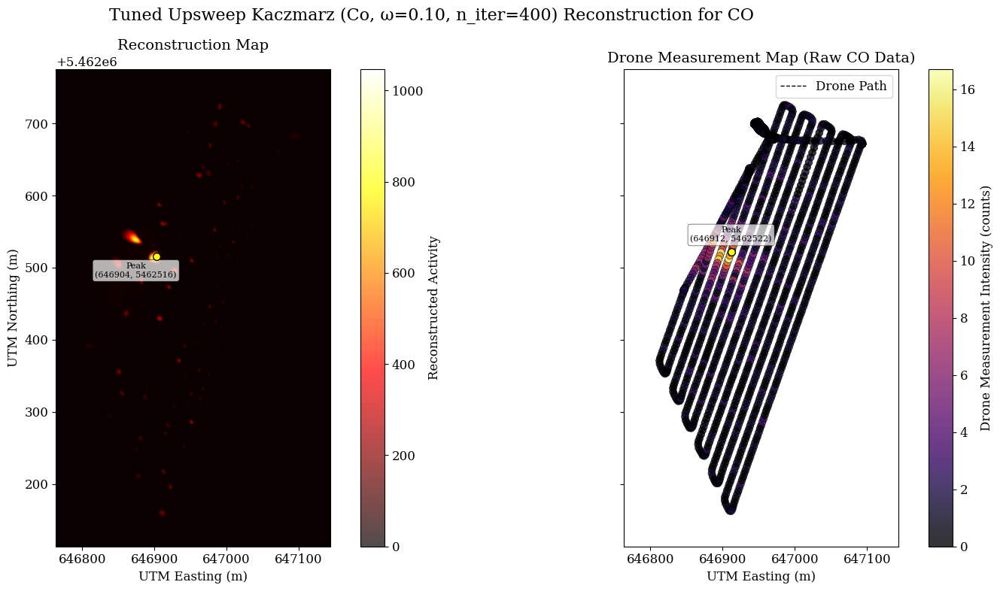


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646903.50, 5462515.50)
Measured Peak Location (UTM): (646911.75, 5462521.50)
Distance between peaks: 10.20 meters


In [ ]:
plot_reconstruction_and_measurements_side_by_side2(
    final_solution_co,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    f"Tuned Upsweep Kaczmarz (Co, ω={best_omega_co:.2f}, n_iter={best_n_iter_co})",
    "co"
)

# Running all algos on the go for A to get comparisons

Cyclic Kaczmarz NN Online (CO) Iterations: 100%|██████████| 100/100 [16:57<00:00, 10.18s/it]



Creating side-by-side plot for On the go A (Cs) ...


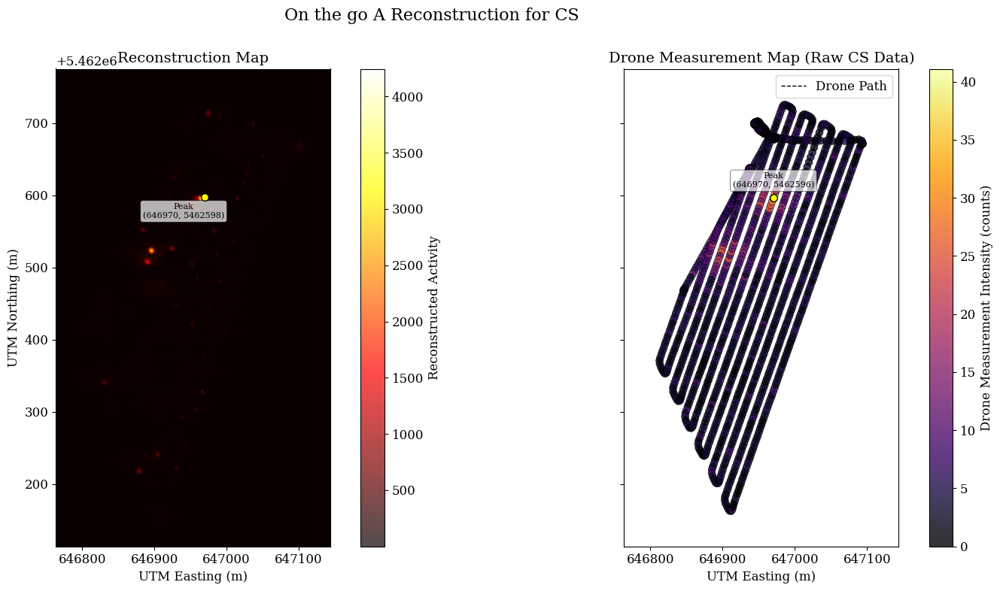


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646969.50, 5462597.50)
Measured Peak Location (UTM): (646970.38, 5462596.50)
Distance between peaks: 1.33 meters

Creating 2D terrain map with reconstruction overlay for 2D Reconstruction on Terrain (Threshold: 0.0%) ...


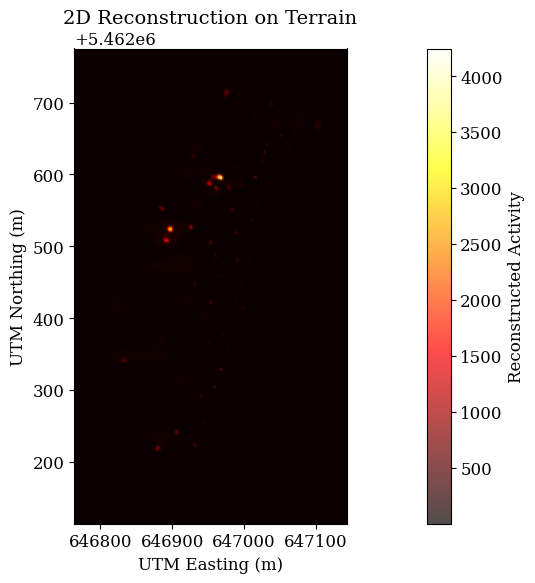


Creating side-by-side plot for On the go A (Co) ...


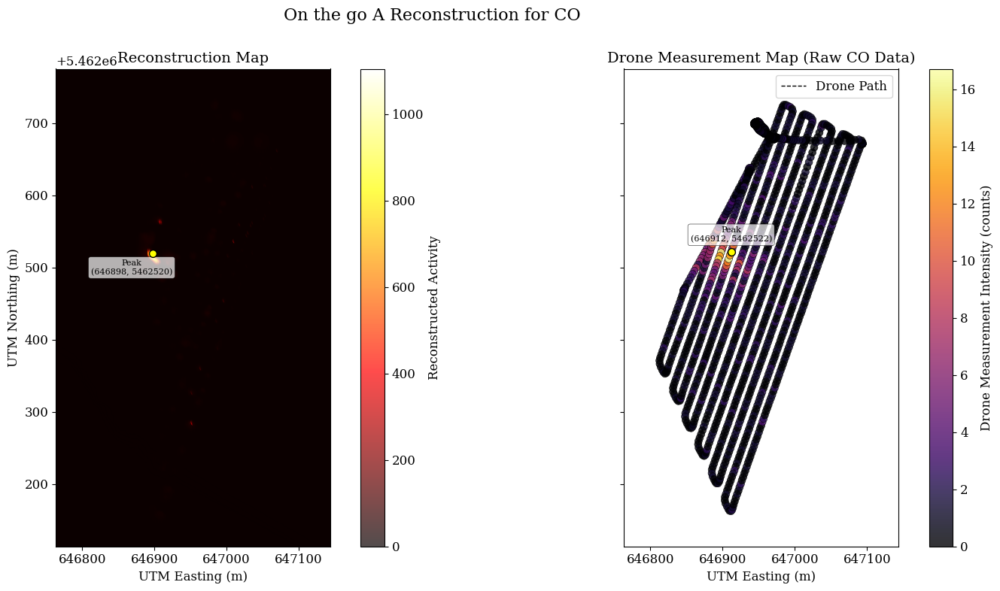


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646897.50, 5462519.50)
Measured Peak Location (UTM): (646911.75, 5462521.50)
Distance between peaks: 14.39 meters


In [6]:
def kaczmarz_cyclic_nn_online(detectors, grid_points, b, n_iter=100, isotope_str="cs"):
    x, m, n, emission_prob, mu_L = _kaczmarz_base(detectors, grid_points, b, isotope=isotope_str)
    residuals_per_iteration = []

    for it in tqdm(range(n_iter), desc=f"Cyclic Kaczmarz NN Online ({isotope_str.upper()}) Iterations"):
        for i in range(m):
            # Compute A_i on the go
            dists = np.linalg.norm(grid_points - detectors[i], axis=1) + 1e-6
            atten = np.exp(-mu_L * dists)
            A_i = emission_prob / (4 * np.pi * dists**2) * atten

            A_i_norm_sq = np.sum(A_i**2)
            if A_i_norm_sq == 0: continue

            residual = b[i] - A_i @ x
            x += (residual / A_i_norm_sq) * A_i
            x = np.maximum(0, x)

        # Compute residual using online calculation
        pred_b = np.zeros_like(b)
        for j in range(m):
            dists_j = np.linalg.norm(grid_points - detectors[j], axis=1) + 1e-6
            atten_j = np.exp(-mu_L * dists_j)
            A_j = emission_prob / (4 * np.pi * dists_j**2) * atten_j
            pred_b[j] = A_j @ x
        residuals_per_iteration.append(np.linalg.norm(b - pred_b))

    return x, np.array(residuals_per_iteration)


x_online_cyclic, res_cyclic_online = kaczmarz_cyclic_nn_online(detectors, grid_points_for_reconstruction, b_cs, n_iter=100, isotope_str="cs")
x_online_cyclic_co, res_cyclic_online_co = kaczmarz_cyclic_nn_online(detectors, grid_points_for_reconstruction, b_co, n_iter=100, isotope_str="co")

plot_reconstruction_and_measurements_side_by_side2(x_online_cyclic, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                                  grid_points_for_reconstruction, detectors,
                                                  b_cs, "On the go A", "Cs")
plot_2d_reconstruction_on_terrain_map(x_online_cyclic, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction)
plot_reconstruction_and_measurements_side_by_side2(x_online_cyclic_co, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                                  grid_points_for_reconstruction, detectors,
                                                  b_co, "On the go A", "Co")


Creating 2D terrain map with reconstruction overlay for 2D Reconstruction on Terrain (Threshold: 0.0%) ...


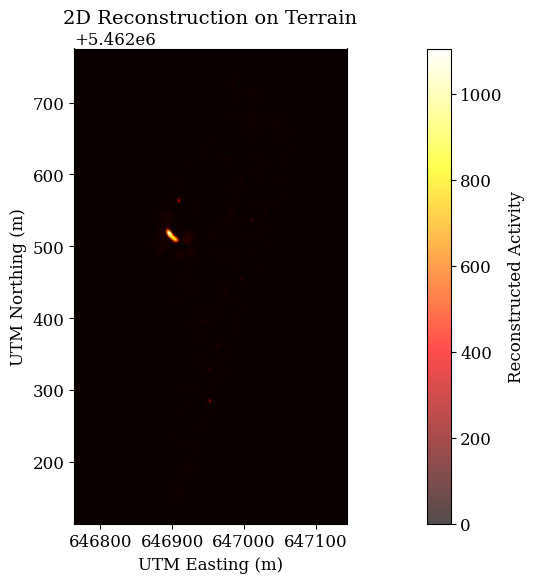

In [7]:
plot_2d_reconstruction_on_terrain_map(x_online_cyclic_co, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction)

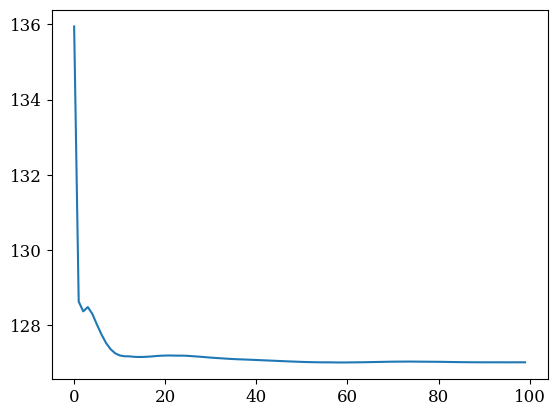

In [8]:
plt.plot(res_cyclic_online, label="Cyclic Kaczmarz NN Online (Cs)")


In [9]:
np.argmin(res_cyclic_online)

np.int64(59)

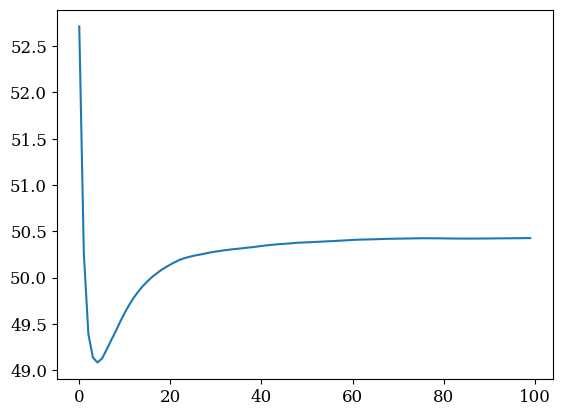

In [10]:
plt.plot(res_cyclic_online_co, label="Cyclic Kaczmarz NN Online (Co)")

In [11]:
np.argmin(res_cyclic_online_co)

np.int64(4)

In [12]:
res_cyclic_online[14]

np.float32(127.16046)

In [14]:
def kaczmarz_symmetric_nn_online(detectors, grid_points, b, n_iter=100, isotope_str="cs"):
    x, m, n, emission_prob, mu_L = _kaczmarz_base(detectors, grid_points, b, isotope=isotope_str)
    residuals_per_iteration = []

    for it in tqdm(range(n_iter), desc=f"Symmetric Kaczmarz NN Online ({isotope_str.upper()}) Iterations"):
        # Forward sweep
        for i in range(m):
            dists = np.linalg.norm(grid_points - detectors[i], axis=1) + 1e-6
            atten = np.exp(-mu_L * dists)
            A_i = emission_prob / (4 * np.pi * dists**2) * atten

            A_i_norm_sq = np.sum(A_i**2)
            if A_i_norm_sq == 0: continue

            residual = b[i] - A_i @ x
            x += (residual / A_i_norm_sq) * A_i
            x = np.maximum(0, x)

        # Backward sweep
        for i in range(m-1, -1, -1):
            dists = np.linalg.norm(grid_points - detectors[i], axis=1) + 1e-6
            atten = np.exp(-mu_L * dists)
            A_i = emission_prob / (4 * np.pi * dists**2) * atten

            A_i_norm_sq = np.sum(A_i**2)
            if A_i_norm_sq == 0: continue

            residual = b[i] - A_i @ x
            x += (residual / A_i_norm_sq) * A_i
            x = np.maximum(0, x)

        # Compute residual online
        pred_b = np.zeros_like(b)
        for j in range(m):
            dists_j = np.linalg.norm(grid_points - detectors[j], axis=1) + 1e-6
            atten_j = np.exp(-mu_L * dists_j)
            A_j = emission_prob / (4 * np.pi * dists_j**2) * atten_j
            pred_b[j] = A_j @ x
        residuals_per_iteration.append(np.linalg.norm(b - pred_b))

    return x, np.array(residuals_per_iteration)

Symmetric Kaczmarz NN Online (CO) Iterations: 100%|██████████| 100/100 [26:02<00:00, 15.62s/it]



Creating side-by-side plot for On the go A (Cs) ...


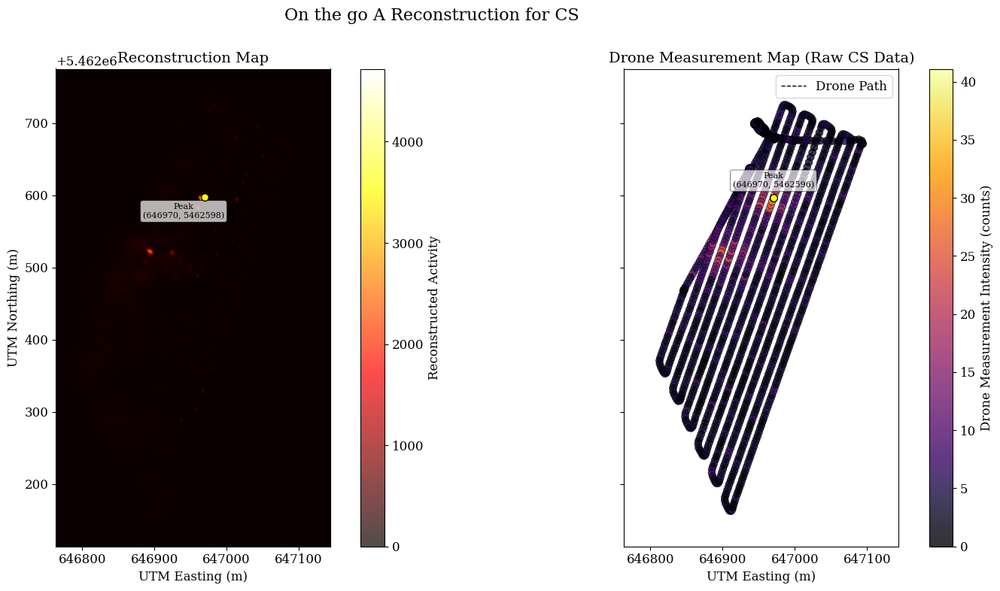


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646969.50, 5462597.50)
Measured Peak Location (UTM): (646970.38, 5462596.50)
Distance between peaks: 1.33 meters

Creating 2D terrain map with reconstruction overlay for 2D Reconstruction on Terrain (Threshold: 0.0%) ...


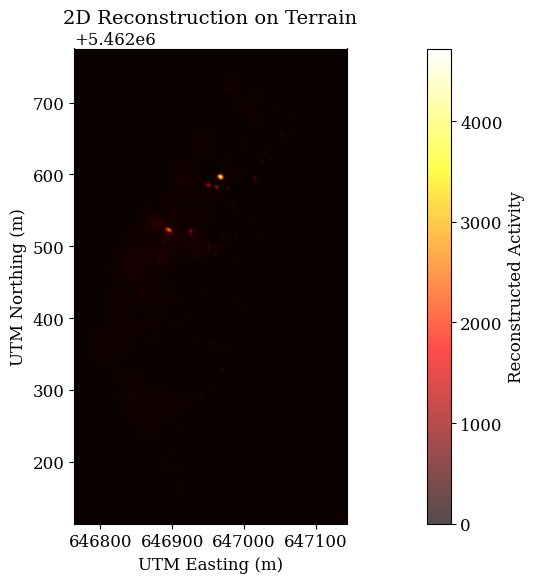


Creating side-by-side plot for On the go A (Co) ...


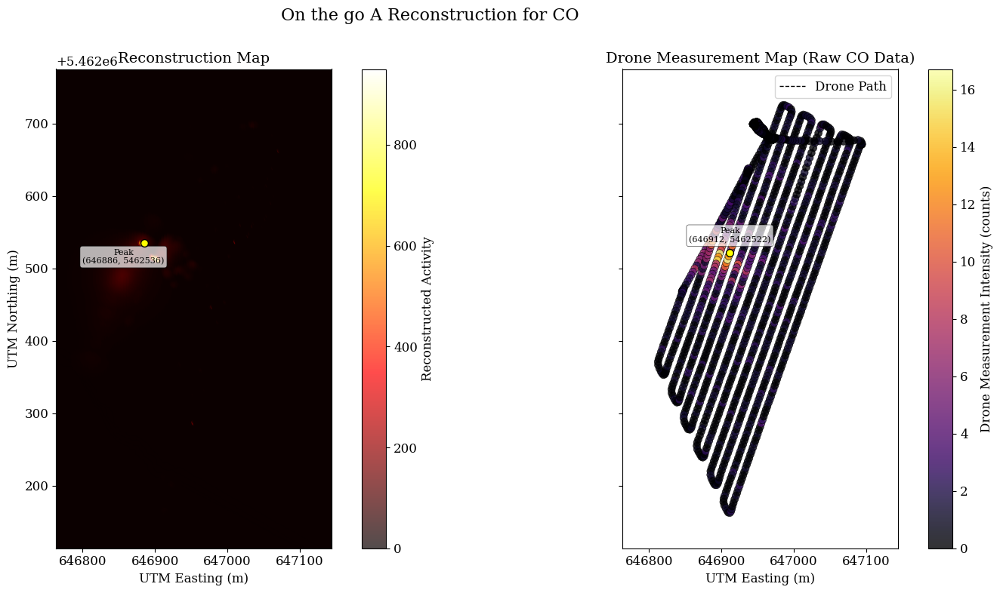


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646885.50, 5462535.50)
Measured Peak Location (UTM): (646911.75, 5462521.50)
Distance between peaks: 29.75 meters


In [15]:
x_online_symmetric, res_symmetric_online = kaczmarz_symmetric_nn_online(detectors, grid_points_for_reconstruction, b_cs, n_iter=100, isotope_str="cs")
x_online_symmetric_co, res_symmetric_online_co = kaczmarz_symmetric_nn_online(detectors, grid_points_for_reconstruction, b_co, n_iter=100, isotope_str="co")

plot_reconstruction_and_measurements_side_by_side2(x_online_symmetric, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                                  grid_points_for_reconstruction, detectors,
                                                  b_cs, "On the go A", "Cs")
plot_2d_reconstruction_on_terrain_map(x_online_symmetric, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction)
plot_reconstruction_and_measurements_side_by_side2(x_online_symmetric_co, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                                  grid_points_for_reconstruction, detectors,
                                                  b_co, "On the go A", "Co")

In [16]:
def kaczmarz_randomized_nn_online(detectors, grid_points, b, n_iter=100, isotope_str="cs"):
    x, m, n, emission_prob, mu_L = _kaczmarz_base(detectors, grid_points, b, isotope=isotope_str)
    residuals_per_iteration = []

    # Precompute row selection probabilities based on distances (optional weighting)
    row_weights = np.ones(m)  # equal weight by default
    row_probs = row_weights / np.sum(row_weights)

    for it in tqdm(range(n_iter), desc=f"Randomized Kaczmarz NN Online ({isotope_str.upper()}) Iterations"):
        for _ in range(m):
            i = np.random.choice(m, p=row_probs)

            dists = np.linalg.norm(grid_points - detectors[i], axis=1) + 1e-6
            atten = np.exp(-mu_L * dists)
            A_i = emission_prob / (4 * np.pi * dists**2) * atten

            A_i_norm_sq = np.sum(A_i**2)
            if A_i_norm_sq == 0: continue

            residual = b[i] - A_i @ x
            x += (residual / A_i_norm_sq) * A_i
            x = np.maximum(0, x)

        # Compute residual online
        pred_b = np.zeros_like(b)
        for j in range(m):
            dists_j = np.linalg.norm(grid_points - detectors[j], axis=1) + 1e-6
            atten_j = np.exp(-mu_L * dists_j)
            A_j = emission_prob / (4 * np.pi * dists_j**2) * atten_j
            pred_b[j] = A_j @ x
        residuals_per_iteration.append(np.linalg.norm(b - pred_b))

    return x, np.array(residuals_per_iteration)


Randomized Kaczmarz NN Online (CO) Iterations: 100%|██████████| 100/100 [17:37<00:00, 10.58s/it]



Creating side-by-side plot for On the go A (Cs) ...


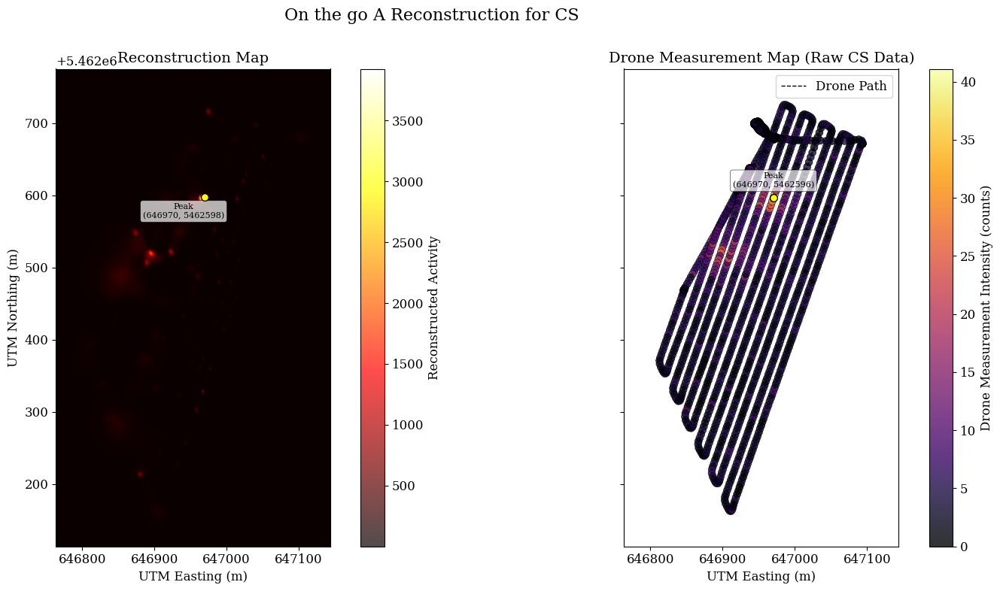


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646969.50, 5462597.50)
Measured Peak Location (UTM): (646970.38, 5462596.50)
Distance between peaks: 1.33 meters

Creating 2D terrain map with reconstruction overlay for 2D Reconstruction on Terrain (Threshold: 0.0%) ...


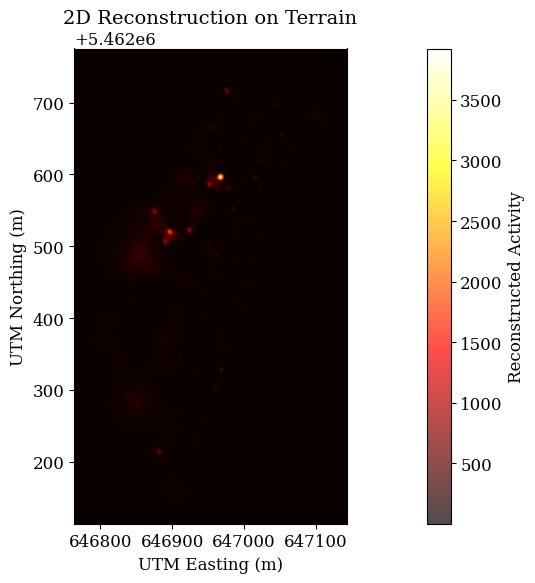


Creating side-by-side plot for On the go A (Co) ...


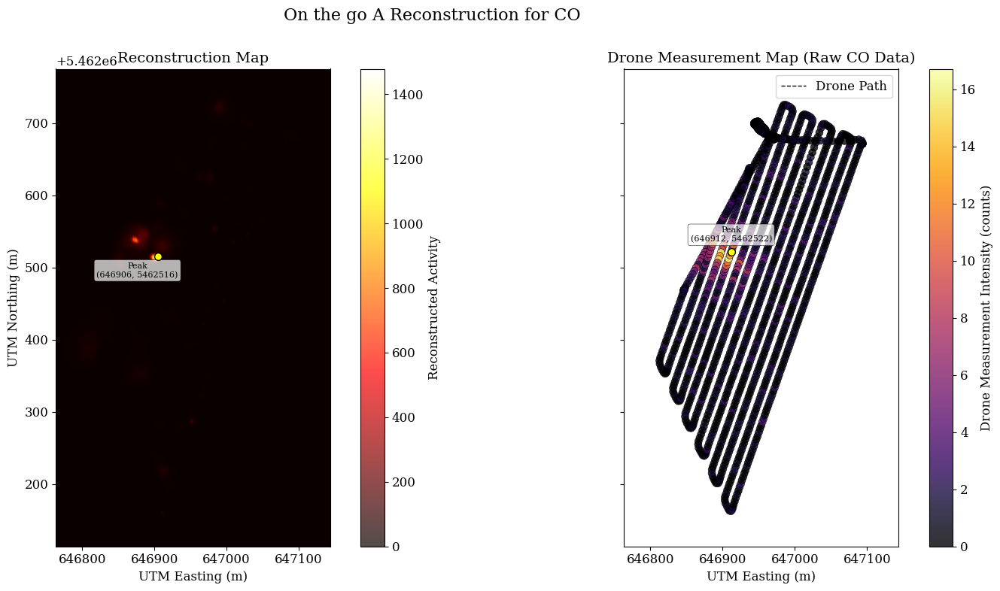


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646905.50, 5462515.50)
Measured Peak Location (UTM): (646911.75, 5462521.50)
Distance between peaks: 8.66 meters


In [17]:
x_online_rand, res_rand_online = kaczmarz_randomized_nn_online(detectors, grid_points_for_reconstruction, b_cs, n_iter=100, isotope_str="cs")
x_online_rand_co, res_rand_online_co = kaczmarz_randomized_nn_online(detectors, grid_points_for_reconstruction, b_co, n_iter=100, isotope_str="co")

plot_reconstruction_and_measurements_side_by_side2(x_online_rand, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                                  grid_points_for_reconstruction, detectors,
                                                  b_cs, "On the go A", "Cs")
plot_2d_reconstruction_on_terrain_map(x_online_rand, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction)
plot_reconstruction_and_measurements_side_by_side2(x_online_rand_co, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                                  grid_points_for_reconstruction, detectors,
                                                  b_co, "On the go A", "Co")

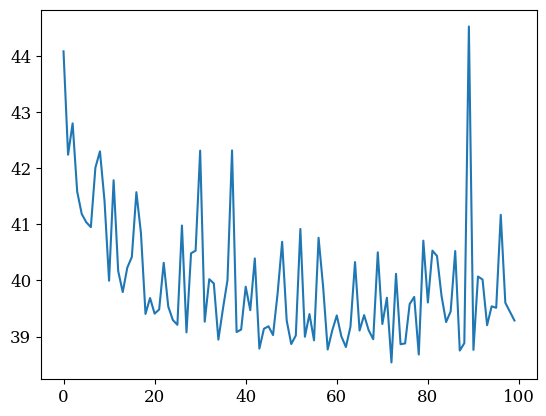

In [ ]:
plt.plot(res_rand_online_co)

In [ ]:
x_online_rand, res_rand_online = kaczmarz_randomized_nn_online(detectors, grid_points_for_reconstruction, b_cs, n_iter=200, isotope_str="cs")
x_online_rand_co, res_rand_online_co = kaczmarz_randomized_nn_online(detectors, grid_points_for_reconstruction, b_co, n_iter=200, isotope_str="co")

plot_reconstruction_and_measurements_side_by_side2(x_online_rand, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                                  grid_points_for_reconstruction, detectors,
                                                  b_cs, "On the go A", "Cs")
plot_2d_reconstruction_on_terrain_map(x_online_rand, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction)
plot_reconstruction_and_measurements_side_by_side2(x_online_rand_co, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                                  grid_points_for_reconstruction, detectors,
                                                  b_co, "On the go A", "Co")

Randomized Kaczmarz NN Online (CS) Iterations:  84%|████████▎ | 167/200 [24:35<04:48,  8.74s/it]

# Condition Number Test to see how it changes with voxel size


--- Processing voxel size = 2.0 ---
Pre-computing A matrix for Cs...

Pre-computing A matrix...
A matrix pre-computation completed in 6.67 seconds. Shape: (1813, 63412)
Condition number (Cs, voxel 2.0): 7.64e+27


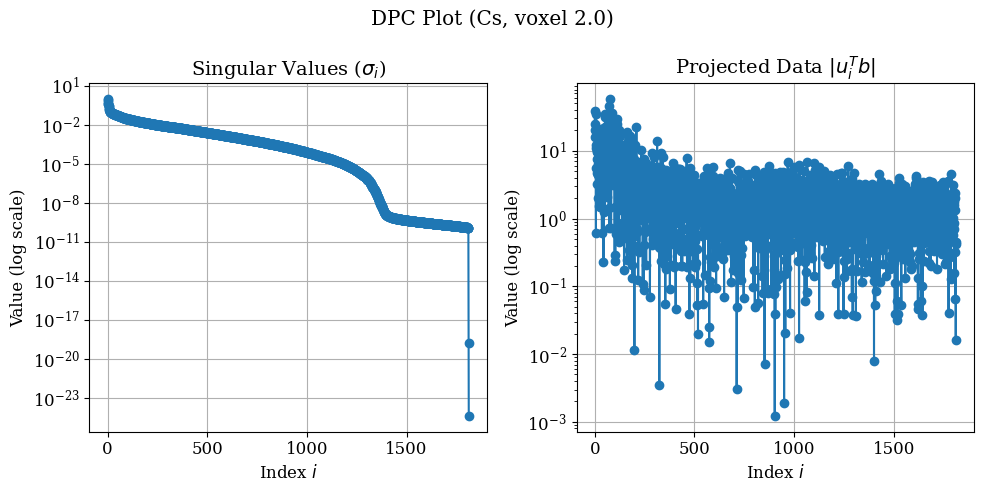

Pre-computing A matrix for Co...

Pre-computing A matrix...
A matrix pre-computation completed in 7.05 seconds. Shape: (1813, 63412)
Condition number (Co, voxel 2.0): 2.35e+27


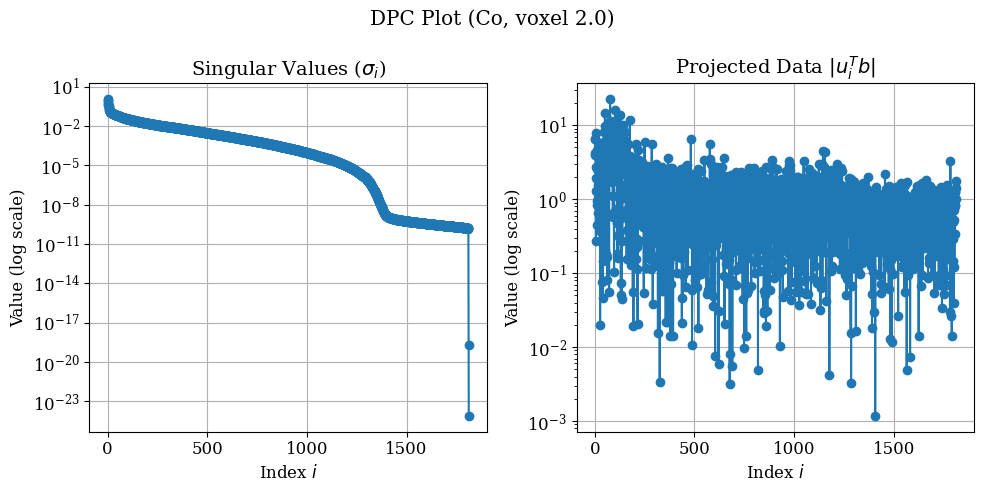


--- Processing voxel size = 3.0 ---
Pre-computing A matrix for Cs...

Pre-computing A matrix...
A matrix pre-computation completed in 2.73 seconds. Shape: (1813, 28288)
Condition number (Cs, voxel 3.0): 3.41e+29


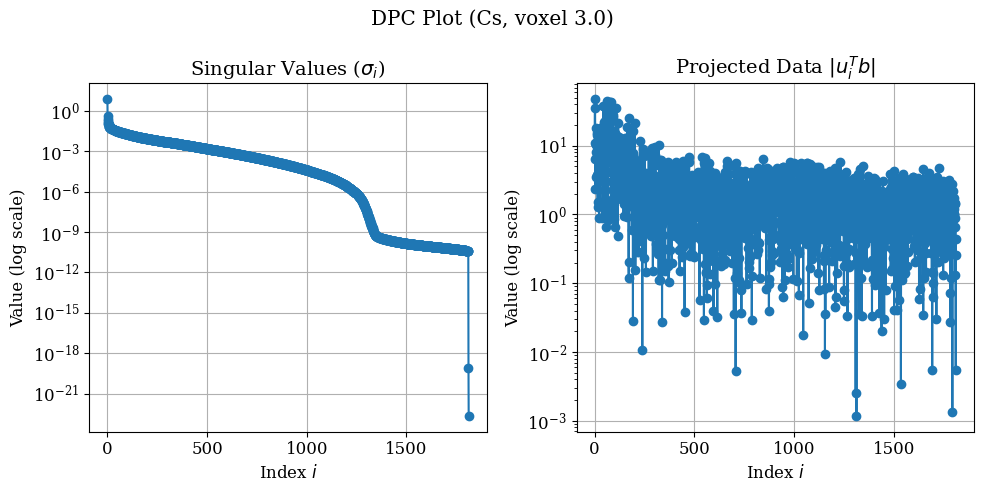

Pre-computing A matrix for Co...

Pre-computing A matrix...
A matrix pre-computation completed in 2.70 seconds. Shape: (1813, 28288)
Condition number (Co, voxel 3.0): 4.02e+27


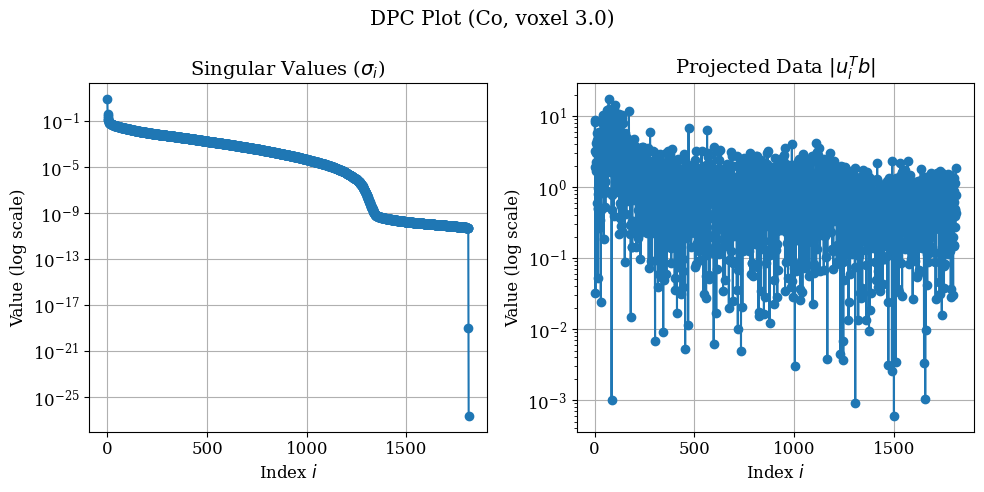


--- Processing voxel size = 4.0 ---
Pre-computing A matrix for Cs...

Pre-computing A matrix...
A matrix pre-computation completed in 1.69 seconds. Shape: (1813, 15936)
Condition number (Cs, voxel 4.0): 1.10e+28


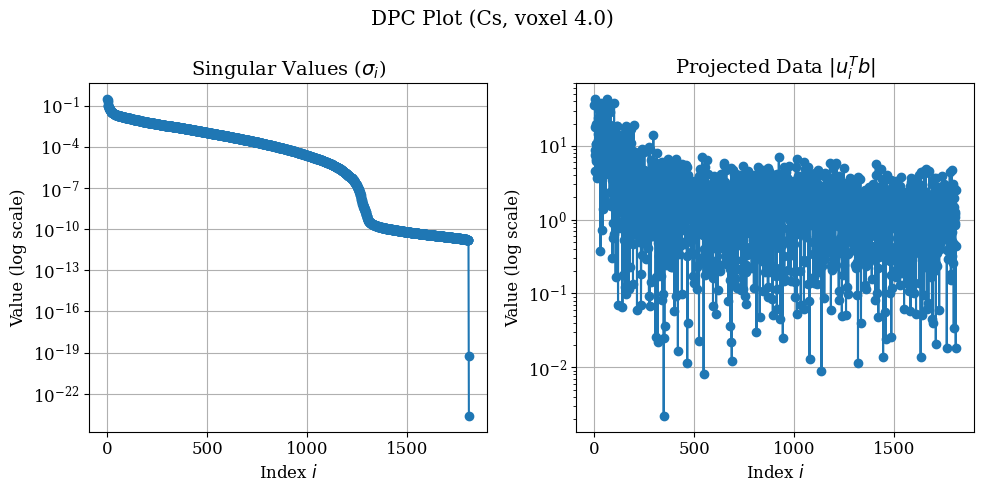

Pre-computing A matrix for Co...

Pre-computing A matrix...
A matrix pre-computation completed in 1.55 seconds. Shape: (1813, 15936)
Condition number (Co, voxel 4.0): 4.36e+27


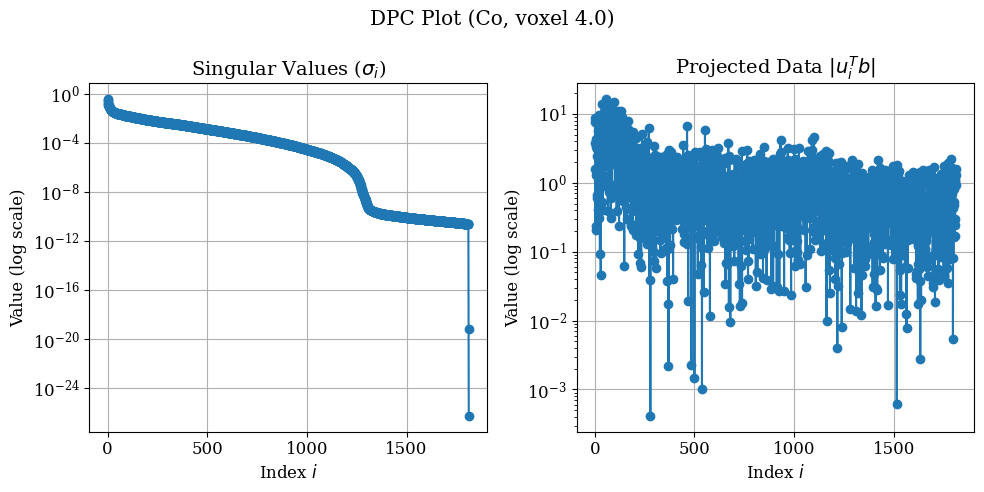


--- Processing voxel size = 5.0 ---
Pre-computing A matrix for Cs...

Pre-computing A matrix...
A matrix pre-computation completed in 1.01 seconds. Shape: (1813, 10241)
Condition number (Cs, voxel 5.0): 9.02e+30


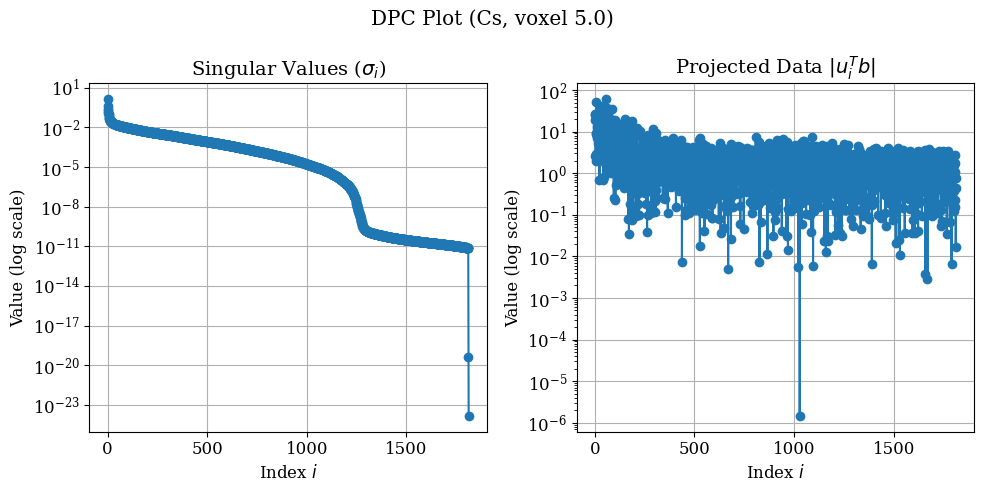

Pre-computing A matrix for Co...

Pre-computing A matrix...
A matrix pre-computation completed in 1.08 seconds. Shape: (1813, 10241)
Condition number (Co, voxel 5.0): 2.11e+29


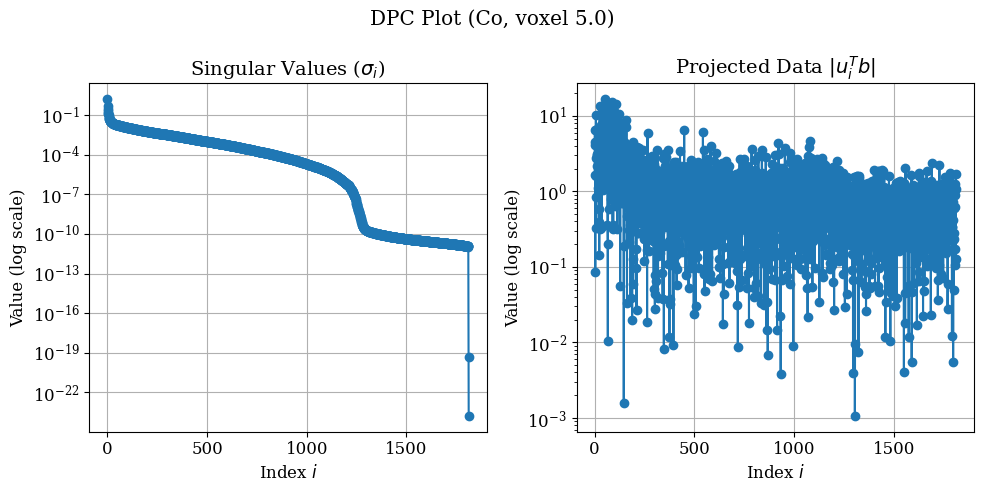


--- Processing voxel size = 10.0 ---
Pre-computing A matrix for Cs...

Pre-computing A matrix...
A matrix pre-computation completed in 0.23 seconds. Shape: (1813, 2613)
Condition number (Cs, voxel 10.0): 3.13e+26


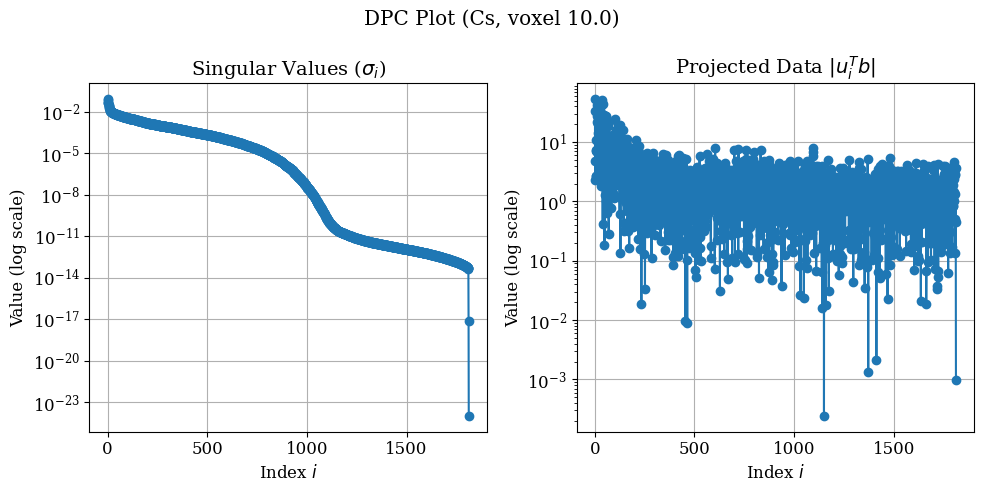

Pre-computing A matrix for Co...

Pre-computing A matrix...
A matrix pre-computation completed in 0.26 seconds. Shape: (1813, 2613)
Condition number (Co, voxel 10.0): 1.75e+26


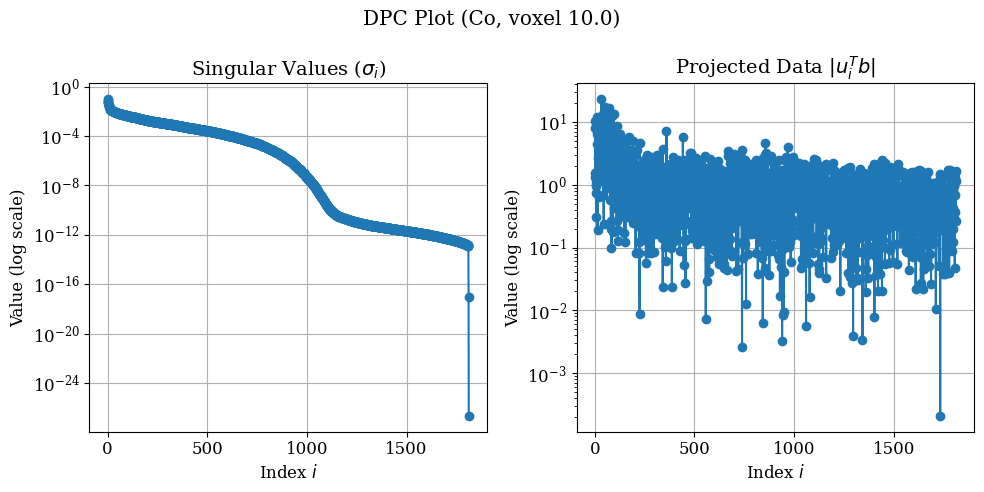

In [10]:
import numpy as np
import matplotlib.pyplot as plt
import pickle

# --- Function for DPC plot ---
def plot_dpc(A, b, title="DPC Plot"):
    """
    Plot the Discrete Picard Condition for system matrix A and data b.
    """
    # Singular Value Decomposition
    U, s, Vt = np.linalg.svd(A, full_matrices=False)

    # Project b onto singular vectors
    beta = U.T @ b

    plt.figure(figsize=(10, 5))

    # --- Subplot 1: Singular Values ---
    ax1 = plt.subplot(1, 2, 1)
    ax1.semilogy(s, 'o-')
    ax1.set_title("Singular Values ($\\sigma_i$)")
    ax1.set_xlabel("Index $i$")
    ax1.set_ylabel("Value (log scale)")
    ax1.grid(True)

    # --- Subplot 2: Projected Data Components ---
    ax2 = plt.subplot(1, 2, 2)
    ax2.semilogy(np.abs(beta), 'o-')
    ax2.set_title("Projected Data $|u_i^T b|$")
    ax2.set_xlabel("Index $i$")
    ax2.set_ylabel("Value (log scale)")
    ax2.grid(True)

    plt.suptitle(title)
    plt.tight_layout()
    plt.show()


# --- Main loop ---
voxel_sizes = [2.0, 3.0, 4.0, 5.0, 10.0]

for vsize in voxel_sizes:
    print(f"\n--- Processing voxel size = {vsize} ---")

    # Create reconstruction grid
    grid_x, grid_y, _ = create_reconstruction_grid_extent(
        grid_min_x, grid_max_x, grid_min_y, grid_max_y, voxel_size=vsize
    )
    xx_mesh, yy_mesh = np.meshgrid(grid_x, grid_y, indexing='ij')
    Z_terrain_interpolated = griddata(
        original_terrain_points[:, :2],
        original_terrain_points[:, 2],
        (xx_mesh, yy_mesh),
        method='nearest'
    )
    grid_points = np.stack(
        [xx_mesh.ravel(), yy_mesh.ravel(), Z_terrain_interpolated.ravel()],
        axis=1
    ).astype(np.float32)

    # --- Cs system matrix ---
    print("Pre-computing A matrix for Cs...")
    _, _, _, emission_prob_cs, mu_L_cs = _kaczmarz_base(detectors, grid_points, b_cs, isotope="cs")
    A_cs = _get_A_matrix(detectors, grid_points, emission_prob_cs, mu_L_cs)

    # Condition number
    cond_cs = np.linalg.cond(A_cs)
    print(f"Condition number (Cs, voxel {vsize}): {cond_cs:.2e}")

    # DPC plot
    plot_dpc(A_cs, b_cs, title=f"DPC Plot (Cs, voxel {vsize})")

    # Delete to save RAM
    del A_cs

    # --- Co system matrix ---
    print("Pre-computing A matrix for Co...")
    _, _, _, emission_prob_co, mu_L_co = _kaczmarz_base(detectors, grid_points, b_co, isotope="co")
    A_co = _get_A_matrix(detectors, grid_points, emission_prob_co, mu_L_co)

    # Condition number
    cond_co = np.linalg.cond(A_co)
    print(f"Condition number (Co, voxel {vsize}): {cond_co:.2e}")

    # DPC plot
    plot_dpc(A_co, b_co, title=f"DPC Plot (Co, voxel {vsize})")

    # Delete to save RAM
    del A_co


In [ ]:
A_matrix_cs

# Final try with 400 iterations


--- Running and Plotting Kaczmarz Algorithms for Cesium (Cs) ---

--- Running Kaczmarz Cyclic NN (Cs) ---


Cyclic Kaczmarz NN (CS) Iterations: 100%|██████████| 400/400 [03:17<00:00,  2.02it/s]


Final Residual (Cyclic NN Cs): 127.0071

Creating 2D terrain map with reconstruction overlay for Kaczmarz Cyclic NN Reconstruction (Cs) (Threshold: 0.0%) ...


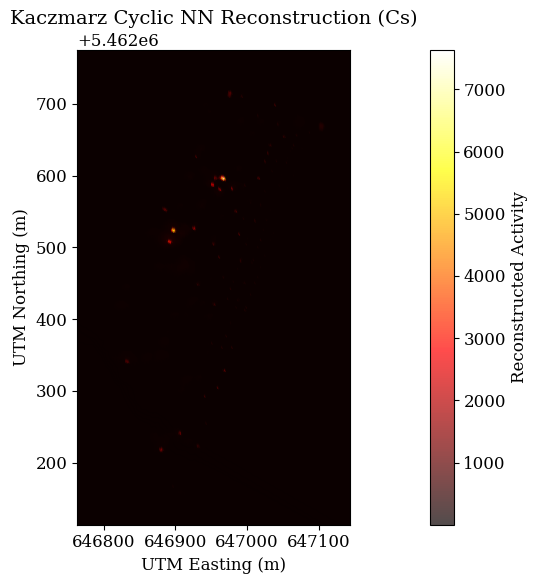


Creating side-by-side plot for Cyclic NN (cs) ...


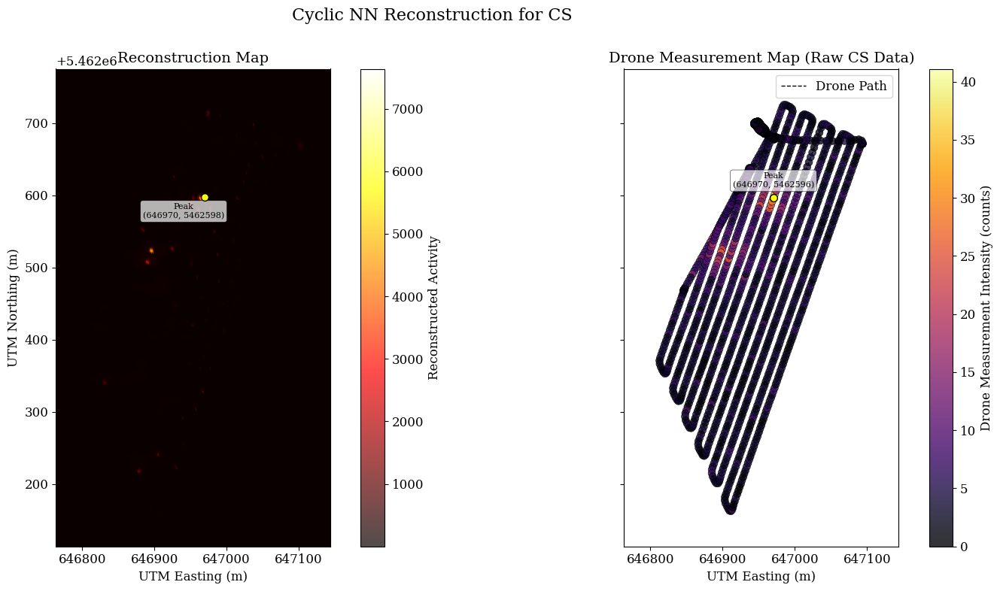


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646969.50, 5462597.50)
Measured Peak Location (UTM): (646970.38, 5462596.50)
Distance between peaks: 1.33 meters

--- Running Kaczmarz Upsweep NN (Cs) ---


Upsweep Kaczmarz NN (CS) Iterations: 100%|██████████| 400/400 [06:00<00:00,  1.11it/s]


Final Residual (Upsweep NN Cs): 96.6606

Creating 2D terrain map with reconstruction overlay for Kaczmarz Symmetric NN Reconstruction (Cs) (Threshold: 0.0%) ...


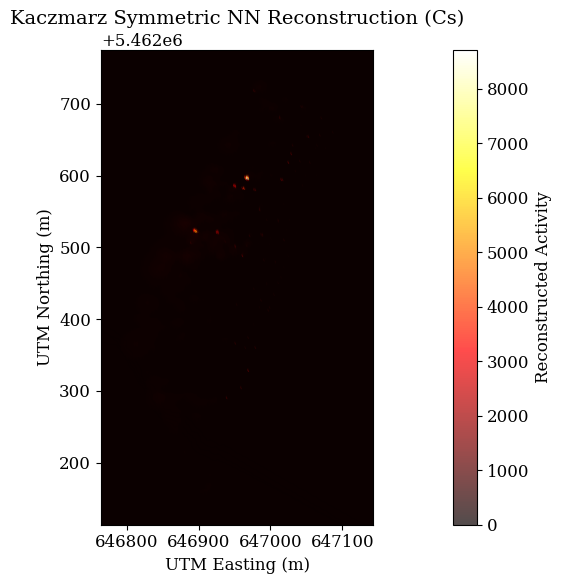


Creating side-by-side plot for Symmetric NN (cs) ...


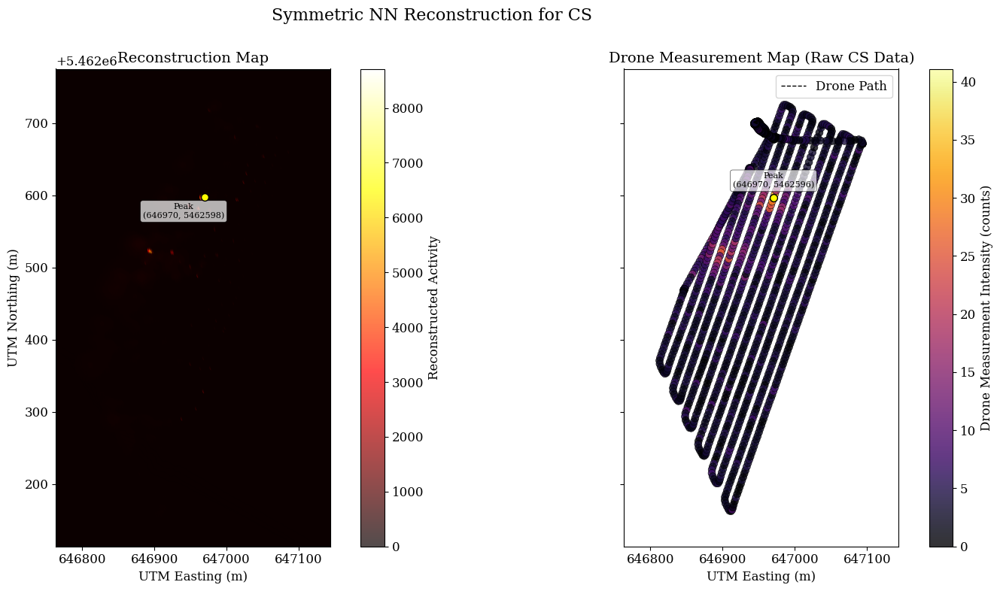


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646969.50, 5462597.50)
Measured Peak Location (UTM): (646970.38, 5462596.50)
Distance between peaks: 1.33 meters

--- Running Kaczmarz Randomized NN (Cs) ---


Randomized Kaczmarz NN (CS) Iterations: 100%|██████████| 400/400 [03:22<00:00,  1.97it/s]


Final Residual (Randomized NN Cs): 93.6854

Creating 2D terrain map with reconstruction overlay for Kaczmarz Randomized NN Reconstruction (Cs) (Threshold: 0.0%) ...


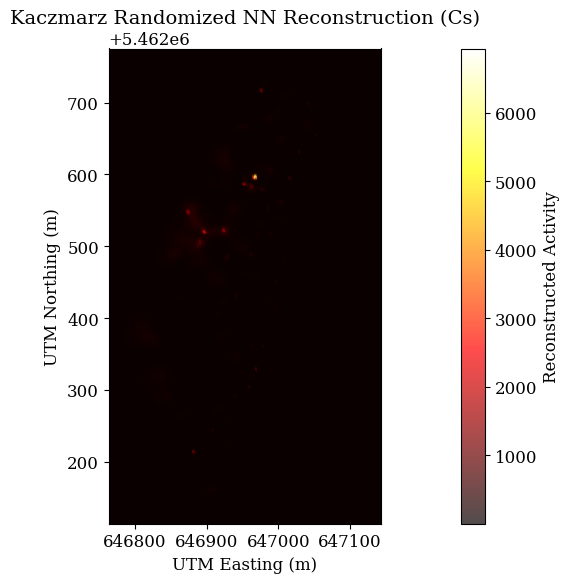


Creating side-by-side plot for Randomized NN (cs) ...


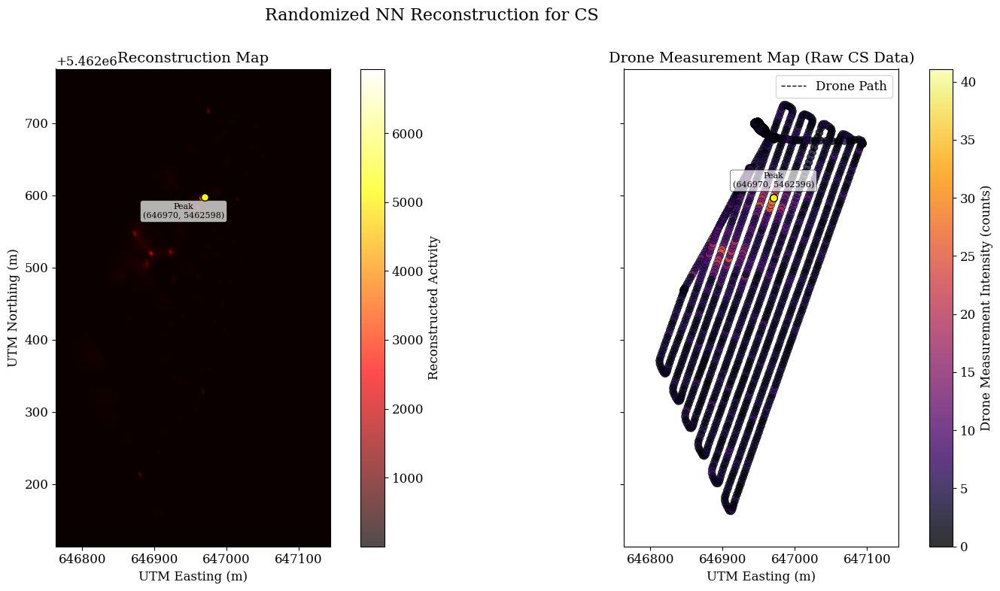


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646969.50, 5462597.50)
Measured Peak Location (UTM): (646970.38, 5462596.50)
Distance between peaks: 1.33 meters

Plotting Residuals Over Iterations (Cesium - Cs)...


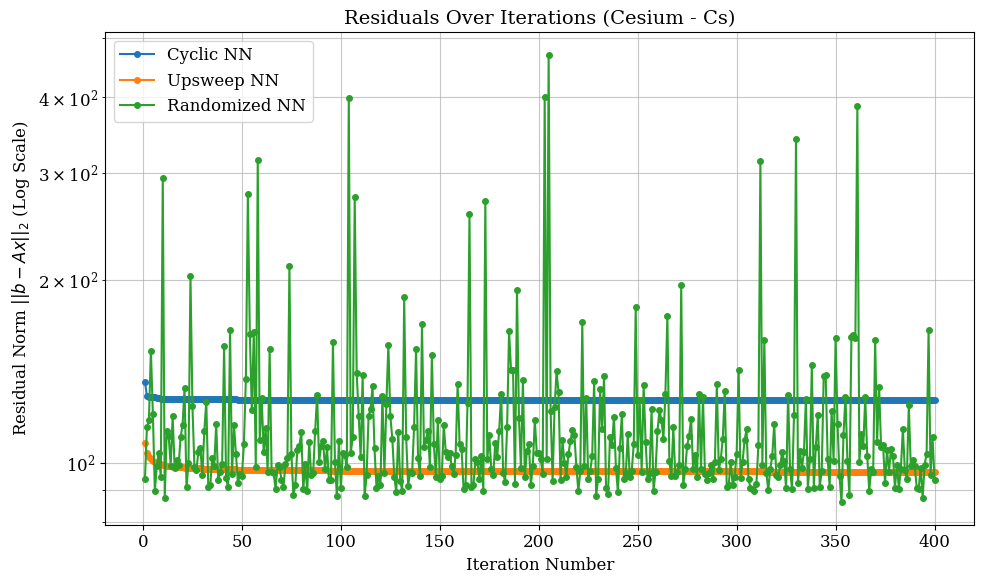


--- Running and Plotting Kaczmarz Algorithms for Cobalt (Co) ---

--- Running Kaczmarz Cyclic NN (Co) ---


Cyclic Kaczmarz NN (CO) Iterations: 100%|██████████| 400/400 [03:21<00:00,  1.98it/s]


Final Residual (Cyclic NN Co): 50.5455

Creating 2D terrain map with reconstruction overlay for Kaczmarz Cyclic NN Reconstruction (Co) (Threshold: 0.0%) ...


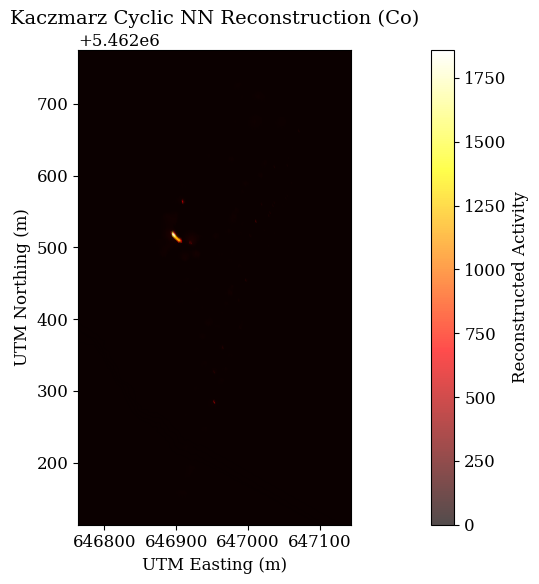


Creating side-by-side plot for Cyclic NN (co) ...


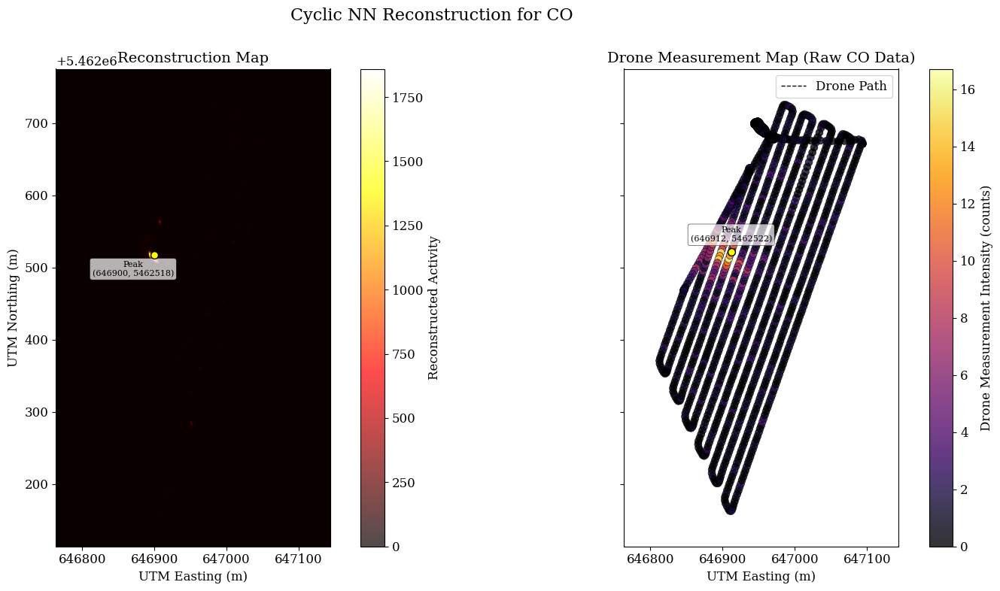


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646899.50, 5462517.50)
Measured Peak Location (UTM): (646911.75, 5462521.50)
Distance between peaks: 12.89 meters

--- Running Kaczmarz Upsweep NN (Co) ---


Upsweep Kaczmarz NN (CO) Iterations: 100%|██████████| 400/400 [06:09<00:00,  1.08it/s]


Final Residual (Upsweep NN Co): 48.9142

Creating 2D terrain map with reconstruction overlay for Kaczmarz Symmetric NN Reconstruction (Co) (Threshold: 0.0%) ...


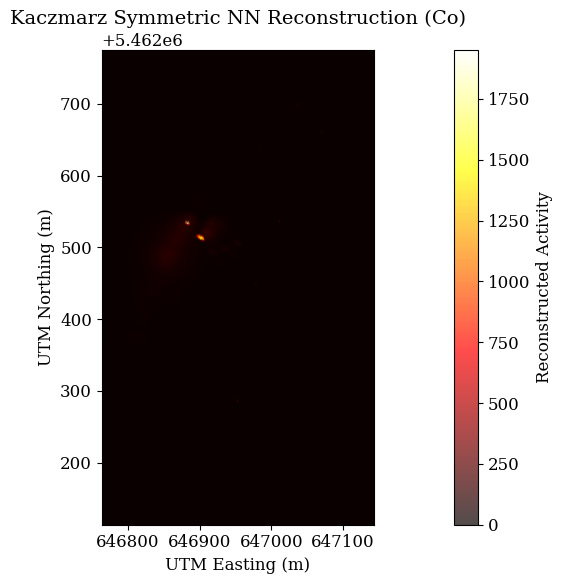


Creating side-by-side plot for Symmetric NN (co) ...


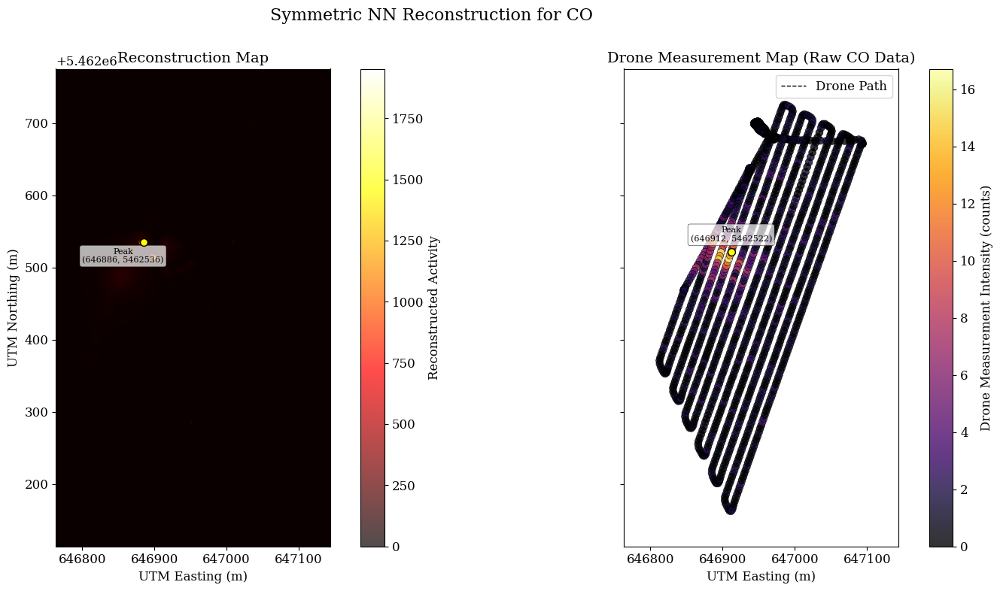


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646885.50, 5462535.50)
Measured Peak Location (UTM): (646911.75, 5462521.50)
Distance between peaks: 29.75 meters

--- Running Kaczmarz Randomized NN (Co) ---


Randomized Kaczmarz NN (CO) Iterations: 100%|██████████| 400/400 [03:23<00:00,  1.97it/s]


Final Residual (Randomized NN Co): 51.6557

Creating 2D terrain map with reconstruction overlay for Kaczmarz Randomized NN Reconstruction (Co) (Threshold: 0.0%) ...


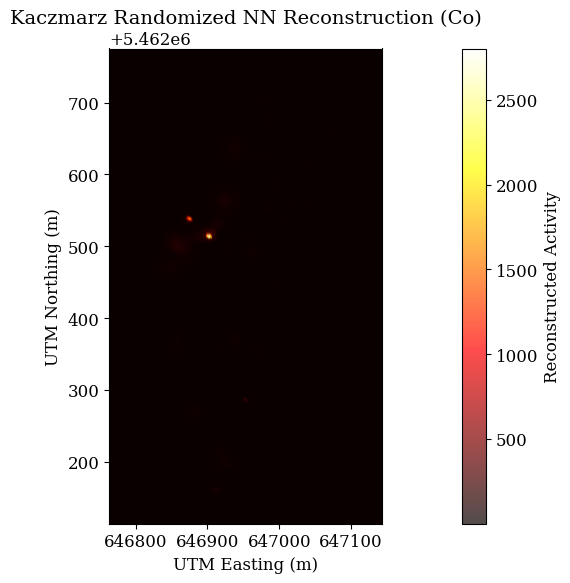


Creating side-by-side plot for Randomized NN (co) ...


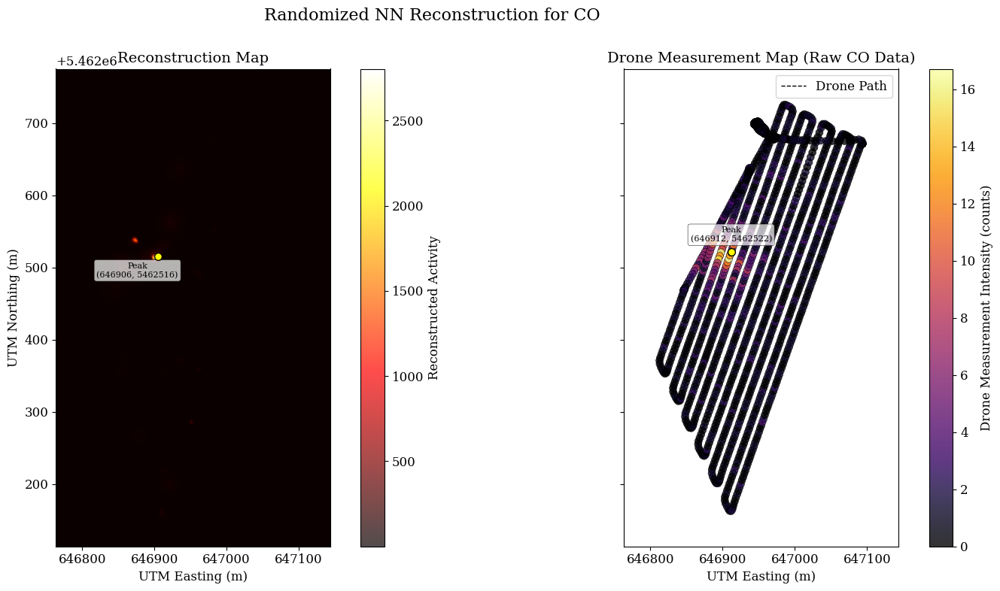


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646905.50, 5462515.50)
Measured Peak Location (UTM): (646911.75, 5462521.50)
Distance between peaks: 8.66 meters

Plotting Residuals Over Iterations (Cobalt - Co)...


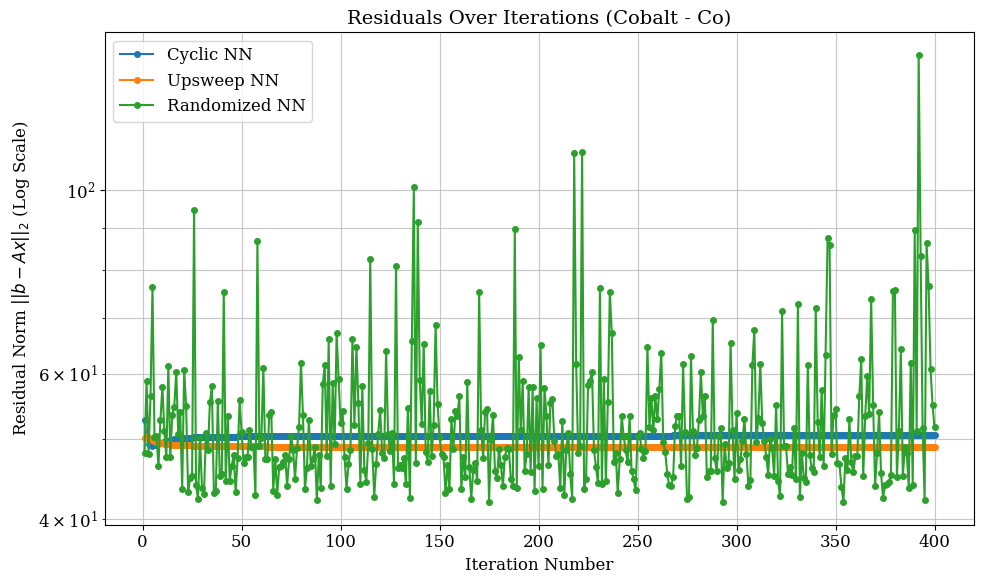


--- All Kaczmarz algorithms execution and plotting complete for both Cs and Co. ---


In [35]:
kaczmarz_n_iter = 400

# --- Run and Plot for Cesium (Cs) ---
print("\n--- Running and Plotting Kaczmarz Algorithms for Cesium (Cs) ---")
cs_residuals_data = {}

# --- Non-Negative (NN) Algorithms (kept) ---

# 1. Kaczmarz Cyclic Non-Negative (NN) (Cs)
print("\n--- Running Kaczmarz Cyclic NN (Cs) ---")
x_recon_cyclic_nn_cs, residuals_cyclic_nn_cs = kaczmarz_cyclic_nn(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, n_iter=kaczmarz_n_iter, isotope_str="cs")
cs_residuals_data['Cyclic NN'] = residuals_cyclic_nn_cs
print(f"Final Residual (Cyclic NN Cs): {residuals_cyclic_nn_cs[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_cyclic_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Cyclic NN Reconstruction (Cs)")

plot_reconstruction_and_measurements_side_by_side2(
    x_recon_cyclic_nn_cs,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    "Cyclic NN",
    "cs"
)


# 2. Kaczmarz Upsweep Non-Negative (NN) (Cs)
print("\n--- Running Kaczmarz Upsweep NN (Cs) ---")
x_recon_upsweep_nn_cs, residuals_upsweep_nn_cs = kaczmarz_upsweep_nn(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, n_iter=kaczmarz_n_iter, isotope_str="cs")
cs_residuals_data['Upsweep NN'] = residuals_upsweep_nn_cs
print(f"Final Residual (Upsweep NN Cs): {residuals_upsweep_nn_cs[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_upsweep_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Symmetric NN Reconstruction (Cs)")

plot_reconstruction_and_measurements_side_by_side2(
    x_recon_upsweep_nn_cs,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    "Symmetric NN",
    "cs"
)


# 3. Kaczmarz Randomized Non-Negative (NN) (Cs)
print("\n--- Running Kaczmarz Randomized NN (Cs) ---")
x_recon_randomized_nn_cs, residuals_randomized_nn_cs = kaczmarz_randomized_nn(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, n_iter=kaczmarz_n_iter, isotope_str="cs")
cs_residuals_data['Randomized NN'] = residuals_randomized_nn_cs
print(f"Final Residual (Randomized NN Cs): {residuals_randomized_nn_cs[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_randomized_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Randomized NN Reconstruction (Cs)")
plot_reconstruction_and_measurements_side_by_side2(
    x_recon_randomized_nn_cs,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_cs,
    "Randomized NN",
    "cs"
)




# Plot Residuals for Cs
plot_residuals_over_iterations(cs_residuals_data, kaczmarz_n_iter, title="Residuals Over Iterations (Cesium - Cs)")


# --- Run and Plot for Cobalt (Co) ---
print("\n--- Running and Plotting Kaczmarz Algorithms for Cobalt (Co) ---")
co_residuals_data = {}

# --- Non-Negative (NN) Algorithms (kept) ---

# 1. Kaczmarz Cyclic Non-Negative (NN) (Co)
print("\n--- Running Kaczmarz Cyclic NN (Co) ---")
x_recon_cyclic_nn_co, residuals_cyclic_nn_co = kaczmarz_cyclic_nn(detectors, grid_points_for_reconstruction, b_co, A_matrix_co, n_iter=kaczmarz_n_iter, isotope_str="co")
co_residuals_data['Cyclic NN'] = residuals_cyclic_nn_co
print(f"Final Residual (Cyclic NN Co): {residuals_cyclic_nn_co[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_cyclic_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Cyclic NN Reconstruction (Co)")

plot_reconstruction_and_measurements_side_by_side2(
    x_recon_cyclic_nn_co,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    "Cyclic NN",
    "co"
)


# 2. Kaczmarz Upsweep Non-Negative (NN) (Co)
print("\n--- Running Kaczmarz Upsweep NN (Co) ---")
x_recon_upsweep_nn_co, residuals_upsweep_nn_co = kaczmarz_upsweep_nn(detectors, grid_points_for_reconstruction, b_co, A_matrix_co, n_iter=kaczmarz_n_iter, isotope_str="co")
co_residuals_data['Upsweep NN'] = residuals_upsweep_nn_co
print(f"Final Residual (Upsweep NN Co): {residuals_upsweep_nn_co[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_upsweep_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Symmetric NN Reconstruction (Co)")

plot_reconstruction_and_measurements_side_by_side2(
    x_recon_upsweep_nn_co,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    "Symmetric NN",
    "co"
)


# 3. Kaczmarz Randomized Non-Negative (NN) (Co)
print("\n--- Running Kaczmarz Randomized NN (Co) ---")
x_recon_randomized_nn_co, residuals_randomized_nn_co = kaczmarz_randomized_nn(detectors, grid_points_for_reconstruction, b_co, A_matrix_co, n_iter=kaczmarz_n_iter, isotope_str="co")
co_residuals_data['Randomized NN'] = residuals_randomized_nn_co
print(f"Final Residual (Randomized NN Co): {residuals_randomized_nn_co[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_randomized_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                    grid_points_for_reconstruction, title="Kaczmarz Randomized NN Reconstruction (Co)")

plot_reconstruction_and_measurements_side_by_side2(
    x_recon_randomized_nn_co,
    xx_mesh,
    yy_mesh,
    Z_terrain_interpolated,
    grid_points_for_reconstruction,
    detectors,
    b_co,
    "Randomized NN",
    "co"
)




# Plot Residuals for Co
plot_residuals_over_iterations(co_residuals_data, kaczmarz_n_iter, title="Residuals Over Iterations (Cobalt - Co)")


print("\n--- All Kaczmarz algorithms execution and plotting complete for both Cs and Co. ---")

# Other

In [19]:
def kaczmarz_symmetric(detectors, grid_points, b, A_matrix, n_iter=100, omega = 1.0, isotope_str="cs"):
    x, m, n, _, _ = _kaczmarz_base(detectors, grid_points, b, isotope=isotope_str)
    residuals_per_iteration = []
    for it in tqdm(range(n_iter), desc=f"Upsweep Kaczmarz NN ({isotope_str.upper()}) Iterations"):
        for i in range(m): # Forward sweep
            A_i = A_matrix[i, :]
            A_i_norm_sq = np.sum(A_i**2)
            if A_i_norm_sq == 0: continue
            residual = b[i] - A_i @ x
            x += omega * (residual / A_i_norm_sq) * A_i
            x = np.maximum(0, x)
        for i in range(m - 1, -1, -1): # Backward sweep
            A_i = A_matrix[i, :]
            A_i_norm_sq = np.sum(A_i**2)
            if A_i_norm_sq == 0: continue
            residual = b[i] - A_i @ x
            x += omega * (residual / A_i_norm_sq) * A_i
            x = np.maximum(0, x)
        residuals_per_iteration.append(calculate_system_residual(x, b, A_matrix))
    return x, np.array(residuals_per_iteration)

Upsweep Kaczmarz NN (CO) Iterations: 100%|██████████| 100/100 [01:50<00:00,  1.11s/it]



Creating side-by-side plot for Symmetric Kaczmarz NN (Cs) ...


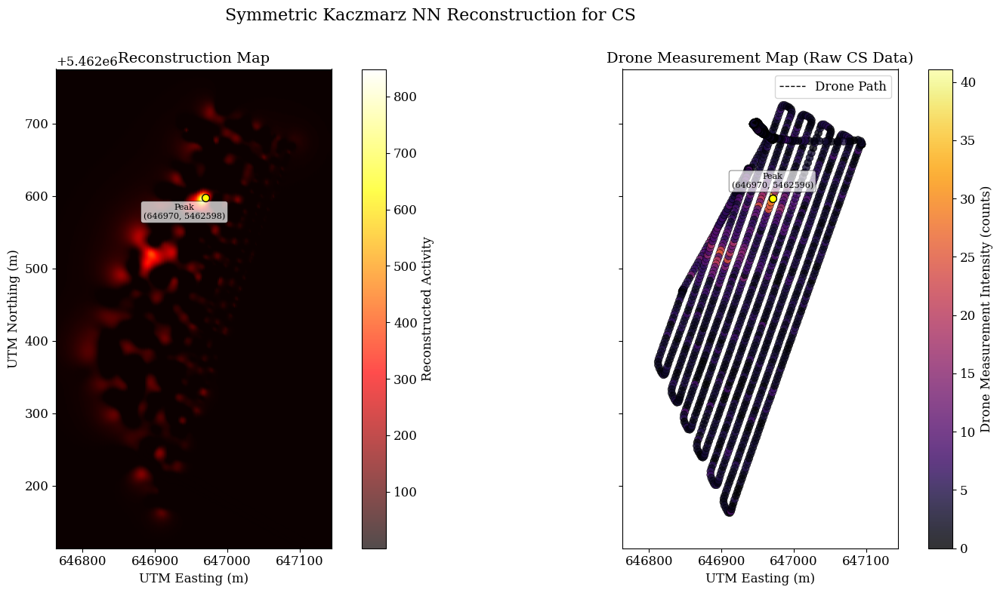


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646969.50, 5462597.50)
Measured Peak Location (UTM): (646970.38, 5462596.50)
Distance between peaks: 1.33 meters

Creating side-by-side plot for Symmetric Kaczmarz NN (Co) ...


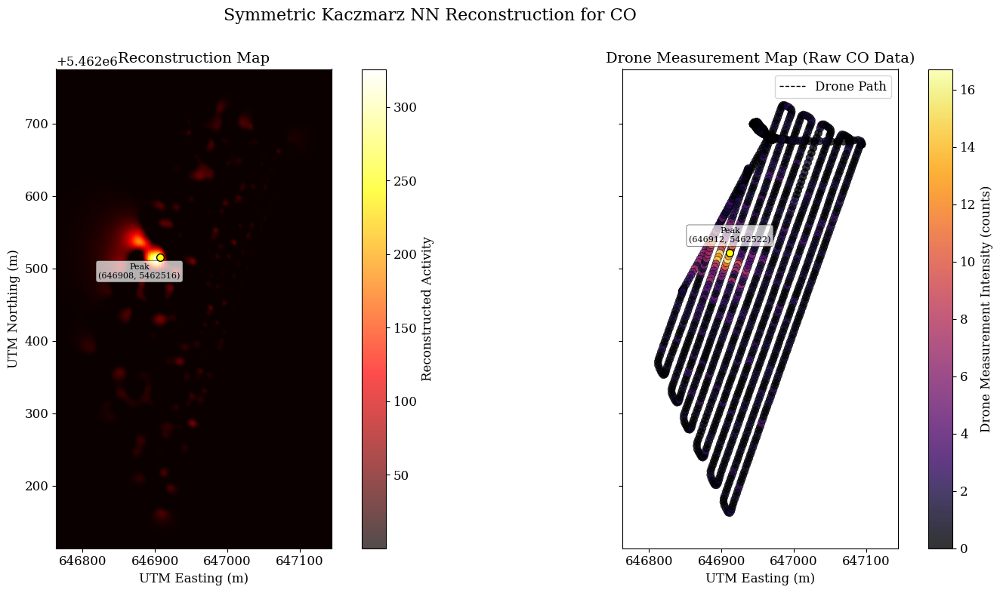


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646907.50, 5462515.50)
Measured Peak Location (UTM): (646911.75, 5462521.50)
Distance between peaks: 7.35 meters


In [22]:
x_sym_cs, r_sym_cs = kaczmarz_symmetric(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, n_iter=100, omega = 0.01, isotope_str = 'cs')
x_sym_co, r_sym_co = kaczmarz_symmetric(detectors, grid_points_for_reconstruction, b_co, A_matrix_co, n_iter=100, omega = 0.01, isotope_str = 'co')

plot_reconstruction_and_measurements_side_by_side2(x_sym_cs, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction, detectors, b_cs, "Symmetric Kaczmarz NN", "Cs")
plot_reconstruction_and_measurements_side_by_side2(x_sym_co, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction, detectors, b_co, "Symmetric Kaczmarz NN", "Co")


Creating 2D terrain map with reconstruction overlay for Symmetric Kaczmarz Optimal (Co) (Threshold: 0.0%) ...


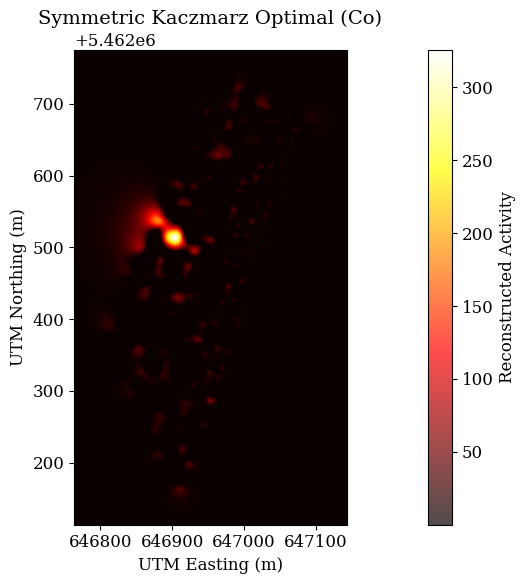

In [27]:

plot_2d_reconstruction_on_terrain_map(x_sym_co, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction, title="Symmetric Kaczmarz Optimal (Co)")


Creating side-by-side plot for Symmetric Kaczmarz NN (Co) ...


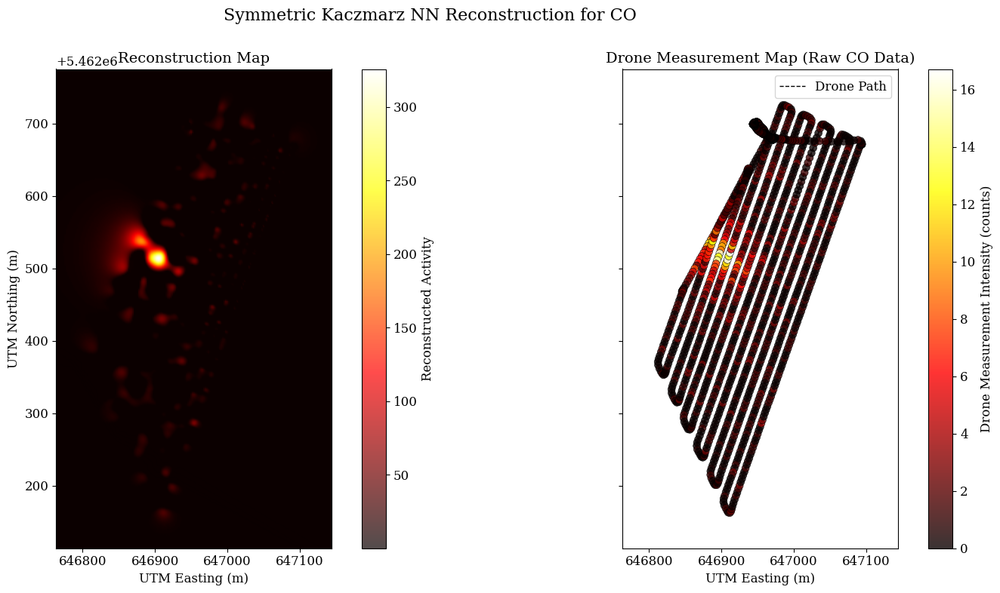

In [28]:
plot_reconstruction_and_measurements_side_by_side(x_sym_co, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction, detectors, b_co, "Symmetric Kaczmarz NN", "Co")

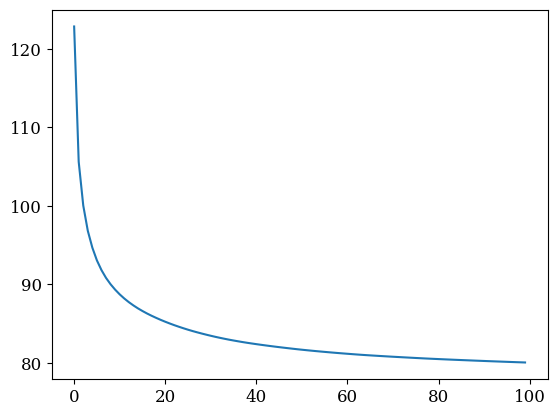

In [25]:
plt.plot(r_sym_cs)

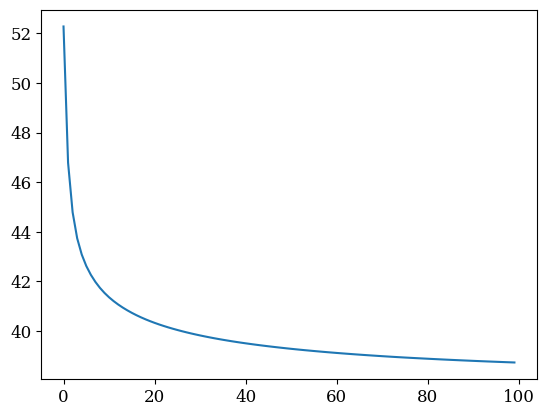

In [26]:
plt.plot(r_sym_co)